In [1]:
# for data input and output:
import numpy as np
import os
import glob
import imageio
import time
from PIL import Image


# for deep learning: 
os.environ["KERAS_BACKEND"] = "tensorflow"
import keras
from keras.models import Model
from keras.layers import Input, Dense, Conv2D, Dropout
from keras.layers import BatchNormalization, Flatten
from keras.layers import Activation
from keras.layers import Conv2DTranspose, LeakyReLU 
from keras.optimizers import Adam

# for plotting: 
from matplotlib import pyplot as plt
import matplotlib.gridspec as gridspec
%matplotlib inline

Using TensorFlow backend.


### Loading Images

In [2]:
#save the new files to npy
#Loading Images in again 
armor = glob.glob('mhxx_800px2/*.*g')
print("Number of images: ", len(armor))

Number of images:  19487


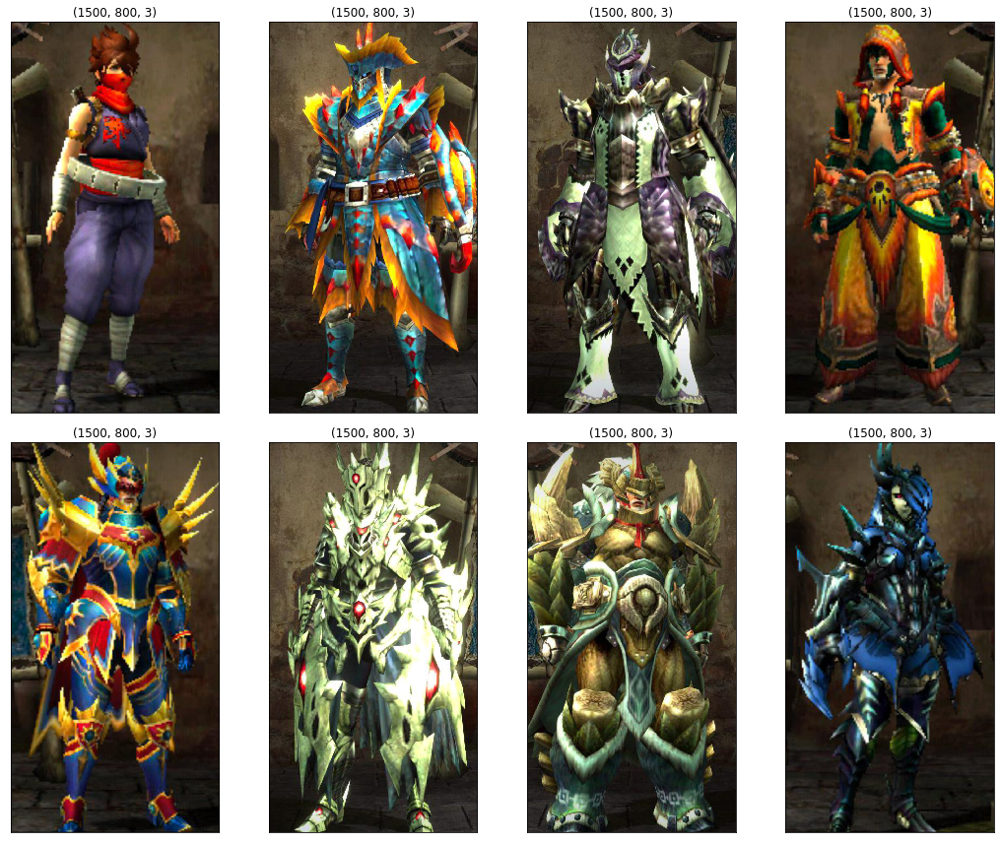

In [3]:
#using High res photo samples since dcgan isn't as picky as the styles GAN 
plt.figure(figsize = (15,12))
for i in range(8):
    img = plt.imread(armor[i+2000], 0)
    plt.subplot(2,4, i + 1)
    plt.imshow(img)
    plt.title(img.shape)
    plt.xticks([])
    plt.yticks([])
plt.tight_layout()
plt.show()

### Batch Size, Number of training sets, image shape, files locations

In [4]:
# Shape of noise vector to be input to the Generator
noise_shape = (1,1,100)
# Number of steps for training. num_epochs = num_steps*batch_size/data_size
num_steps = 10000
# batch size for training.
batch_size = 64
# Location to save images and logs 
img_save_dir = "mhxx_armor/"
# Image size to reshape to
image_shape = (64,64,3)
# Location of data directory
data_dir = "mhxx_800px2/*.*g"
# set up log and save directories
log_dir = img_save_dir
save_model_dir = img_save_dir

### Building the discriminator 

In [6]:
def build_discriminator(image_shape= image_shape):
    dropout_prob = 0.4
    kernel_init = 'glorot_uniform'
    dis_input = Input(shape = image_shape)
    
    # Conv layer 1:
    discriminator = Conv2D(filters = 64, kernel_size = (4,4), strides = (2,2), padding = "same", 
                           data_format = "channels_last", kernel_initializer = kernel_init)(dis_input)
    discriminator = LeakyReLU(0.2)(discriminator)
    # Conv layer 2:
    discriminator = Conv2D(filters = 128, kernel_size = (4,4), strides = (2,2), padding = "same", 
                           data_format = "channels_last", kernel_initializer = kernel_init)(discriminator)
    discriminator = BatchNormalization(momentum = 0.5)(discriminator)
    discriminator = LeakyReLU(0.2)(discriminator)
    # Conv layer 3:   
    discriminator = Conv2D(filters = 256, kernel_size = (4,4), strides = (2,2), padding = "same", 
                           data_format = "channels_last", kernel_initializer = kernel_init)(discriminator)
    discriminator = BatchNormalization(momentum = 0.5)(discriminator)
    discriminator = LeakyReLU(0.2)(discriminator)
    # Conv layer 4:
    discriminator = Conv2D(filters = 512, kernel_size = (4,4), strides = (2,2), padding = "same", 
                           data_format = "channels_last", kernel_initializer = kernel_init)(discriminator)
    discriminator = BatchNormalization(momentum = 0.5)(discriminator)
    discriminator = LeakyReLU(0.2)(discriminator)
    # Flatten
    discriminator = Flatten()(discriminator)
    # Dense Layer
    discriminator = Dense(1)(discriminator)
    # Sigmoid Activation
    discriminator = Activation('sigmoid')(discriminator)
    
    # Model definition
    discriminator_model = Model(inputs = dis_input, outputs = discriminator)
    
    return discriminator_model

In [7]:
discriminator = build_discriminator(image_shape)
discriminator.summary()

Instructions for updating:
Colocations handled automatically by placer.
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 64, 64, 3)         0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 32, 32, 64)        3136      
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 16, 16, 128)       131200    
_________________________________________________________________
batch_normalization_1 (Batch (None, 16, 16, 128)       512       
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 16, 16, 128)       0         
_________________________________________________________________
conv

In [8]:
discriminator.compile(loss='binary_crossentropy', 
                      optimizer=Adam(lr=0.0002, beta_1=0.5), 
                      metrics=['accuracy'])

### Building generator

In [10]:
def gen_noise(batch_size, noise_shape):
    ''' Generates a numpy vector sampled from normal distribution of shape (batch_size,noise_shape)
    Input:
        batch_size : size of batch
        noise_shape: shape of noise vector, normally kept as 100 
    Output:a numpy vector sampled from normal distribution of shape (batch_size,noise_shape)     
    '''
    return np.random.normal(0, 1, size=(batch_size,)+noise_shape)

In [11]:
def build_generator(noise_shape):
    ''' This function takes as input shape of the noise vector and creates the Keras generator    architecture.
    '''
    kernel_init = 'glorot_uniform'    
    gen_input = Input(shape = noise_shape) 
    
    # Transpose 2D conv layer 1. 
    generator = Conv2DTranspose(filters = 512, kernel_size = (4,4), strides = (1,1), 
                                padding = "valid", data_format = "channels_last", kernel_initializer = kernel_init)(gen_input)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    # Transpose 2D conv layer 2.
    generator = Conv2DTranspose(filters = 256, kernel_size = (4,4), strides = (2,2), 
                                padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    # Transpose 2D conv layer 3.
    generator = Conv2DTranspose(filters = 128, kernel_size = (4,4), strides = (2,2), 
                                padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    # Transpose 2D conv layer 4.
    generator = Conv2DTranspose(filters = 64, kernel_size = (4,4), strides = (2,2), 
                                padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    # conv 2D layer 1.
    generator = Conv2D(filters = 64, kernel_size = (3,3), strides = (1,1), padding = "same", 
                       data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    # Final Transpose 2D conv layer 5 to generate final image. Filter size 3 for 3 image channel
    generator = Conv2DTranspose(filters = 3, kernel_size = (4,4), strides = (2,2), padding = "same", 
                                data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    
    # Tanh activation to get final normalized image
    generator = Activation('tanh')(generator)
    
    # Model definition    
    generator_model = Model(inputs = gen_input, outputs = generator)
    
    return generator_model

In [12]:
generator = build_generator(noise_shape)
generator.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, 1, 1, 100)         0         
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 4, 4, 512)         819712    
_________________________________________________________________
batch_normalization_4 (Batch (None, 4, 4, 512)         2048      
_________________________________________________________________
leaky_re_lu_5 (LeakyReLU)    (None, 4, 4, 512)         0         
_________________________________________________________________
conv2d_transpose_2 (Conv2DTr (None, 8, 8, 256)         2097408   
_________________________________________________________________
batch_normalization_5 (Batch (None, 8, 8, 256)         1024      
_________________________________________________________________
leaky_re_lu_6 (LeakyReLU)    (None, 8, 8, 256)         0         
__________

In [13]:
generator.compile(loss='binary_crossentropy', optimizer=Adam(lr=0.00015, beta_1=0.5), metrics=['accuracy'])

### Adverserial Network

In [15]:
discriminator.trainable = False
gen_inp = Input(shape=noise_shape)


GAN_inp = generator(gen_inp)
GAN_opt = discriminator(GAN_inp)

adversarial_model = Model(inputs = gen_inp, outputs = GAN_opt)

adversarial_model.compile(loss='binary_crossentropy', 
                          optimizer=Adam(lr=0.00015, beta_1=0.5), 
                          metrics=['accuracy'])


### Training Function, Saving image Function, Normalization and sampling

In [17]:
#Saving the images in our computer to make a gif later 
def save_img_batch(img_batch,img_save_dir):
    '''Takes as input a image batch and a img_save_dir and saves 64 images from the batch in a 8x8 grid in the img_save_dir
    '''
    plt.figure(figsize=(16,16))
    gs1 = gridspec.GridSpec(8, 8)
    gs1.update(wspace=0, hspace=0)
    rand_indices = np.random.choice(img_batch.shape[0],64,replace=False)
    for i in range(64):
        ax1 = plt.subplot(gs1[i])
        ax1.set_aspect('equal')
        rand_index = rand_indices[i]
        image = img_batch[rand_index, :,:,:]
        fig = plt.imshow(denorm_img(image))
        plt.axis('off')
        fig.axes.get_xaxis().set_visible(False)
        fig.axes.get_yaxis().set_visible(False)
    plt.tight_layout()
    plt.savefig(img_save_dir,bbox_inches='tight',pad_inches=0)
    plt.show() 

In [18]:
# A function to normalize image pixels.
def norm_img(img):
    '''A function to Normalize Images.
    Input:
        img : Original image as numpy array.
    Output: Normailized Image as numpy array
    '''
    img = (img / 127.5) - 1
    return img

def denorm_img(img):
    '''A function to Denormailze, i.e. recreate image from normalized image
    Input:
        img : Normalized image as numpy array.
    Output: Original Image as numpy array
    '''
    img = (img + 1) * 127.5
    return img.astype(np.uint8) 

def sample_from_dataset(batch_size, image_shape, data_dir=None):
    '''Create a batch of image samples by sampling random images from a data directory.
    Resizes the image using image_shape and normalize the images.
    Input:
        batch_size : Sample size required
        image_size : Size that Image should be resized to
        data_dir : Path of directory where training images are placed.

    Output:
        sample : batch of processed images 
    '''
    sample_dim = (batch_size,) + image_shape
    sample = np.empty(sample_dim, dtype=np.float32)
    all_data_dirlist = list(glob.glob(data_dir))
    sample_imgs_paths = np.random.choice(all_data_dirlist,batch_size)
    for index,img_filename in enumerate(sample_imgs_paths):
        image = Image.open(img_filename)
        image = image.resize(image_shape[:-1])
        image = image.convert('RGB') 
        image = np.asarray(image)
        image = norm_img(image)
        sample[index,...] = image
    return sample

In [19]:
def train(num_steps=num_steps, batch=batch_size):
    
    # Use a fixed noise vector to see how the GAN Images transition through time on a fixed noise. 
    fixed_noise = gen_noise(16,noise_shape)
    
    
    # To keep Track of losses
    avg_disc_fake_loss = []
    avg_disc_real_loss = []
    avg_GAN_loss = []
    
    # We will run for num_steps iterations
    for step in range(num_steps): 
        tot_step = step
        print("Begin step: ", tot_step)
        # to keep track of time per step
        step_begin_time = time.time() 

        # sample batch of normalized real images from dataset: 
        real_imgs_X = sample_from_dataset(batch_size, image_shape, data_dir=data_dir)
        
        # Genearate noise to send as input to the generator
        noise = gen_noise(batch_size,noise_shape)

        # Use generator to create(predict) images generates fake images:
        fake_imgs_X = generator.predict(noise)

        # Save predicted images from the generator every 100th step
        if (tot_step % 500) == 0:
            step_num = str(tot_step).zfill(4)
            save_img_batch(fake_imgs_X,img_save_dir+step_num+"_image.png")
        
        
        # Create the labels for real and fake data. We don't give exact ones and zeros but add a small amount of noise. This is an important GAN training trick
        real_imgs_Y = np.ones(batch_size) - np.random.random_sample(batch_size)*0.2
        fake_imgs_Y = np.random.random_sample(batch_size)*0.2

        # train the discriminator using data and labels

        discriminator.trainable = True
        generator.trainable = False

        # Training Discriminator seperately on real data
        dis_metrics_real = discriminator.train_on_batch(real_imgs_X,real_imgs_Y) 
        # training Discriminator seperately on fake data
        dis_metrics_fake = discriminator.train_on_batch(fake_imgs_X,fake_imgs_Y) 

        print("Disc: real loss: %f fake loss: %f" % (dis_metrics_real[0], dis_metrics_fake[0]))

        # Save the losses to plot later
        avg_disc_fake_loss.append(dis_metrics_fake[0])
        avg_disc_real_loss.append(dis_metrics_real[0])
    
    
        # Train the generator using a random vector of noise and its labels (1's with noise)
        generator.trainable = True
        discriminator.trainable = False

        # adversarial net's noise input and real images y: 
        GAN_X = gen_noise(batch_size,noise_shape)
        GAN_Y = real_imgs_Y

        # train adversarial net: 
        gan_metrics = adversarial_model.train_on_batch(GAN_X,GAN_Y)
        print("GAN loss: %f" % (gan_metrics[0]))

        # Log results by opening a file in append mode
        text_file = open(log_dir+"\\training_log.txt", "a")
        text_file.write("Step: %d Disc: real loss: %f fake loss: %f GAN loss: %f\n" % (tot_step, dis_metrics_real[0], dis_metrics_fake[0],gan_metrics[0]))
        text_file.close()

        # save GAN loss to plot later
        avg_GAN_loss.append(gan_metrics[0])
            
        end_time = time.time()
        diff_time = int(end_time - step_begin_time)
        print("Step %d completed. Time took: %s secs." % (tot_step, diff_time))

        # save model at every 1000 steps
        if ((tot_step+1) % 1000) == 0:
            print("-----------------------------------------------------------------")
            print("Average Disc_fake loss: %f" % (np.mean(avg_disc_fake_loss))) 
            print("Average Disc_real loss: %f" % (np.mean(avg_disc_real_loss))) 
            print("Average GAN loss: %f" % (np.mean(avg_GAN_loss)))
            print("-----------------------------------------------------------------")
            discriminator.trainable = False
            generator.trainable = False
            # predict on fixed_noise
            fixed_noise_generate = generator.predict(noise)
            step_num = str(tot_step).zfill(4)
            save_img_batch(fixed_noise_generate,img_save_dir+step_num+"fixed_image.png")
            generator.save(save_model_dir+str(tot_step)+"_GENERATOR_weights_and_arch2.hdf5")
            discriminator.save(save_model_dir+str(tot_step)+"_DISCRIMINATOR_weights_and_arch2.hdf5")
   
    return avg_disc_fake_loss, avg_disc_real_loss, avg_GAN_loss

### Calling our Training Function to Train on 10000 steps at a batch size of 64 images being saved at step 500

Begin step:  0


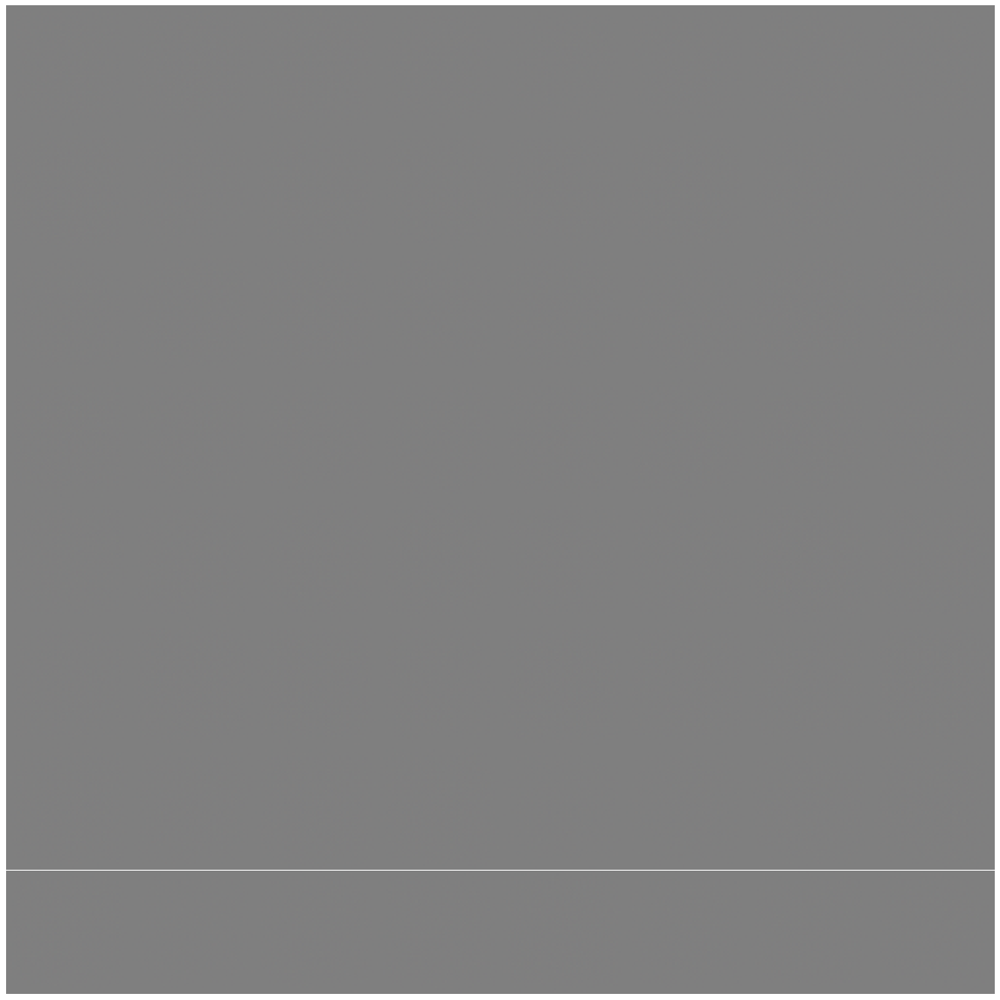

Instructions for updating:
Use tf.cast instead.
Disc: real loss: 1.049142 fake loss: 3.010625
GAN loss: 1.216951
Step 0 completed. Time took: 10 secs.
Begin step:  1
Disc: real loss: 0.784886 fake loss: 0.522950
GAN loss: 3.519074
Step 1 completed. Time took: 3 secs.
Begin step:  2
Disc: real loss: 0.580740 fake loss: 0.417140
GAN loss: 3.128571
Step 2 completed. Time took: 3 secs.
Begin step:  3
Disc: real loss: 0.432807 fake loss: 0.558640
GAN loss: 3.879475
Step 3 completed. Time took: 3 secs.
Begin step:  4
Disc: real loss: 0.550253 fake loss: 0.339760
GAN loss: 2.806548
Step 4 completed. Time took: 3 secs.
Begin step:  5
Disc: real loss: 0.526402 fake loss: 0.428505
GAN loss: 4.478690
Step 5 completed. Time took: 3 secs.
Begin step:  6
Disc: real loss: 0.399861 fake loss: 0.444070
GAN loss: 2.392673
Step 6 completed. Time took: 3 secs.
Begin step:  7
Disc: real loss: 0.422480 fake loss: 1.200674
GAN loss: 8.077890
Step 7 completed. Time took: 3 secs.
Begin step:  8
Disc: real loss

Disc: real loss: 0.517283 fake loss: 0.538376
GAN loss: 4.272122
Step 67 completed. Time took: 3 secs.
Begin step:  68
Disc: real loss: 0.434901 fake loss: 0.494371
GAN loss: 3.218146
Step 68 completed. Time took: 3 secs.
Begin step:  69
Disc: real loss: 0.405989 fake loss: 0.465573
GAN loss: 1.968480
Step 69 completed. Time took: 3 secs.
Begin step:  70
Disc: real loss: 0.450852 fake loss: 0.463005
GAN loss: 2.885489
Step 70 completed. Time took: 3 secs.
Begin step:  71
Disc: real loss: 0.385368 fake loss: 0.390274
GAN loss: 2.840536
Step 71 completed. Time took: 4 secs.
Begin step:  72
Disc: real loss: 0.417036 fake loss: 0.470329
GAN loss: 3.907660
Step 72 completed. Time took: 3 secs.
Begin step:  73
Disc: real loss: 0.633816 fake loss: 0.512475
GAN loss: 4.256966
Step 73 completed. Time took: 3 secs.
Begin step:  74
Disc: real loss: 0.422148 fake loss: 0.399236
GAN loss: 2.734112
Step 74 completed. Time took: 3 secs.
Begin step:  75
Disc: real loss: 0.404826 fake loss: 0.554017
GA

GAN loss: 2.949086
Step 135 completed. Time took: 3 secs.
Begin step:  136
Disc: real loss: 0.575823 fake loss: 0.439564
GAN loss: 2.553346
Step 136 completed. Time took: 3 secs.
Begin step:  137
Disc: real loss: 0.439206 fake loss: 0.403486
GAN loss: 2.534732
Step 137 completed. Time took: 3 secs.
Begin step:  138
Disc: real loss: 0.417101 fake loss: 0.412427
GAN loss: 2.974210
Step 138 completed. Time took: 4 secs.
Begin step:  139
Disc: real loss: 0.402227 fake loss: 0.365959
GAN loss: 2.694579
Step 139 completed. Time took: 4 secs.
Begin step:  140
Disc: real loss: 0.373369 fake loss: 0.368980
GAN loss: 2.716927
Step 140 completed. Time took: 3 secs.
Begin step:  141
Disc: real loss: 0.423351 fake loss: 0.388884
GAN loss: 2.640341
Step 141 completed. Time took: 3 secs.
Begin step:  142
Disc: real loss: 0.439453 fake loss: 0.547615
GAN loss: 3.514946
Step 142 completed. Time took: 4 secs.
Begin step:  143
Disc: real loss: 0.506711 fake loss: 0.384204
GAN loss: 2.082761
Step 143 comp

GAN loss: 3.433381
Step 203 completed. Time took: 3 secs.
Begin step:  204
Disc: real loss: 0.406878 fake loss: 0.404938
GAN loss: 2.268444
Step 204 completed. Time took: 3 secs.
Begin step:  205
Disc: real loss: 0.399762 fake loss: 0.636807
GAN loss: 3.939827
Step 205 completed. Time took: 3 secs.
Begin step:  206
Disc: real loss: 0.685871 fake loss: 0.376311
GAN loss: 1.882844
Step 206 completed. Time took: 3 secs.
Begin step:  207
Disc: real loss: 0.384065 fake loss: 0.538167
GAN loss: 3.700137
Step 207 completed. Time took: 3 secs.
Begin step:  208
Disc: real loss: 0.624490 fake loss: 0.424906
GAN loss: 2.352948
Step 208 completed. Time took: 3 secs.
Begin step:  209
Disc: real loss: 0.427756 fake loss: 0.414388
GAN loss: 3.305512
Step 209 completed. Time took: 3 secs.
Begin step:  210
Disc: real loss: 0.622368 fake loss: 0.455416
GAN loss: 2.821906
Step 210 completed. Time took: 3 secs.
Begin step:  211
Disc: real loss: 0.442250 fake loss: 0.383744
GAN loss: 2.521566
Step 211 comp

GAN loss: 2.430532
Step 271 completed. Time took: 3 secs.
Begin step:  272
Disc: real loss: 0.371700 fake loss: 0.470204
GAN loss: 3.994864
Step 272 completed. Time took: 3 secs.
Begin step:  273
Disc: real loss: 0.579934 fake loss: 0.385438
GAN loss: 2.321295
Step 273 completed. Time took: 3 secs.
Begin step:  274
Disc: real loss: 0.389972 fake loss: 0.482949
GAN loss: 3.105381
Step 274 completed. Time took: 3 secs.
Begin step:  275
Disc: real loss: 0.602920 fake loss: 0.471791
GAN loss: 3.109474
Step 275 completed. Time took: 3 secs.
Begin step:  276
Disc: real loss: 0.429760 fake loss: 0.352627
GAN loss: 3.025157
Step 276 completed. Time took: 3 secs.
Begin step:  277
Disc: real loss: 0.415200 fake loss: 0.451485
GAN loss: 3.911899
Step 277 completed. Time took: 3 secs.
Begin step:  278
Disc: real loss: 0.667131 fake loss: 0.745596
GAN loss: 4.603341
Step 278 completed. Time took: 3 secs.
Begin step:  279
Disc: real loss: 0.486902 fake loss: 0.454762
GAN loss: 2.580659
Step 279 comp

GAN loss: 2.487996
Step 339 completed. Time took: 3 secs.
Begin step:  340
Disc: real loss: 0.418417 fake loss: 0.471463
GAN loss: 2.991105
Step 340 completed. Time took: 3 secs.
Begin step:  341
Disc: real loss: 0.561589 fake loss: 0.430369
GAN loss: 1.914489
Step 341 completed. Time took: 3 secs.
Begin step:  342
Disc: real loss: 0.335783 fake loss: 0.472769
GAN loss: 3.024466
Step 342 completed. Time took: 3 secs.
Begin step:  343
Disc: real loss: 0.525244 fake loss: 0.414343
GAN loss: 2.232285
Step 343 completed. Time took: 3 secs.
Begin step:  344
Disc: real loss: 0.403269 fake loss: 0.433275
GAN loss: 2.817169
Step 344 completed. Time took: 3 secs.
Begin step:  345
Disc: real loss: 0.497871 fake loss: 0.495020
GAN loss: 3.003983
Step 345 completed. Time took: 3 secs.
Begin step:  346
Disc: real loss: 0.455036 fake loss: 0.389206
GAN loss: 2.199271
Step 346 completed. Time took: 3 secs.
Begin step:  347
Disc: real loss: 0.390916 fake loss: 0.408186
GAN loss: 3.250286
Step 347 comp

GAN loss: 2.144593
Step 407 completed. Time took: 3 secs.
Begin step:  408
Disc: real loss: 0.363382 fake loss: 0.567339
GAN loss: 4.029075
Step 408 completed. Time took: 4 secs.
Begin step:  409
Disc: real loss: 0.852196 fake loss: 0.451540
GAN loss: 2.594540
Step 409 completed. Time took: 4 secs.
Begin step:  410
Disc: real loss: 0.347366 fake loss: 0.337871
GAN loss: 2.810491
Step 410 completed. Time took: 3 secs.
Begin step:  411
Disc: real loss: 0.348459 fake loss: 0.470679
GAN loss: 3.914894
Step 411 completed. Time took: 4 secs.
Begin step:  412
Disc: real loss: 0.766761 fake loss: 0.852084
GAN loss: 3.678532
Step 412 completed. Time took: 3 secs.
Begin step:  413
Disc: real loss: 0.459032 fake loss: 0.425912
GAN loss: 3.136427
Step 413 completed. Time took: 3 secs.
Begin step:  414
Disc: real loss: 0.347822 fake loss: 0.464151
GAN loss: 2.596577
Step 414 completed. Time took: 3 secs.
Begin step:  415
Disc: real loss: 0.478162 fake loss: 0.479916
GAN loss: 2.580367
Step 415 comp

GAN loss: 4.670775
Step 475 completed. Time took: 3 secs.
Begin step:  476
Disc: real loss: 1.239007 fake loss: 0.475546
GAN loss: 1.798862
Step 476 completed. Time took: 3 secs.
Begin step:  477
Disc: real loss: 0.380697 fake loss: 0.521351
GAN loss: 3.171564
Step 477 completed. Time took: 4 secs.
Begin step:  478
Disc: real loss: 0.419875 fake loss: 0.419145
GAN loss: 2.633487
Step 478 completed. Time took: 3 secs.
Begin step:  479
Disc: real loss: 0.417222 fake loss: 0.673443
GAN loss: 3.443419
Step 479 completed. Time took: 3 secs.
Begin step:  480
Disc: real loss: 0.811444 fake loss: 0.478887
GAN loss: 2.199929
Step 480 completed. Time took: 3 secs.
Begin step:  481
Disc: real loss: 0.423121 fake loss: 0.431336
GAN loss: 2.407608
Step 481 completed. Time took: 3 secs.
Begin step:  482
Disc: real loss: 0.374190 fake loss: 0.447892
GAN loss: 2.930193
Step 482 completed. Time took: 3 secs.
Begin step:  483
Disc: real loss: 0.412973 fake loss: 0.366799
GAN loss: 2.132170
Step 483 comp

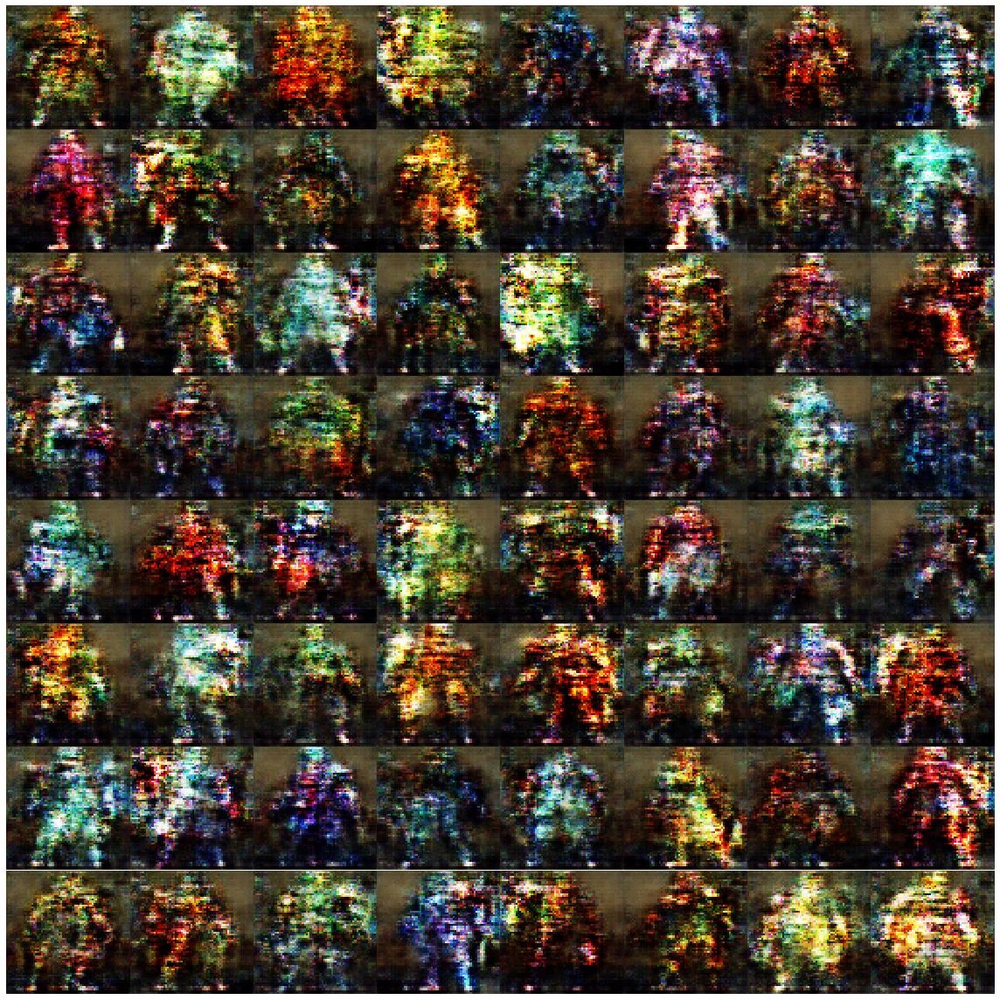

Disc: real loss: 0.575323 fake loss: 0.400580
GAN loss: 1.940062
Step 500 completed. Time took: 7 secs.
Begin step:  501
Disc: real loss: 0.354901 fake loss: 0.459560
GAN loss: 3.027011
Step 501 completed. Time took: 3 secs.
Begin step:  502
Disc: real loss: 0.537540 fake loss: 0.433804
GAN loss: 3.055898
Step 502 completed. Time took: 3 secs.
Begin step:  503
Disc: real loss: 0.565993 fake loss: 0.512030
GAN loss: 3.362836
Step 503 completed. Time took: 3 secs.
Begin step:  504
Disc: real loss: 0.427904 fake loss: 0.368329
GAN loss: 2.233002
Step 504 completed. Time took: 3 secs.
Begin step:  505
Disc: real loss: 0.373898 fake loss: 0.427025
GAN loss: 3.046912
Step 505 completed. Time took: 3 secs.
Begin step:  506
Disc: real loss: 0.522200 fake loss: 0.571740
GAN loss: 3.173117
Step 506 completed. Time took: 3 secs.
Begin step:  507
Disc: real loss: 0.525661 fake loss: 0.340941
GAN loss: 2.251056
Step 507 completed. Time took: 3 secs.
Begin step:  508
Disc: real loss: 0.354941 fake l

Disc: real loss: 0.396604 fake loss: 0.473101
GAN loss: 2.861941
Step 568 completed. Time took: 3 secs.
Begin step:  569
Disc: real loss: 0.457771 fake loss: 0.439222
GAN loss: 2.611179
Step 569 completed. Time took: 3 secs.
Begin step:  570
Disc: real loss: 0.466402 fake loss: 0.536775
GAN loss: 2.978679
Step 570 completed. Time took: 3 secs.
Begin step:  571
Disc: real loss: 0.479570 fake loss: 0.443744
GAN loss: 3.482690
Step 571 completed. Time took: 4 secs.
Begin step:  572
Disc: real loss: 0.483349 fake loss: 0.444645
GAN loss: 2.475660
Step 572 completed. Time took: 3 secs.
Begin step:  573
Disc: real loss: 0.352032 fake loss: 0.393659
GAN loss: 3.212159
Step 573 completed. Time took: 4 secs.
Begin step:  574
Disc: real loss: 0.486672 fake loss: 0.466987
GAN loss: 3.009914
Step 574 completed. Time took: 4 secs.
Begin step:  575
Disc: real loss: 0.405628 fake loss: 0.376087
GAN loss: 2.364582
Step 575 completed. Time took: 5 secs.
Begin step:  576
Disc: real loss: 0.350710 fake l

Disc: real loss: 0.404506 fake loss: 0.473603
GAN loss: 2.647638
Step 636 completed. Time took: 3 secs.
Begin step:  637
Disc: real loss: 0.523623 fake loss: 0.589900
GAN loss: 3.438012
Step 637 completed. Time took: 3 secs.
Begin step:  638
Disc: real loss: 0.511809 fake loss: 0.321370
GAN loss: 2.328813
Step 638 completed. Time took: 3 secs.
Begin step:  639
Disc: real loss: 0.404080 fake loss: 0.488010
GAN loss: 3.158153
Step 639 completed. Time took: 3 secs.
Begin step:  640
Disc: real loss: 0.552926 fake loss: 0.440567
GAN loss: 2.861468
Step 640 completed. Time took: 3 secs.
Begin step:  641
Disc: real loss: 0.394319 fake loss: 0.333090
GAN loss: 2.491324
Step 641 completed. Time took: 3 secs.
Begin step:  642
Disc: real loss: 0.368343 fake loss: 0.595947
GAN loss: 4.071403
Step 642 completed. Time took: 3 secs.
Begin step:  643
Disc: real loss: 0.701242 fake loss: 0.482049
GAN loss: 2.355274
Step 643 completed. Time took: 3 secs.
Begin step:  644
Disc: real loss: 0.358983 fake l

Disc: real loss: 0.396557 fake loss: 0.404358
GAN loss: 2.639468
Step 704 completed. Time took: 3 secs.
Begin step:  705
Disc: real loss: 0.472115 fake loss: 0.473639
GAN loss: 2.620486
Step 705 completed. Time took: 3 secs.
Begin step:  706
Disc: real loss: 0.436621 fake loss: 0.494641
GAN loss: 3.811311
Step 706 completed. Time took: 3 secs.
Begin step:  707
Disc: real loss: 0.578705 fake loss: 0.590910
GAN loss: 4.687109
Step 707 completed. Time took: 3 secs.
Begin step:  708
Disc: real loss: 0.720517 fake loss: 0.388904
GAN loss: 2.354979
Step 708 completed. Time took: 3 secs.
Begin step:  709
Disc: real loss: 0.357842 fake loss: 0.444833
GAN loss: 3.403589
Step 709 completed. Time took: 3 secs.
Begin step:  710
Disc: real loss: 0.421153 fake loss: 0.381479
GAN loss: 2.338608
Step 710 completed. Time took: 3 secs.
Begin step:  711
Disc: real loss: 0.372890 fake loss: 0.486231
GAN loss: 4.398845
Step 711 completed. Time took: 3 secs.
Begin step:  712
Disc: real loss: 0.771598 fake l

Disc: real loss: 0.606426 fake loss: 0.379888
GAN loss: 2.172567
Step 772 completed. Time took: 3 secs.
Begin step:  773
Disc: real loss: 0.343158 fake loss: 0.523584
GAN loss: 3.481834
Step 773 completed. Time took: 3 secs.
Begin step:  774
Disc: real loss: 0.454544 fake loss: 0.376469
GAN loss: 2.438093
Step 774 completed. Time took: 3 secs.
Begin step:  775
Disc: real loss: 0.372624 fake loss: 0.576770
GAN loss: 3.497730
Step 775 completed. Time took: 3 secs.
Begin step:  776
Disc: real loss: 0.621002 fake loss: 0.514901
GAN loss: 3.313276
Step 776 completed. Time took: 3 secs.
Begin step:  777
Disc: real loss: 0.343031 fake loss: 0.357775
GAN loss: 2.731886
Step 777 completed. Time took: 3 secs.
Begin step:  778
Disc: real loss: 0.352163 fake loss: 0.486214
GAN loss: 2.946647
Step 778 completed. Time took: 3 secs.
Begin step:  779
Disc: real loss: 0.459170 fake loss: 0.363476
GAN loss: 2.234823
Step 779 completed. Time took: 3 secs.
Begin step:  780
Disc: real loss: 0.385975 fake l

Disc: real loss: 0.371318 fake loss: 0.424021
GAN loss: 3.129990
Step 840 completed. Time took: 3 secs.
Begin step:  841
Disc: real loss: 0.365932 fake loss: 0.365376
GAN loss: 2.258783
Step 841 completed. Time took: 3 secs.
Begin step:  842
Disc: real loss: 0.402371 fake loss: 0.752624
GAN loss: 4.470336
Step 842 completed. Time took: 3 secs.
Begin step:  843
Disc: real loss: 1.030215 fake loss: 0.364083
GAN loss: 1.636696
Step 843 completed. Time took: 3 secs.
Begin step:  844
Disc: real loss: 0.456368 fake loss: 0.551346
GAN loss: 4.417346
Step 844 completed. Time took: 3 secs.
Begin step:  845
Disc: real loss: 0.749421 fake loss: 0.418911
GAN loss: 2.271705
Step 845 completed. Time took: 3 secs.
Begin step:  846
Disc: real loss: 0.354499 fake loss: 0.418186
GAN loss: 2.889583
Step 846 completed. Time took: 3 secs.
Begin step:  847
Disc: real loss: 0.357853 fake loss: 0.370856
GAN loss: 3.073006
Step 847 completed. Time took: 3 secs.
Begin step:  848
Disc: real loss: 0.451211 fake l

Disc: real loss: 0.676540 fake loss: 0.366275
GAN loss: 1.766051
Step 908 completed. Time took: 3 secs.
Begin step:  909
Disc: real loss: 0.355550 fake loss: 0.452850
GAN loss: 3.234972
Step 909 completed. Time took: 3 secs.
Begin step:  910
Disc: real loss: 0.433057 fake loss: 0.356599
GAN loss: 2.368225
Step 910 completed. Time took: 3 secs.
Begin step:  911
Disc: real loss: 0.391487 fake loss: 0.489566
GAN loss: 3.168172
Step 911 completed. Time took: 3 secs.
Begin step:  912
Disc: real loss: 0.418042 fake loss: 0.378911
GAN loss: 2.311787
Step 912 completed. Time took: 3 secs.
Begin step:  913
Disc: real loss: 0.351555 fake loss: 0.480295
GAN loss: 3.370343
Step 913 completed. Time took: 3 secs.
Begin step:  914
Disc: real loss: 0.612064 fake loss: 0.461424
GAN loss: 2.959207
Step 914 completed. Time took: 3 secs.
Begin step:  915
Disc: real loss: 0.400840 fake loss: 0.350881
GAN loss: 2.671811
Step 915 completed. Time took: 3 secs.
Begin step:  916
Disc: real loss: 0.417910 fake l

Disc: real loss: 0.489688 fake loss: 0.516849
GAN loss: 2.690582
Step 976 completed. Time took: 3 secs.
Begin step:  977
Disc: real loss: 0.456697 fake loss: 0.401255
GAN loss: 1.930098
Step 977 completed. Time took: 3 secs.
Begin step:  978
Disc: real loss: 0.360004 fake loss: 0.443695
GAN loss: 3.033622
Step 978 completed. Time took: 3 secs.
Begin step:  979
Disc: real loss: 0.569421 fake loss: 0.498697
GAN loss: 3.172156
Step 979 completed. Time took: 3 secs.
Begin step:  980
Disc: real loss: 0.461011 fake loss: 0.386807
GAN loss: 2.513351
Step 980 completed. Time took: 3 secs.
Begin step:  981
Disc: real loss: 0.375547 fake loss: 0.373567
GAN loss: 2.314512
Step 981 completed. Time took: 3 secs.
Begin step:  982
Disc: real loss: 0.394198 fake loss: 0.522856
GAN loss: 3.161676
Step 982 completed. Time took: 3 secs.
Begin step:  983
Disc: real loss: 0.476962 fake loss: 0.385359
GAN loss: 2.441937
Step 983 completed. Time took: 3 secs.
Begin step:  984
Disc: real loss: 0.441345 fake l

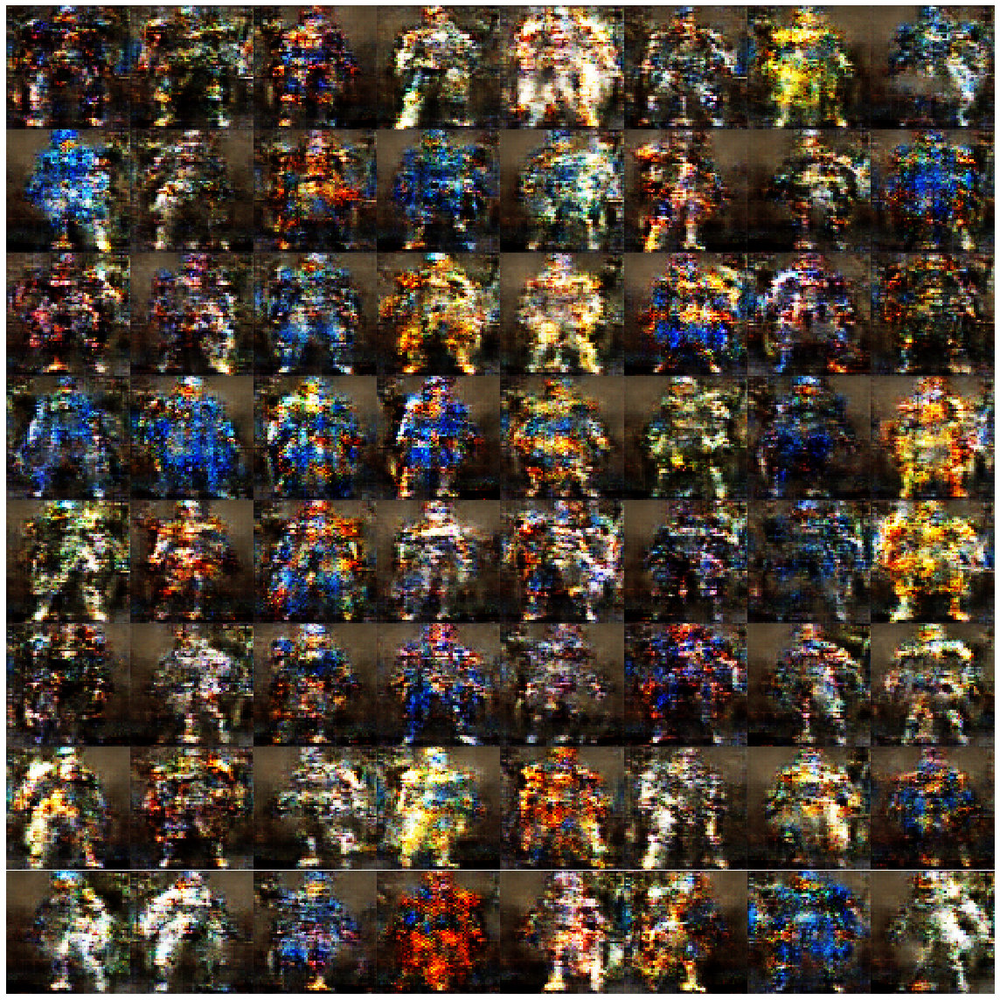

Begin step:  1000


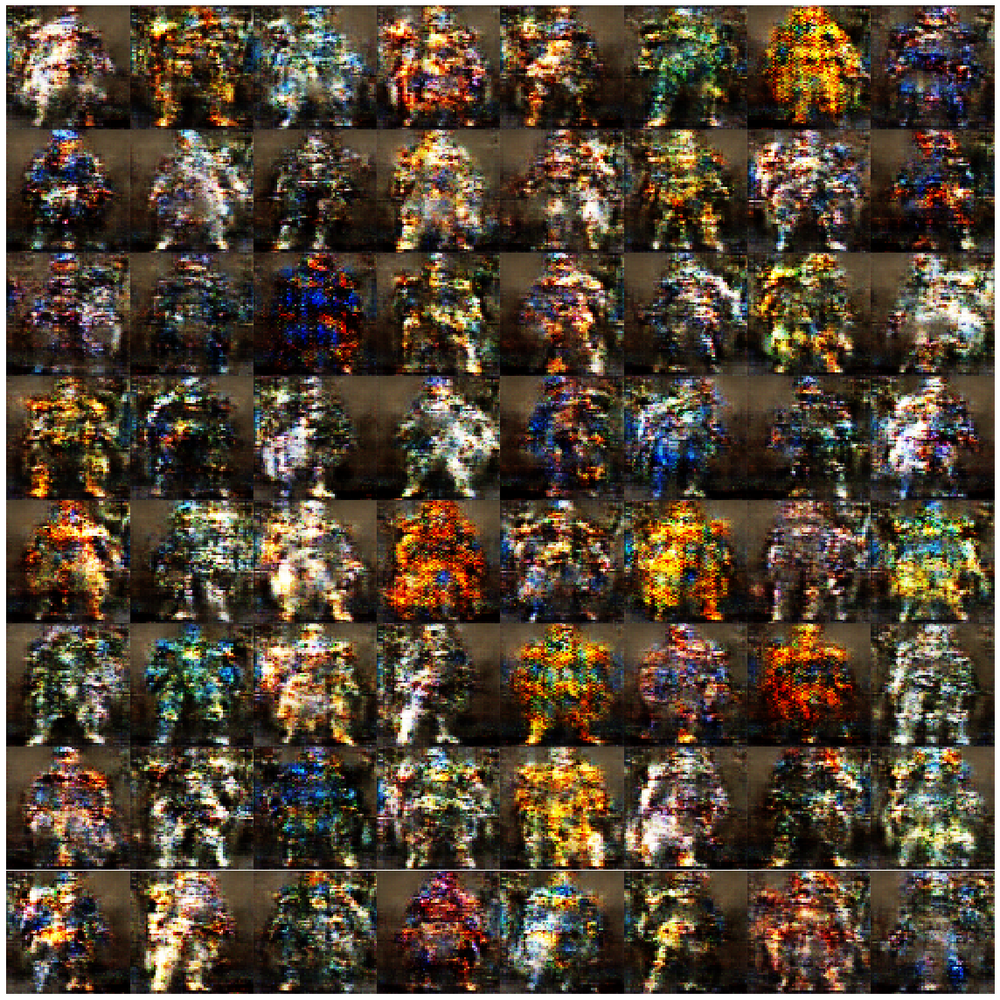

Disc: real loss: 0.414882 fake loss: 0.397659
GAN loss: 2.621703
Step 1000 completed. Time took: 6 secs.
Begin step:  1001
Disc: real loss: 0.476738 fake loss: 0.465948
GAN loss: 2.743596
Step 1001 completed. Time took: 3 secs.
Begin step:  1002
Disc: real loss: 0.369630 fake loss: 0.385397
GAN loss: 3.232765
Step 1002 completed. Time took: 3 secs.
Begin step:  1003
Disc: real loss: 0.549186 fake loss: 0.583139
GAN loss: 3.241580
Step 1003 completed. Time took: 3 secs.
Begin step:  1004
Disc: real loss: 0.508579 fake loss: 0.366758
GAN loss: 2.237531
Step 1004 completed. Time took: 3 secs.
Begin step:  1005
Disc: real loss: 0.335010 fake loss: 0.504265
GAN loss: 3.830045
Step 1005 completed. Time took: 3 secs.
Begin step:  1006
Disc: real loss: 0.555516 fake loss: 0.490821
GAN loss: 3.434569
Step 1006 completed. Time took: 3 secs.
Begin step:  1007
Disc: real loss: 0.420857 fake loss: 0.391807
GAN loss: 2.419004
Step 1007 completed. Time took: 3 secs.
Begin step:  1008
Disc: real loss:

Disc: real loss: 0.706895 fake loss: 0.423414
GAN loss: 2.240616
Step 1067 completed. Time took: 3 secs.
Begin step:  1068
Disc: real loss: 0.398896 fake loss: 0.383676
GAN loss: 2.684139
Step 1068 completed. Time took: 3 secs.
Begin step:  1069
Disc: real loss: 0.509181 fake loss: 0.575761
GAN loss: 3.222733
Step 1069 completed. Time took: 3 secs.
Begin step:  1070
Disc: real loss: 0.523747 fake loss: 0.390318
GAN loss: 2.204024
Step 1070 completed. Time took: 3 secs.
Begin step:  1071
Disc: real loss: 0.369621 fake loss: 0.729913
GAN loss: 4.818326
Step 1071 completed. Time took: 3 secs.
Begin step:  1072
Disc: real loss: 0.908213 fake loss: 0.383687
GAN loss: 1.981051
Step 1072 completed. Time took: 3 secs.
Begin step:  1073
Disc: real loss: 0.311429 fake loss: 0.506045
GAN loss: 3.576941
Step 1073 completed. Time took: 3 secs.
Begin step:  1074
Disc: real loss: 0.483440 fake loss: 0.416197
GAN loss: 2.553461
Step 1074 completed. Time took: 3 secs.
Begin step:  1075
Disc: real loss:

Disc: real loss: 0.398208 fake loss: 0.436610
GAN loss: 2.813125
Step 1134 completed. Time took: 3 secs.
Begin step:  1135
Disc: real loss: 0.518143 fake loss: 0.534518
GAN loss: 3.009255
Step 1135 completed. Time took: 3 secs.
Begin step:  1136
Disc: real loss: 0.402898 fake loss: 0.352609
GAN loss: 2.460518
Step 1136 completed. Time took: 3 secs.
Begin step:  1137
Disc: real loss: 0.424441 fake loss: 0.625048
GAN loss: 3.735991
Step 1137 completed. Time took: 3 secs.
Begin step:  1138
Disc: real loss: 0.538107 fake loss: 0.375643
GAN loss: 2.089588
Step 1138 completed. Time took: 3 secs.
Begin step:  1139
Disc: real loss: 0.336811 fake loss: 0.499110
GAN loss: 3.598479
Step 1139 completed. Time took: 3 secs.
Begin step:  1140
Disc: real loss: 0.498385 fake loss: 0.382065
GAN loss: 1.917374
Step 1140 completed. Time took: 3 secs.
Begin step:  1141
Disc: real loss: 0.367114 fake loss: 0.500201
GAN loss: 3.685663
Step 1141 completed. Time took: 3 secs.
Begin step:  1142
Disc: real loss:

Disc: real loss: 0.376129 fake loss: 0.398818
GAN loss: 2.847722
Step 1201 completed. Time took: 3 secs.
Begin step:  1202
Disc: real loss: 0.405497 fake loss: 0.425536
GAN loss: 3.153400
Step 1202 completed. Time took: 3 secs.
Begin step:  1203
Disc: real loss: 0.418319 fake loss: 0.426243
GAN loss: 3.077594
Step 1203 completed. Time took: 3 secs.
Begin step:  1204
Disc: real loss: 0.409015 fake loss: 0.401353
GAN loss: 2.417780
Step 1204 completed. Time took: 3 secs.
Begin step:  1205
Disc: real loss: 0.377887 fake loss: 0.382885
GAN loss: 2.395330
Step 1205 completed. Time took: 3 secs.
Begin step:  1206
Disc: real loss: 0.393517 fake loss: 0.505194
GAN loss: 3.512325
Step 1206 completed. Time took: 3 secs.
Begin step:  1207
Disc: real loss: 0.674088 fake loss: 0.651704
GAN loss: 3.446284
Step 1207 completed. Time took: 3 secs.
Begin step:  1208
Disc: real loss: 0.479726 fake loss: 0.368964
GAN loss: 2.257619
Step 1208 completed. Time took: 3 secs.
Begin step:  1209
Disc: real loss:

Disc: real loss: 0.501180 fake loss: 0.333385
GAN loss: 2.069505
Step 1268 completed. Time took: 3 secs.
Begin step:  1269
Disc: real loss: 0.417960 fake loss: 0.657796
GAN loss: 3.555009
Step 1269 completed. Time took: 3 secs.
Begin step:  1270
Disc: real loss: 0.589682 fake loss: 0.363343
GAN loss: 1.940768
Step 1270 completed. Time took: 3 secs.
Begin step:  1271
Disc: real loss: 0.366490 fake loss: 0.453290
GAN loss: 3.097480
Step 1271 completed. Time took: 3 secs.
Begin step:  1272
Disc: real loss: 0.514725 fake loss: 0.393358
GAN loss: 1.817895
Step 1272 completed. Time took: 3 secs.
Begin step:  1273
Disc: real loss: 0.355445 fake loss: 0.471372
GAN loss: 3.048481
Step 1273 completed. Time took: 3 secs.
Begin step:  1274
Disc: real loss: 0.464452 fake loss: 0.351908
GAN loss: 1.898487
Step 1274 completed. Time took: 3 secs.
Begin step:  1275
Disc: real loss: 0.369062 fake loss: 0.510808
GAN loss: 3.167033
Step 1275 completed. Time took: 3 secs.
Begin step:  1276
Disc: real loss:

Disc: real loss: 0.357498 fake loss: 0.443687
GAN loss: 3.039972
Step 1335 completed. Time took: 3 secs.
Begin step:  1336
Disc: real loss: 0.478631 fake loss: 0.384962
GAN loss: 2.559652
Step 1336 completed. Time took: 3 secs.
Begin step:  1337
Disc: real loss: 0.395175 fake loss: 0.432695
GAN loss: 3.129668
Step 1337 completed. Time took: 3 secs.
Begin step:  1338
Disc: real loss: 0.413800 fake loss: 0.406284
GAN loss: 2.606302
Step 1338 completed. Time took: 3 secs.
Begin step:  1339
Disc: real loss: 0.372518 fake loss: 0.486152
GAN loss: 3.142394
Step 1339 completed. Time took: 3 secs.
Begin step:  1340
Disc: real loss: 0.398453 fake loss: 0.386422
GAN loss: 2.922650
Step 1340 completed. Time took: 3 secs.
Begin step:  1341
Disc: real loss: 0.353889 fake loss: 0.376410
GAN loss: 2.723304
Step 1341 completed. Time took: 3 secs.
Begin step:  1342
Disc: real loss: 0.401096 fake loss: 0.492338
GAN loss: 3.479793
Step 1342 completed. Time took: 3 secs.
Begin step:  1343
Disc: real loss:

Disc: real loss: 0.373003 fake loss: 0.381868
GAN loss: 2.451581
Step 1402 completed. Time took: 3 secs.
Begin step:  1403
Disc: real loss: 0.378525 fake loss: 0.419732
GAN loss: 2.607884
Step 1403 completed. Time took: 3 secs.
Begin step:  1404
Disc: real loss: 0.393810 fake loss: 0.444491
GAN loss: 3.405982
Step 1404 completed. Time took: 3 secs.
Begin step:  1405
Disc: real loss: 0.520498 fake loss: 0.478386
GAN loss: 3.322837
Step 1405 completed. Time took: 3 secs.
Begin step:  1406
Disc: real loss: 0.415082 fake loss: 0.330521
GAN loss: 2.208229
Step 1406 completed. Time took: 3 secs.
Begin step:  1407
Disc: real loss: 0.357147 fake loss: 0.408326
GAN loss: 3.057994
Step 1407 completed. Time took: 3 secs.
Begin step:  1408
Disc: real loss: 0.415331 fake loss: 0.353892
GAN loss: 2.074181
Step 1408 completed. Time took: 3 secs.
Begin step:  1409
Disc: real loss: 0.321393 fake loss: 0.444146
GAN loss: 3.180000
Step 1409 completed. Time took: 3 secs.
Begin step:  1410
Disc: real loss:

Disc: real loss: 0.365964 fake loss: 0.414393
GAN loss: 2.823720
Step 1469 completed. Time took: 3 secs.
Begin step:  1470
Disc: real loss: 0.504755 fake loss: 0.513601
GAN loss: 3.150094
Step 1470 completed. Time took: 3 secs.
Begin step:  1471
Disc: real loss: 0.397793 fake loss: 0.411284
GAN loss: 2.405540
Step 1471 completed. Time took: 3 secs.
Begin step:  1472
Disc: real loss: 0.415967 fake loss: 0.483295
GAN loss: 3.311720
Step 1472 completed. Time took: 3 secs.
Begin step:  1473
Disc: real loss: 0.489372 fake loss: 0.347922
GAN loss: 2.193269
Step 1473 completed. Time took: 3 secs.
Begin step:  1474
Disc: real loss: 0.389870 fake loss: 0.399019
GAN loss: 2.972252
Step 1474 completed. Time took: 3 secs.
Begin step:  1475
Disc: real loss: 0.488722 fake loss: 0.393987
GAN loss: 2.631854
Step 1475 completed. Time took: 3 secs.
Begin step:  1476
Disc: real loss: 0.345564 fake loss: 0.393856
GAN loss: 2.665851
Step 1476 completed. Time took: 3 secs.
Begin step:  1477
Disc: real loss:

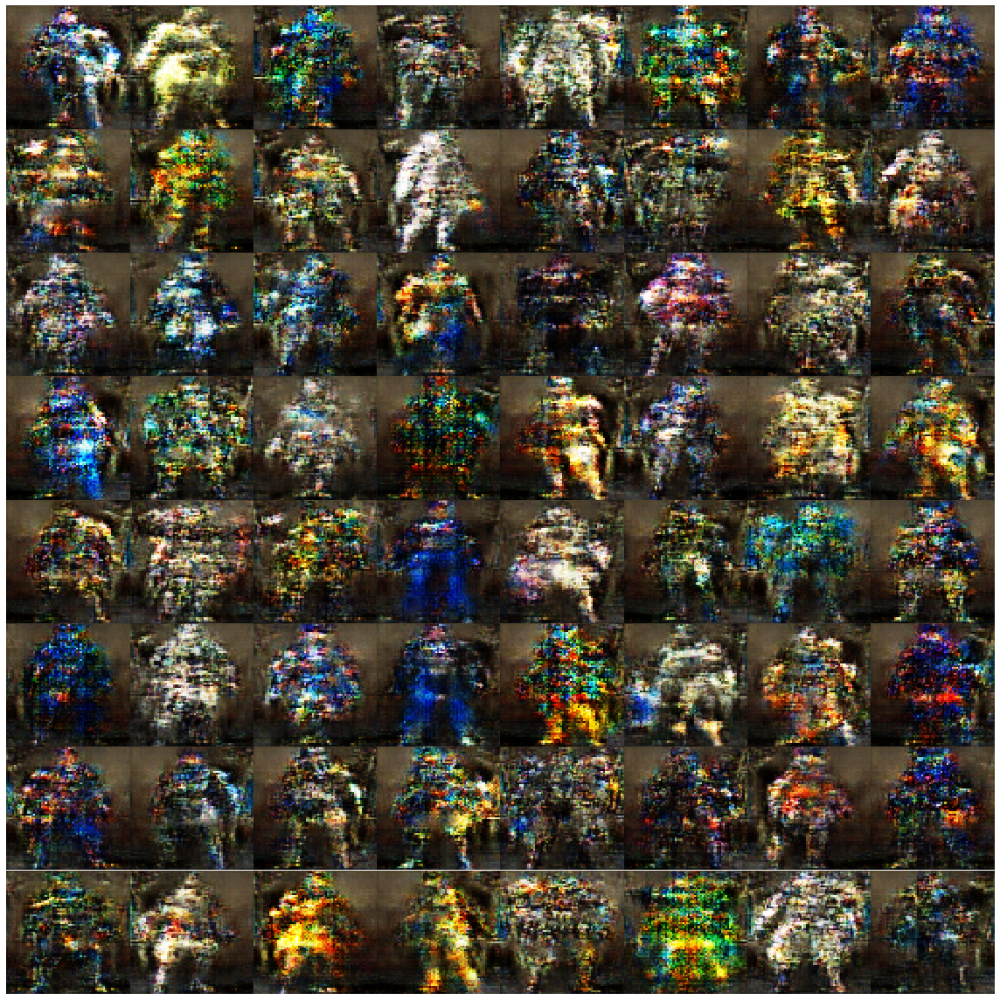

Disc: real loss: 0.450418 fake loss: 0.331879
GAN loss: 2.159103
Step 1500 completed. Time took: 6 secs.
Begin step:  1501
Disc: real loss: 0.366727 fake loss: 0.378022
GAN loss: 3.302489
Step 1501 completed. Time took: 3 secs.
Begin step:  1502
Disc: real loss: 0.433201 fake loss: 0.391748
GAN loss: 2.656657
Step 1502 completed. Time took: 3 secs.
Begin step:  1503
Disc: real loss: 0.321835 fake loss: 0.373323
GAN loss: 2.395074
Step 1503 completed. Time took: 3 secs.
Begin step:  1504
Disc: real loss: 0.373369 fake loss: 0.472269
GAN loss: 3.167900
Step 1504 completed. Time took: 3 secs.
Begin step:  1505
Disc: real loss: 0.505763 fake loss: 0.531049
GAN loss: 2.816711
Step 1505 completed. Time took: 3 secs.
Begin step:  1506
Disc: real loss: 0.471350 fake loss: 0.419317
GAN loss: 2.915771
Step 1506 completed. Time took: 3 secs.
Begin step:  1507
Disc: real loss: 0.366690 fake loss: 0.360043
GAN loss: 2.198885
Step 1507 completed. Time took: 3 secs.
Begin step:  1508
Disc: real loss:

Disc: real loss: 0.410005 fake loss: 0.361229
GAN loss: 2.845915
Step 1567 completed. Time took: 3 secs.
Begin step:  1568
Disc: real loss: 0.440228 fake loss: 0.414631
GAN loss: 2.677910
Step 1568 completed. Time took: 3 secs.
Begin step:  1569
Disc: real loss: 0.404989 fake loss: 0.384258
GAN loss: 2.657501
Step 1569 completed. Time took: 3 secs.
Begin step:  1570
Disc: real loss: 0.377098 fake loss: 0.375353
GAN loss: 2.259794
Step 1570 completed. Time took: 3 secs.
Begin step:  1571
Disc: real loss: 0.368347 fake loss: 0.379729
GAN loss: 2.756560
Step 1571 completed. Time took: 3 secs.
Begin step:  1572
Disc: real loss: 0.481624 fake loss: 0.533899
GAN loss: 3.064158
Step 1572 completed. Time took: 3 secs.
Begin step:  1573
Disc: real loss: 0.461321 fake loss: 0.412517
GAN loss: 1.741589
Step 1573 completed. Time took: 3 secs.
Begin step:  1574
Disc: real loss: 0.349566 fake loss: 0.482085
GAN loss: 3.715185
Step 1574 completed. Time took: 3 secs.
Begin step:  1575
Disc: real loss:

Disc: real loss: 0.354810 fake loss: 0.448761
GAN loss: 2.998813
Step 1634 completed. Time took: 3 secs.
Begin step:  1635
Disc: real loss: 0.380067 fake loss: 0.422764
GAN loss: 2.563731
Step 1635 completed. Time took: 3 secs.
Begin step:  1636
Disc: real loss: 0.394782 fake loss: 0.412383
GAN loss: 2.995121
Step 1636 completed. Time took: 3 secs.
Begin step:  1637
Disc: real loss: 0.441792 fake loss: 0.470026
GAN loss: 2.760027
Step 1637 completed. Time took: 3 secs.
Begin step:  1638
Disc: real loss: 0.440579 fake loss: 0.442560
GAN loss: 2.623275
Step 1638 completed. Time took: 3 secs.
Begin step:  1639
Disc: real loss: 0.375504 fake loss: 0.354788
GAN loss: 2.187746
Step 1639 completed. Time took: 3 secs.
Begin step:  1640
Disc: real loss: 0.351228 fake loss: 0.533314
GAN loss: 3.490216
Step 1640 completed. Time took: 3 secs.
Begin step:  1641
Disc: real loss: 0.510977 fake loss: 0.408985
GAN loss: 2.399351
Step 1641 completed. Time took: 3 secs.
Begin step:  1642
Disc: real loss:

Disc: real loss: 0.377172 fake loss: 0.407010
GAN loss: 2.730438
Step 1701 completed. Time took: 3 secs.
Begin step:  1702
Disc: real loss: 0.420784 fake loss: 0.428276
GAN loss: 2.560236
Step 1702 completed. Time took: 3 secs.
Begin step:  1703
Disc: real loss: 0.389299 fake loss: 0.403021
GAN loss: 3.081308
Step 1703 completed. Time took: 3 secs.
Begin step:  1704
Disc: real loss: 0.569149 fake loss: 0.693542
GAN loss: 3.770965
Step 1704 completed. Time took: 3 secs.
Begin step:  1705
Disc: real loss: 0.480092 fake loss: 0.367124
GAN loss: 2.188642
Step 1705 completed. Time took: 3 secs.
Begin step:  1706
Disc: real loss: 0.386192 fake loss: 0.563052
GAN loss: 3.641857
Step 1706 completed. Time took: 3 secs.
Begin step:  1707
Disc: real loss: 0.558748 fake loss: 0.372978
GAN loss: 1.934097
Step 1707 completed. Time took: 3 secs.
Begin step:  1708
Disc: real loss: 0.344674 fake loss: 0.449194
GAN loss: 3.435469
Step 1708 completed. Time took: 3 secs.
Begin step:  1709
Disc: real loss:

Disc: real loss: 0.348417 fake loss: 0.381738
GAN loss: 3.126909
Step 1768 completed. Time took: 3 secs.
Begin step:  1769
Disc: real loss: 0.541445 fake loss: 0.651180
GAN loss: 4.064520
Step 1769 completed. Time took: 3 secs.
Begin step:  1770
Disc: real loss: 0.532693 fake loss: 0.335275
GAN loss: 2.042145
Step 1770 completed. Time took: 3 secs.
Begin step:  1771
Disc: real loss: 0.389198 fake loss: 0.427039
GAN loss: 3.249831
Step 1771 completed. Time took: 3 secs.
Begin step:  1772
Disc: real loss: 0.388687 fake loss: 0.341826
GAN loss: 2.660678
Step 1772 completed. Time took: 3 secs.
Begin step:  1773
Disc: real loss: 0.393163 fake loss: 0.452163
GAN loss: 3.451042
Step 1773 completed. Time took: 3 secs.
Begin step:  1774
Disc: real loss: 0.425232 fake loss: 0.374669
GAN loss: 2.408837
Step 1774 completed. Time took: 3 secs.
Begin step:  1775
Disc: real loss: 0.308448 fake loss: 0.444264
GAN loss: 3.148231
Step 1775 completed. Time took: 3 secs.
Begin step:  1776
Disc: real loss:

Disc: real loss: 0.391739 fake loss: 0.436554
GAN loss: 2.963372
Step 1835 completed. Time took: 3 secs.
Begin step:  1836
Disc: real loss: 0.469588 fake loss: 0.452940
GAN loss: 3.163117
Step 1836 completed. Time took: 3 secs.
Begin step:  1837
Disc: real loss: 0.396992 fake loss: 0.374323
GAN loss: 2.493917
Step 1837 completed. Time took: 3 secs.
Begin step:  1838
Disc: real loss: 0.330217 fake loss: 0.361797
GAN loss: 2.686998
Step 1838 completed. Time took: 3 secs.
Begin step:  1839
Disc: real loss: 0.403684 fake loss: 0.425145
GAN loss: 3.028827
Step 1839 completed. Time took: 3 secs.
Begin step:  1840
Disc: real loss: 0.438312 fake loss: 0.384809
GAN loss: 2.869174
Step 1840 completed. Time took: 3 secs.
Begin step:  1841
Disc: real loss: 0.346432 fake loss: 0.372333
GAN loss: 2.588749
Step 1841 completed. Time took: 3 secs.
Begin step:  1842
Disc: real loss: 0.404096 fake loss: 0.363163
GAN loss: 2.148490
Step 1842 completed. Time took: 3 secs.
Begin step:  1843
Disc: real loss:

Disc: real loss: 0.352769 fake loss: 0.365326
GAN loss: 2.604881
Step 1902 completed. Time took: 3 secs.
Begin step:  1903
Disc: real loss: 0.405857 fake loss: 0.481639
GAN loss: 3.684912
Step 1903 completed. Time took: 3 secs.
Begin step:  1904
Disc: real loss: 0.420634 fake loss: 0.353713
GAN loss: 2.372680
Step 1904 completed. Time took: 3 secs.
Begin step:  1905
Disc: real loss: 0.360021 fake loss: 0.355987
GAN loss: 2.592027
Step 1905 completed. Time took: 3 secs.
Begin step:  1906
Disc: real loss: 0.375717 fake loss: 0.347301
GAN loss: 2.242751
Step 1906 completed. Time took: 3 secs.
Begin step:  1907
Disc: real loss: 0.374955 fake loss: 0.482822
GAN loss: 3.991720
Step 1907 completed. Time took: 3 secs.
Begin step:  1908
Disc: real loss: 0.805187 fake loss: 0.590916
GAN loss: 3.142013
Step 1908 completed. Time took: 3 secs.
Begin step:  1909
Disc: real loss: 0.413554 fake loss: 0.383189
GAN loss: 2.710244
Step 1909 completed. Time took: 3 secs.
Begin step:  1910
Disc: real loss:

Disc: real loss: 0.493821 fake loss: 0.362844
GAN loss: 2.332875
Step 1969 completed. Time took: 3 secs.
Begin step:  1970
Disc: real loss: 0.412526 fake loss: 0.427410
GAN loss: 3.312968
Step 1970 completed. Time took: 3 secs.
Begin step:  1971
Disc: real loss: 0.398625 fake loss: 0.335292
GAN loss: 2.841528
Step 1971 completed. Time took: 3 secs.
Begin step:  1972
Disc: real loss: 0.425333 fake loss: 0.513698
GAN loss: 3.320987
Step 1972 completed. Time took: 3 secs.
Begin step:  1973
Disc: real loss: 0.508144 fake loss: 0.352616
GAN loss: 2.031055
Step 1973 completed. Time took: 3 secs.
Begin step:  1974
Disc: real loss: 0.369660 fake loss: 0.380857
GAN loss: 2.840795
Step 1974 completed. Time took: 3 secs.
Begin step:  1975
Disc: real loss: 0.396940 fake loss: 0.359129
GAN loss: 2.397398
Step 1975 completed. Time took: 3 secs.
Begin step:  1976
Disc: real loss: 0.345409 fake loss: 0.318898
GAN loss: 2.150919
Step 1976 completed. Time took: 3 secs.
Begin step:  1977
Disc: real loss:

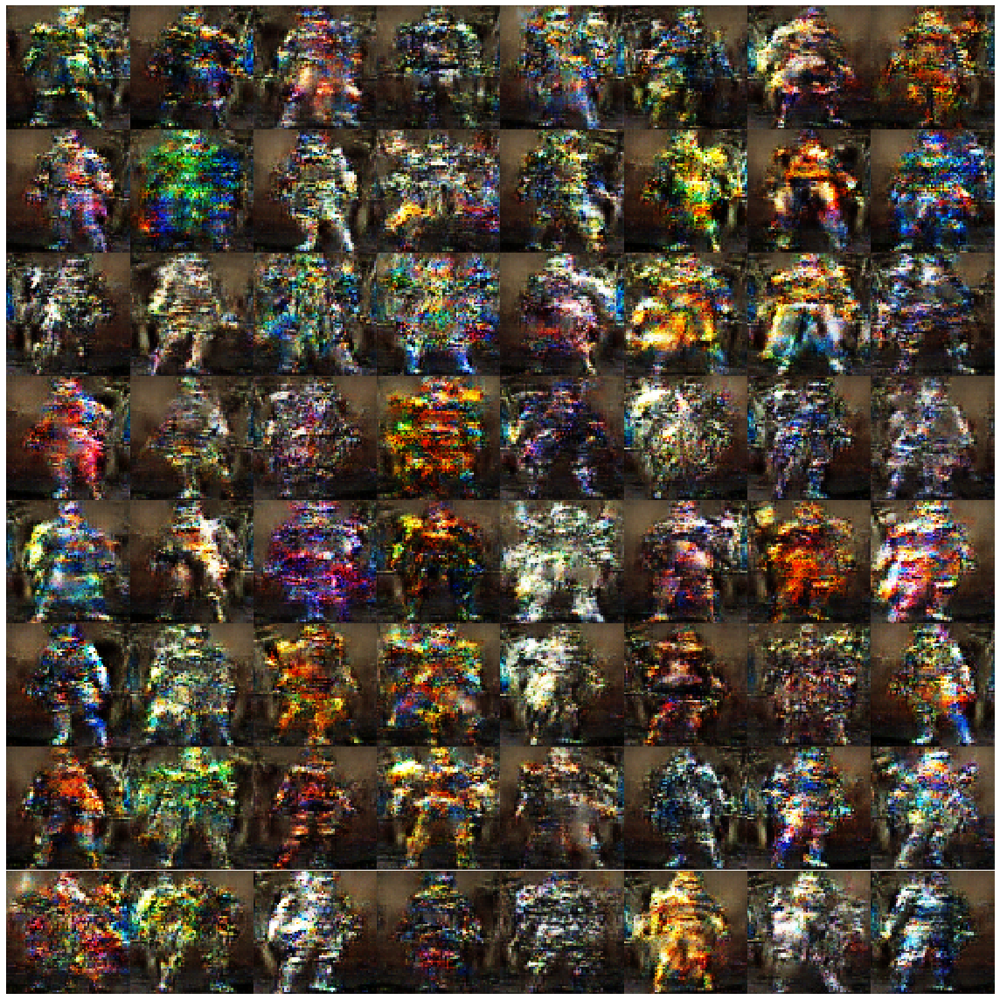

Begin step:  2000


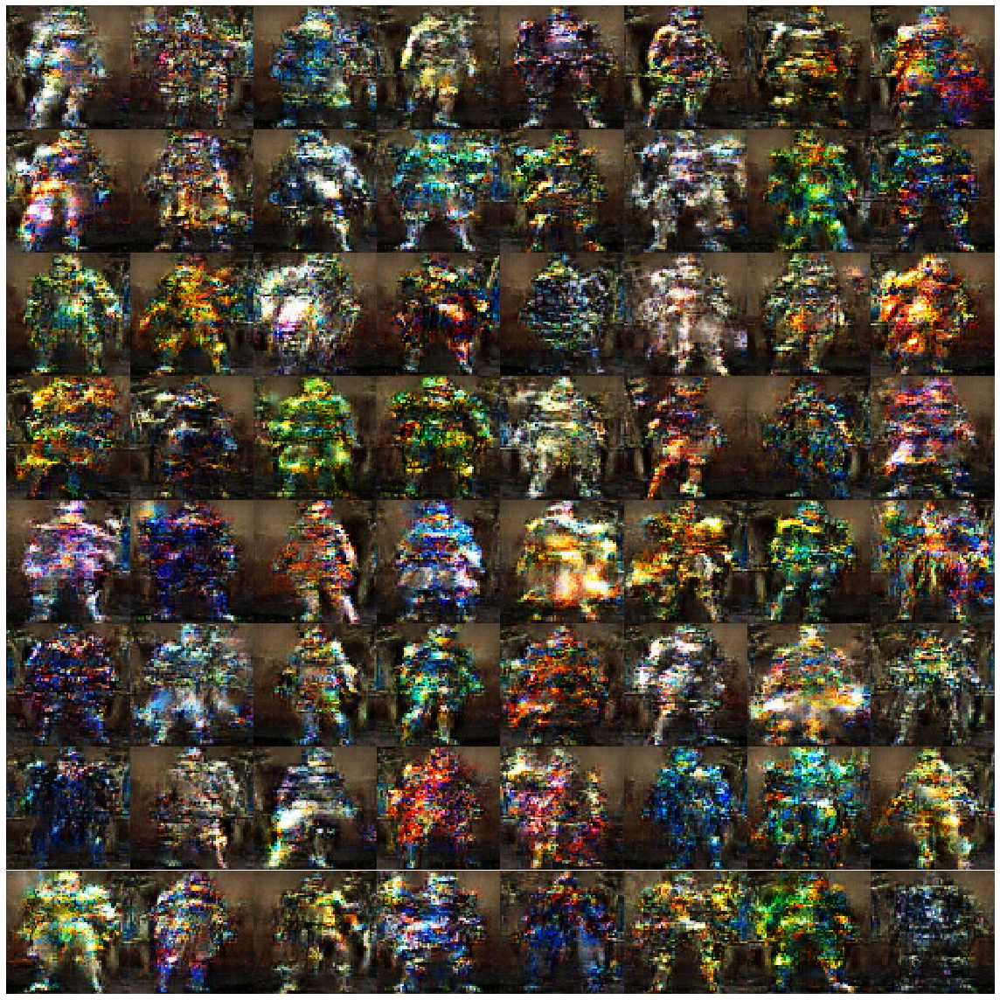

Disc: real loss: 0.338592 fake loss: 0.439520
GAN loss: 2.999028
Step 2000 completed. Time took: 6 secs.
Begin step:  2001
Disc: real loss: 0.592611 fake loss: 0.534432
GAN loss: 2.886833
Step 2001 completed. Time took: 3 secs.
Begin step:  2002
Disc: real loss: 0.385653 fake loss: 0.365882
GAN loss: 2.168648
Step 2002 completed. Time took: 3 secs.
Begin step:  2003
Disc: real loss: 0.351571 fake loss: 0.437985
GAN loss: 3.242723
Step 2003 completed. Time took: 3 secs.
Begin step:  2004
Disc: real loss: 0.490210 fake loss: 0.363756
GAN loss: 2.454146
Step 2004 completed. Time took: 3 secs.
Begin step:  2005
Disc: real loss: 0.436695 fake loss: 0.370368
GAN loss: 2.415229
Step 2005 completed. Time took: 3 secs.
Begin step:  2006
Disc: real loss: 0.383213 fake loss: 0.377343
GAN loss: 2.492830
Step 2006 completed. Time took: 3 secs.
Begin step:  2007
Disc: real loss: 0.410404 fake loss: 0.399250
GAN loss: 2.249828
Step 2007 completed. Time took: 3 secs.
Begin step:  2008
Disc: real loss:

Disc: real loss: 0.366067 fake loss: 0.366756
GAN loss: 2.497140
Step 2067 completed. Time took: 3 secs.
Begin step:  2068
Disc: real loss: 0.375098 fake loss: 0.377931
GAN loss: 2.486923
Step 2068 completed. Time took: 3 secs.
Begin step:  2069
Disc: real loss: 0.329115 fake loss: 0.362331
GAN loss: 2.670527
Step 2069 completed. Time took: 3 secs.
Begin step:  2070
Disc: real loss: 0.363890 fake loss: 0.358275
GAN loss: 2.257066
Step 2070 completed. Time took: 3 secs.
Begin step:  2071
Disc: real loss: 0.346983 fake loss: 0.408257
GAN loss: 2.756028
Step 2071 completed. Time took: 3 secs.
Begin step:  2072
Disc: real loss: 0.400300 fake loss: 0.362932
GAN loss: 2.122017
Step 2072 completed. Time took: 3 secs.
Begin step:  2073
Disc: real loss: 0.326532 fake loss: 0.432303
GAN loss: 3.800236
Step 2073 completed. Time took: 3 secs.
Begin step:  2074
Disc: real loss: 0.643033 fake loss: 0.514546
GAN loss: 2.836466
Step 2074 completed. Time took: 3 secs.
Begin step:  2075
Disc: real loss:

Disc: real loss: 0.407954 fake loss: 0.358725
GAN loss: 2.301402
Step 2134 completed. Time took: 3 secs.
Begin step:  2135
Disc: real loss: 0.366200 fake loss: 0.404866
GAN loss: 3.015249
Step 2135 completed. Time took: 3 secs.
Begin step:  2136
Disc: real loss: 0.434254 fake loss: 0.399337
GAN loss: 2.080882
Step 2136 completed. Time took: 3 secs.
Begin step:  2137
Disc: real loss: 0.354459 fake loss: 0.397814
GAN loss: 2.406556
Step 2137 completed. Time took: 3 secs.
Begin step:  2138
Disc: real loss: 0.325403 fake loss: 0.383567
GAN loss: 2.871453
Step 2138 completed. Time took: 3 secs.
Begin step:  2139
Disc: real loss: 0.409841 fake loss: 0.520680
GAN loss: 4.101408
Step 2139 completed. Time took: 3 secs.
Begin step:  2140
Disc: real loss: 0.746884 fake loss: 0.537818
GAN loss: 2.707317
Step 2140 completed. Time took: 3 secs.
Begin step:  2141
Disc: real loss: 0.357236 fake loss: 0.437449
GAN loss: 2.753375
Step 2141 completed. Time took: 3 secs.
Begin step:  2142
Disc: real loss:

Disc: real loss: 0.387887 fake loss: 0.370560
GAN loss: 2.301287
Step 2201 completed. Time took: 3 secs.
Begin step:  2202
Disc: real loss: 0.346577 fake loss: 0.389979
GAN loss: 2.968451
Step 2202 completed. Time took: 3 secs.
Begin step:  2203
Disc: real loss: 0.488194 fake loss: 0.476236
GAN loss: 2.700515
Step 2203 completed. Time took: 3 secs.
Begin step:  2204
Disc: real loss: 0.396893 fake loss: 0.402737
GAN loss: 2.935704
Step 2204 completed. Time took: 3 secs.
Begin step:  2205
Disc: real loss: 0.408097 fake loss: 0.376351
GAN loss: 2.416493
Step 2205 completed. Time took: 3 secs.
Begin step:  2206
Disc: real loss: 0.374804 fake loss: 0.367351
GAN loss: 2.845875
Step 2206 completed. Time took: 3 secs.
Begin step:  2207
Disc: real loss: 0.417008 fake loss: 0.393636
GAN loss: 2.725347
Step 2207 completed. Time took: 3 secs.
Begin step:  2208
Disc: real loss: 0.359952 fake loss: 0.395453
GAN loss: 2.209697
Step 2208 completed. Time took: 3 secs.
Begin step:  2209
Disc: real loss:

Disc: real loss: 0.346951 fake loss: 0.438094
GAN loss: 3.138210
Step 2268 completed. Time took: 3 secs.
Begin step:  2269
Disc: real loss: 0.514727 fake loss: 0.403688
GAN loss: 2.636532
Step 2269 completed. Time took: 3 secs.
Begin step:  2270
Disc: real loss: 0.387404 fake loss: 0.398730
GAN loss: 2.475701
Step 2270 completed. Time took: 3 secs.
Begin step:  2271
Disc: real loss: 0.359972 fake loss: 0.434652
GAN loss: 3.646252
Step 2271 completed. Time took: 3 secs.
Begin step:  2272
Disc: real loss: 0.519062 fake loss: 0.395412
GAN loss: 2.157257
Step 2272 completed. Time took: 3 secs.
Begin step:  2273
Disc: real loss: 0.328937 fake loss: 0.404927
GAN loss: 3.230787
Step 2273 completed. Time took: 3 secs.
Begin step:  2274
Disc: real loss: 0.367739 fake loss: 0.353264
GAN loss: 2.291375
Step 2274 completed. Time took: 3 secs.
Begin step:  2275
Disc: real loss: 0.372483 fake loss: 0.467156
GAN loss: 3.115152
Step 2275 completed. Time took: 3 secs.
Begin step:  2276
Disc: real loss:

Disc: real loss: 0.686539 fake loss: 0.498223
GAN loss: 3.129826
Step 2335 completed. Time took: 3 secs.
Begin step:  2336
Disc: real loss: 0.402889 fake loss: 0.388111
GAN loss: 2.726371
Step 2336 completed. Time took: 3 secs.
Begin step:  2337
Disc: real loss: 0.382924 fake loss: 0.384951
GAN loss: 2.405026
Step 2337 completed. Time took: 3 secs.
Begin step:  2338
Disc: real loss: 0.382887 fake loss: 0.355462
GAN loss: 2.610503
Step 2338 completed. Time took: 3 secs.
Begin step:  2339
Disc: real loss: 0.404947 fake loss: 0.398170
GAN loss: 2.286144
Step 2339 completed. Time took: 3 secs.
Begin step:  2340
Disc: real loss: 0.404907 fake loss: 0.370087
GAN loss: 2.713812
Step 2340 completed. Time took: 3 secs.
Begin step:  2341
Disc: real loss: 0.455919 fake loss: 0.503753
GAN loss: 3.704362
Step 2341 completed. Time took: 3 secs.
Begin step:  2342
Disc: real loss: 0.456106 fake loss: 0.370681
GAN loss: 1.740240
Step 2342 completed. Time took: 3 secs.
Begin step:  2343
Disc: real loss:

Disc: real loss: 0.383254 fake loss: 0.467736
GAN loss: 3.493862
Step 2402 completed. Time took: 3 secs.
Begin step:  2403
Disc: real loss: 0.593744 fake loss: 0.533572
GAN loss: 2.987765
Step 2403 completed. Time took: 3 secs.
Begin step:  2404
Disc: real loss: 0.388974 fake loss: 0.374214
GAN loss: 3.566462
Step 2404 completed. Time took: 3 secs.
Begin step:  2405
Disc: real loss: 0.378713 fake loss: 0.347395
GAN loss: 2.160611
Step 2405 completed. Time took: 3 secs.
Begin step:  2406
Disc: real loss: 0.375462 fake loss: 0.392336
GAN loss: 3.282307
Step 2406 completed. Time took: 3 secs.
Begin step:  2407
Disc: real loss: 0.460739 fake loss: 0.492486
GAN loss: 3.468482
Step 2407 completed. Time took: 3 secs.
Begin step:  2408
Disc: real loss: 0.493913 fake loss: 0.347882
GAN loss: 2.021415
Step 2408 completed. Time took: 3 secs.
Begin step:  2409
Disc: real loss: 0.404395 fake loss: 0.360067
GAN loss: 2.954339
Step 2409 completed. Time took: 3 secs.
Begin step:  2410
Disc: real loss:

Disc: real loss: 0.373150 fake loss: 0.341901
GAN loss: 2.297601
Step 2469 completed. Time took: 3 secs.
Begin step:  2470
Disc: real loss: 0.378997 fake loss: 0.469660
GAN loss: 3.202662
Step 2470 completed. Time took: 3 secs.
Begin step:  2471
Disc: real loss: 0.409878 fake loss: 0.377479
GAN loss: 2.263433
Step 2471 completed. Time took: 3 secs.
Begin step:  2472
Disc: real loss: 0.374407 fake loss: 0.397485
GAN loss: 2.966065
Step 2472 completed. Time took: 3 secs.
Begin step:  2473
Disc: real loss: 0.410803 fake loss: 0.341523
GAN loss: 2.376515
Step 2473 completed. Time took: 3 secs.
Begin step:  2474
Disc: real loss: 0.380846 fake loss: 0.458908
GAN loss: 2.925660
Step 2474 completed. Time took: 3 secs.
Begin step:  2475
Disc: real loss: 0.429530 fake loss: 0.358046
GAN loss: 1.934928
Step 2475 completed. Time took: 3 secs.
Begin step:  2476
Disc: real loss: 0.363697 fake loss: 0.434887
GAN loss: 3.238148
Step 2476 completed. Time took: 3 secs.
Begin step:  2477
Disc: real loss:

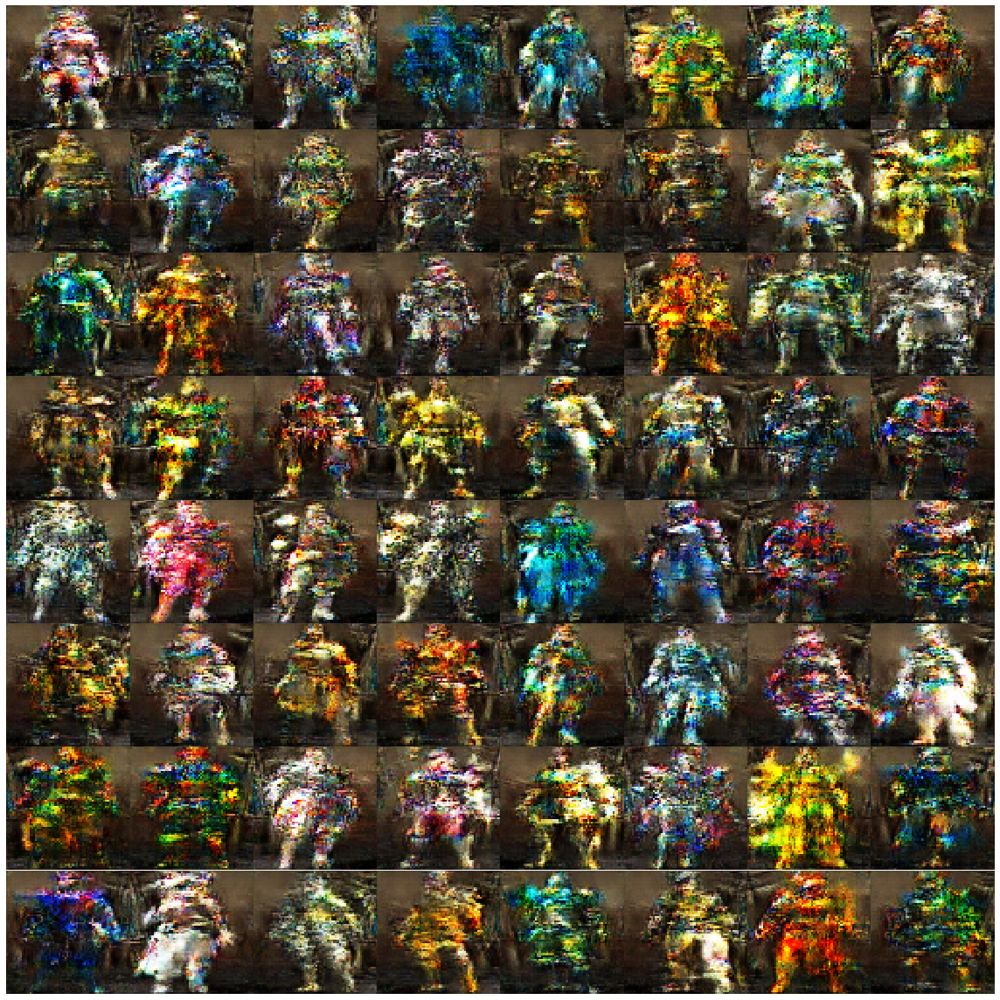

Disc: real loss: 0.379262 fake loss: 0.399871
GAN loss: 2.342108
Step 2500 completed. Time took: 6 secs.
Begin step:  2501
Disc: real loss: 0.378297 fake loss: 0.361488
GAN loss: 2.267353
Step 2501 completed. Time took: 3 secs.
Begin step:  2502
Disc: real loss: 0.421584 fake loss: 0.494528
GAN loss: 4.228656
Step 2502 completed. Time took: 3 secs.
Begin step:  2503
Disc: real loss: 0.684776 fake loss: 0.462144
GAN loss: 2.272186
Step 2503 completed. Time took: 3 secs.
Begin step:  2504
Disc: real loss: 0.319885 fake loss: 0.403308
GAN loss: 2.314759
Step 2504 completed. Time took: 3 secs.
Begin step:  2505
Disc: real loss: 0.374015 fake loss: 0.468229
GAN loss: 3.625703
Step 2505 completed. Time took: 3 secs.
Begin step:  2506
Disc: real loss: 0.628197 fake loss: 0.444032
GAN loss: 2.811828
Step 2506 completed. Time took: 3 secs.
Begin step:  2507
Disc: real loss: 0.386553 fake loss: 0.380607
GAN loss: 2.115007
Step 2507 completed. Time took: 3 secs.
Begin step:  2508
Disc: real loss:

Disc: real loss: 0.392673 fake loss: 0.367407
GAN loss: 2.260639
Step 2567 completed. Time took: 3 secs.
Begin step:  2568
Disc: real loss: 0.366259 fake loss: 0.476182
GAN loss: 3.643903
Step 2568 completed. Time took: 3 secs.
Begin step:  2569
Disc: real loss: 0.569103 fake loss: 0.351991
GAN loss: 1.882772
Step 2569 completed. Time took: 3 secs.
Begin step:  2570
Disc: real loss: 0.414159 fake loss: 0.346011
GAN loss: 2.707491
Step 2570 completed. Time took: 3 secs.
Begin step:  2571
Disc: real loss: 0.409546 fake loss: 0.540152
GAN loss: 3.791004
Step 2571 completed. Time took: 3 secs.
Begin step:  2572
Disc: real loss: 0.531145 fake loss: 0.362336
GAN loss: 2.200731
Step 2572 completed. Time took: 3 secs.
Begin step:  2573
Disc: real loss: 0.422473 fake loss: 0.389504
GAN loss: 3.251904
Step 2573 completed. Time took: 3 secs.
Begin step:  2574
Disc: real loss: 0.452304 fake loss: 0.359101
GAN loss: 2.588128
Step 2574 completed. Time took: 3 secs.
Begin step:  2575
Disc: real loss:

Disc: real loss: 0.391381 fake loss: 0.386998
GAN loss: 2.487280
Step 2634 completed. Time took: 3 secs.
Begin step:  2635
Disc: real loss: 0.378683 fake loss: 0.451401
GAN loss: 2.813547
Step 2635 completed. Time took: 3 secs.
Begin step:  2636
Disc: real loss: 0.390914 fake loss: 0.348532
GAN loss: 2.224727
Step 2636 completed. Time took: 3 secs.
Begin step:  2637
Disc: real loss: 0.355264 fake loss: 0.428313
GAN loss: 3.674225
Step 2637 completed. Time took: 3 secs.
Begin step:  2638
Disc: real loss: 0.498901 fake loss: 0.369609
GAN loss: 1.725896
Step 2638 completed. Time took: 3 secs.
Begin step:  2639
Disc: real loss: 0.402816 fake loss: 0.398691
GAN loss: 3.449395
Step 2639 completed. Time took: 3 secs.
Begin step:  2640
Disc: real loss: 0.497555 fake loss: 0.453754
GAN loss: 3.081689
Step 2640 completed. Time took: 3 secs.
Begin step:  2641
Disc: real loss: 0.378100 fake loss: 0.375790
GAN loss: 2.964499
Step 2641 completed. Time took: 3 secs.
Begin step:  2642
Disc: real loss:

Disc: real loss: 0.408495 fake loss: 0.409807
GAN loss: 2.949670
Step 2701 completed. Time took: 3 secs.
Begin step:  2702
Disc: real loss: 0.374591 fake loss: 0.337550
GAN loss: 2.307003
Step 2702 completed. Time took: 3 secs.
Begin step:  2703
Disc: real loss: 0.358465 fake loss: 0.386600
GAN loss: 2.578261
Step 2703 completed. Time took: 3 secs.
Begin step:  2704
Disc: real loss: 0.392347 fake loss: 0.356522
GAN loss: 1.962839
Step 2704 completed. Time took: 3 secs.
Begin step:  2705
Disc: real loss: 0.335524 fake loss: 0.379222
GAN loss: 3.279298
Step 2705 completed. Time took: 3 secs.
Begin step:  2706
Disc: real loss: 0.472877 fake loss: 0.356897
GAN loss: 1.735058
Step 2706 completed. Time took: 3 secs.
Begin step:  2707
Disc: real loss: 0.356817 fake loss: 0.378032
GAN loss: 3.060578
Step 2707 completed. Time took: 3 secs.
Begin step:  2708
Disc: real loss: 0.383771 fake loss: 0.369231
GAN loss: 1.848955
Step 2708 completed. Time took: 3 secs.
Begin step:  2709
Disc: real loss:

Disc: real loss: 0.388079 fake loss: 0.407025
GAN loss: 2.716013
Step 2768 completed. Time took: 3 secs.
Begin step:  2769
Disc: real loss: 0.393572 fake loss: 0.392791
GAN loss: 2.682321
Step 2769 completed. Time took: 3 secs.
Begin step:  2770
Disc: real loss: 0.353081 fake loss: 0.355323
GAN loss: 2.375901
Step 2770 completed. Time took: 3 secs.
Begin step:  2771
Disc: real loss: 0.370788 fake loss: 0.366574
GAN loss: 1.945029
Step 2771 completed. Time took: 3 secs.
Begin step:  2772
Disc: real loss: 0.345483 fake loss: 0.364938
GAN loss: 2.300122
Step 2772 completed. Time took: 3 secs.
Begin step:  2773
Disc: real loss: 0.384894 fake loss: 0.358944
GAN loss: 2.735195
Step 2773 completed. Time took: 3 secs.
Begin step:  2774
Disc: real loss: 0.401641 fake loss: 0.331337
GAN loss: 1.870441
Step 2774 completed. Time took: 3 secs.
Begin step:  2775
Disc: real loss: 0.364953 fake loss: 0.400578
GAN loss: 3.140586
Step 2775 completed. Time took: 3 secs.
Begin step:  2776
Disc: real loss:

Disc: real loss: 0.350822 fake loss: 0.359349
GAN loss: 2.319677
Step 2835 completed. Time took: 3 secs.
Begin step:  2836
Disc: real loss: 0.349048 fake loss: 0.403703
GAN loss: 2.891577
Step 2836 completed. Time took: 3 secs.
Begin step:  2837
Disc: real loss: 0.394122 fake loss: 0.341426
GAN loss: 2.318529
Step 2837 completed. Time took: 3 secs.
Begin step:  2838
Disc: real loss: 0.337837 fake loss: 0.357684
GAN loss: 2.443409
Step 2838 completed. Time took: 3 secs.
Begin step:  2839
Disc: real loss: 0.345001 fake loss: 0.365867
GAN loss: 2.504495
Step 2839 completed. Time took: 3 secs.
Begin step:  2840
Disc: real loss: 0.378127 fake loss: 0.362178
GAN loss: 2.041599
Step 2840 completed. Time took: 3 secs.
Begin step:  2841
Disc: real loss: 0.353372 fake loss: 0.405677
GAN loss: 2.966509
Step 2841 completed. Time took: 3 secs.
Begin step:  2842
Disc: real loss: 0.406355 fake loss: 0.336238
GAN loss: 2.175377
Step 2842 completed. Time took: 3 secs.
Begin step:  2843
Disc: real loss:

Disc: real loss: 0.411161 fake loss: 0.326273
GAN loss: 1.906275
Step 2902 completed. Time took: 3 secs.
Begin step:  2903
Disc: real loss: 0.364141 fake loss: 0.319049
GAN loss: 2.766483
Step 2903 completed. Time took: 3 secs.
Begin step:  2904
Disc: real loss: 0.361576 fake loss: 0.388831
GAN loss: 2.234909
Step 2904 completed. Time took: 3 secs.
Begin step:  2905
Disc: real loss: 0.328656 fake loss: 0.408183
GAN loss: 2.868078
Step 2905 completed. Time took: 3 secs.
Begin step:  2906
Disc: real loss: 0.407700 fake loss: 0.382216
GAN loss: 1.880746
Step 2906 completed. Time took: 3 secs.
Begin step:  2907
Disc: real loss: 0.321663 fake loss: 0.353333
GAN loss: 2.626302
Step 2907 completed. Time took: 3 secs.
Begin step:  2908
Disc: real loss: 0.389383 fake loss: 0.343358
GAN loss: 2.683406
Step 2908 completed. Time took: 3 secs.
Begin step:  2909
Disc: real loss: 0.406850 fake loss: 0.476466
GAN loss: 3.425752
Step 2909 completed. Time took: 3 secs.
Begin step:  2910
Disc: real loss:

Disc: real loss: 0.341174 fake loss: 0.563180
GAN loss: 4.864569
Step 2969 completed. Time took: 3 secs.
Begin step:  2970
Disc: real loss: 0.798598 fake loss: 0.428434
GAN loss: 1.892350
Step 2970 completed. Time took: 3 secs.
Begin step:  2971
Disc: real loss: 0.378115 fake loss: 0.375702
GAN loss: 2.744377
Step 2971 completed. Time took: 3 secs.
Begin step:  2972
Disc: real loss: 0.433891 fake loss: 0.517040
GAN loss: 3.725432
Step 2972 completed. Time took: 3 secs.
Begin step:  2973
Disc: real loss: 0.406600 fake loss: 0.382336
GAN loss: 2.444738
Step 2973 completed. Time took: 3 secs.
Begin step:  2974
Disc: real loss: 0.396973 fake loss: 0.359531
GAN loss: 3.099696
Step 2974 completed. Time took: 3 secs.
Begin step:  2975
Disc: real loss: 0.429668 fake loss: 0.345609
GAN loss: 1.830895
Step 2975 completed. Time took: 3 secs.
Begin step:  2976
Disc: real loss: 0.406561 fake loss: 0.369130
GAN loss: 2.641109
Step 2976 completed. Time took: 3 secs.
Begin step:  2977
Disc: real loss:

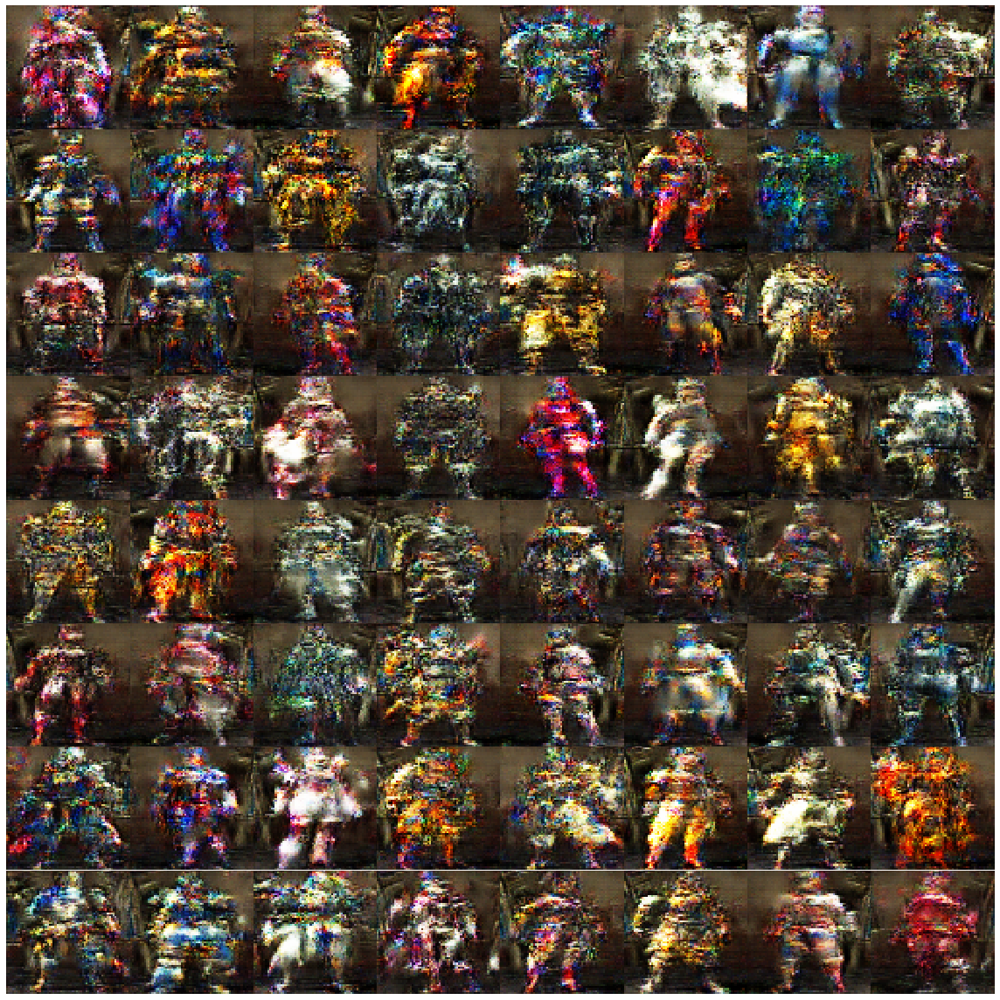

Begin step:  3000


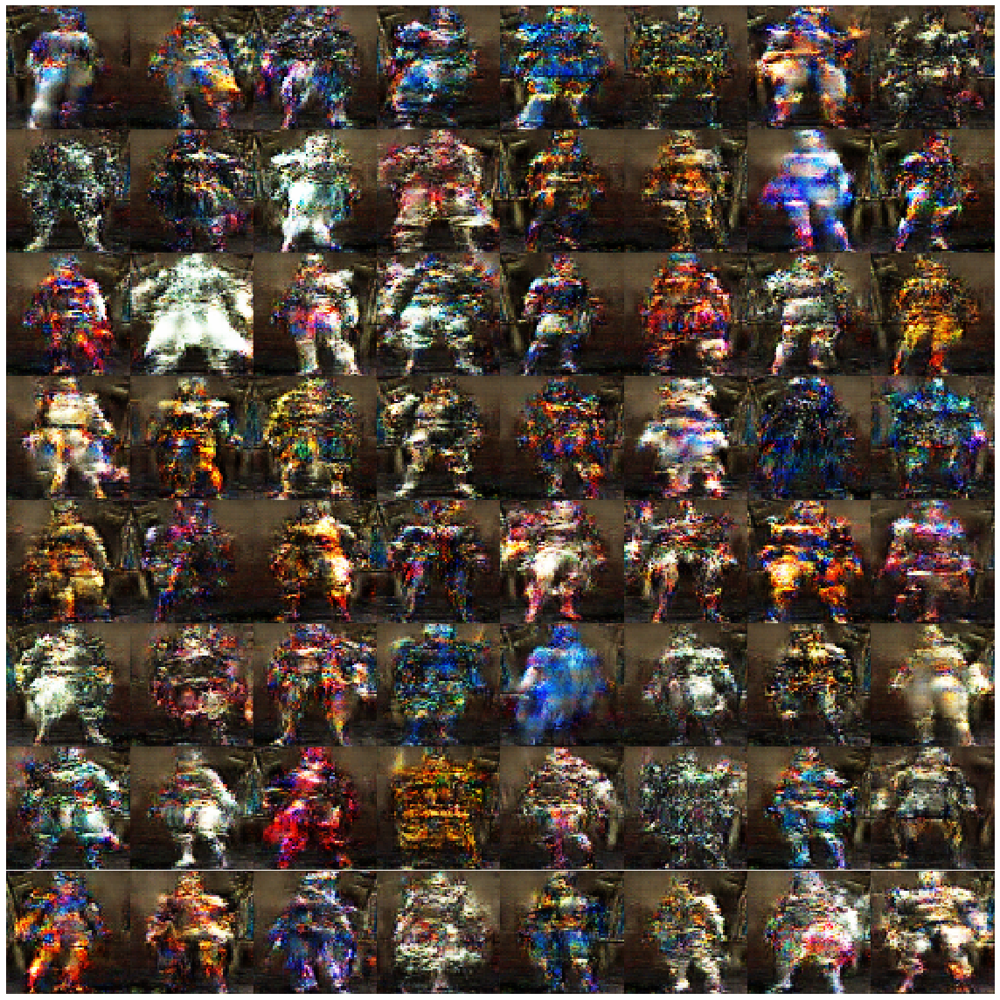

Disc: real loss: 0.384285 fake loss: 0.463629
GAN loss: 3.683436
Step 3000 completed. Time took: 6 secs.
Begin step:  3001
Disc: real loss: 0.442910 fake loss: 0.366167
GAN loss: 2.487122
Step 3001 completed. Time took: 3 secs.
Begin step:  3002
Disc: real loss: 0.347601 fake loss: 0.341972
GAN loss: 2.491459
Step 3002 completed. Time took: 3 secs.
Begin step:  3003
Disc: real loss: 0.378039 fake loss: 0.361228
GAN loss: 2.591329
Step 3003 completed. Time took: 3 secs.
Begin step:  3004
Disc: real loss: 0.406115 fake loss: 0.410053
GAN loss: 2.865085
Step 3004 completed. Time took: 3 secs.
Begin step:  3005
Disc: real loss: 0.395782 fake loss: 0.336845
GAN loss: 2.495962
Step 3005 completed. Time took: 3 secs.
Begin step:  3006
Disc: real loss: 0.319205 fake loss: 0.356103
GAN loss: 3.276118
Step 3006 completed. Time took: 3 secs.
Begin step:  3007
Disc: real loss: 0.429489 fake loss: 0.378701
GAN loss: 1.776795
Step 3007 completed. Time took: 3 secs.
Begin step:  3008
Disc: real loss:

Disc: real loss: 0.347560 fake loss: 0.387754
GAN loss: 2.830058
Step 3067 completed. Time took: 3 secs.
Begin step:  3068
Disc: real loss: 0.418864 fake loss: 0.367615
GAN loss: 2.393225
Step 3068 completed. Time took: 3 secs.
Begin step:  3069
Disc: real loss: 0.365278 fake loss: 0.342383
GAN loss: 2.634130
Step 3069 completed. Time took: 3 secs.
Begin step:  3070
Disc: real loss: 0.386042 fake loss: 0.376773
GAN loss: 2.362482
Step 3070 completed. Time took: 3 secs.
Begin step:  3071
Disc: real loss: 0.327816 fake loss: 0.372947
GAN loss: 2.544759
Step 3071 completed. Time took: 3 secs.
Begin step:  3072
Disc: real loss: 0.406584 fake loss: 0.380965
GAN loss: 2.398222
Step 3072 completed. Time took: 3 secs.
Begin step:  3073
Disc: real loss: 0.338185 fake loss: 0.371308
GAN loss: 3.090466
Step 3073 completed. Time took: 3 secs.
Begin step:  3074
Disc: real loss: 0.438897 fake loss: 0.391394
GAN loss: 2.354257
Step 3074 completed. Time took: 3 secs.
Begin step:  3075
Disc: real loss:

Disc: real loss: 0.467823 fake loss: 0.430550
GAN loss: 3.071400
Step 3134 completed. Time took: 3 secs.
Begin step:  3135
Disc: real loss: 0.324092 fake loss: 0.387104
GAN loss: 2.526195
Step 3135 completed. Time took: 3 secs.
Begin step:  3136
Disc: real loss: 0.332602 fake loss: 0.368418
GAN loss: 2.313467
Step 3136 completed. Time took: 3 secs.
Begin step:  3137
Disc: real loss: 0.351370 fake loss: 0.405625
GAN loss: 2.572798
Step 3137 completed. Time took: 3 secs.
Begin step:  3138
Disc: real loss: 0.381427 fake loss: 0.349472
GAN loss: 1.853546
Step 3138 completed. Time took: 3 secs.
Begin step:  3139
Disc: real loss: 0.364013 fake loss: 0.378487
GAN loss: 3.148353
Step 3139 completed. Time took: 3 secs.
Begin step:  3140
Disc: real loss: 0.501964 fake loss: 0.422504
GAN loss: 2.784761
Step 3140 completed. Time took: 3 secs.
Begin step:  3141
Disc: real loss: 0.350093 fake loss: 0.374430
GAN loss: 2.251870
Step 3141 completed. Time took: 3 secs.
Begin step:  3142
Disc: real loss:

Disc: real loss: 0.389142 fake loss: 0.350251
GAN loss: 2.942545
Step 3201 completed. Time took: 3 secs.
Begin step:  3202
Disc: real loss: 0.398184 fake loss: 0.369259
GAN loss: 2.366500
Step 3202 completed. Time took: 3 secs.
Begin step:  3203
Disc: real loss: 0.325482 fake loss: 0.347695
GAN loss: 2.687910
Step 3203 completed. Time took: 3 secs.
Begin step:  3204
Disc: real loss: 0.349638 fake loss: 0.356708
GAN loss: 2.273248
Step 3204 completed. Time took: 3 secs.
Begin step:  3205
Disc: real loss: 0.362407 fake loss: 0.387013
GAN loss: 2.504914
Step 3205 completed. Time took: 3 secs.
Begin step:  3206
Disc: real loss: 0.394216 fake loss: 0.345285
GAN loss: 2.656917
Step 3206 completed. Time took: 3 secs.
Begin step:  3207
Disc: real loss: 0.386393 fake loss: 0.395493
GAN loss: 2.798902
Step 3207 completed. Time took: 3 secs.
Begin step:  3208
Disc: real loss: 0.392202 fake loss: 0.360180
GAN loss: 2.058257
Step 3208 completed. Time took: 3 secs.
Begin step:  3209
Disc: real loss:

Disc: real loss: 0.340472 fake loss: 0.388473
GAN loss: 2.497110
Step 3268 completed. Time took: 3 secs.
Begin step:  3269
Disc: real loss: 0.401625 fake loss: 0.334551
GAN loss: 2.131017
Step 3269 completed. Time took: 3 secs.
Begin step:  3270
Disc: real loss: 0.401845 fake loss: 0.472616
GAN loss: 3.875403
Step 3270 completed. Time took: 3 secs.
Begin step:  3271
Disc: real loss: 0.576102 fake loss: 0.390457
GAN loss: 2.032652
Step 3271 completed. Time took: 3 secs.
Begin step:  3272
Disc: real loss: 0.401839 fake loss: 0.384065
GAN loss: 2.900470
Step 3272 completed. Time took: 3 secs.
Begin step:  3273
Disc: real loss: 0.380493 fake loss: 0.393078
GAN loss: 2.729078
Step 3273 completed. Time took: 3 secs.
Begin step:  3274
Disc: real loss: 0.344472 fake loss: 0.337632
GAN loss: 2.484804
Step 3274 completed. Time took: 3 secs.
Begin step:  3275
Disc: real loss: 0.361988 fake loss: 0.489860
GAN loss: 3.531052
Step 3275 completed. Time took: 3 secs.
Begin step:  3276
Disc: real loss:

Disc: real loss: 0.344580 fake loss: 0.350847
GAN loss: 2.487679
Step 3335 completed. Time took: 3 secs.
Begin step:  3336
Disc: real loss: 0.364891 fake loss: 0.356494
GAN loss: 2.326017
Step 3336 completed. Time took: 3 secs.
Begin step:  3337
Disc: real loss: 0.383080 fake loss: 0.385563
GAN loss: 2.639582
Step 3337 completed. Time took: 3 secs.
Begin step:  3338
Disc: real loss: 0.395266 fake loss: 0.322232
GAN loss: 2.417946
Step 3338 completed. Time took: 3 secs.
Begin step:  3339
Disc: real loss: 0.406166 fake loss: 0.371559
GAN loss: 2.529281
Step 3339 completed. Time took: 3 secs.
Begin step:  3340
Disc: real loss: 0.342688 fake loss: 0.333723
GAN loss: 2.279454
Step 3340 completed. Time took: 3 secs.
Begin step:  3341
Disc: real loss: 0.351224 fake loss: 0.359633
GAN loss: 2.719811
Step 3341 completed. Time took: 3 secs.
Begin step:  3342
Disc: real loss: 0.358334 fake loss: 0.353771
GAN loss: 2.266144
Step 3342 completed. Time took: 3 secs.
Begin step:  3343
Disc: real loss:

Disc: real loss: 0.332892 fake loss: 0.369481
GAN loss: 2.562271
Step 3402 completed. Time took: 3 secs.
Begin step:  3403
Disc: real loss: 0.375090 fake loss: 0.341010
GAN loss: 2.253995
Step 3403 completed. Time took: 3 secs.
Begin step:  3404
Disc: real loss: 0.377593 fake loss: 0.390282
GAN loss: 3.292475
Step 3404 completed. Time took: 3 secs.
Begin step:  3405
Disc: real loss: 0.405513 fake loss: 0.320215
GAN loss: 2.501315
Step 3405 completed. Time took: 3 secs.
Begin step:  3406
Disc: real loss: 0.352356 fake loss: 0.350475
GAN loss: 2.253026
Step 3406 completed. Time took: 3 secs.
Begin step:  3407
Disc: real loss: 0.349699 fake loss: 0.347387
GAN loss: 3.164169
Step 3407 completed. Time took: 3 secs.
Begin step:  3408
Disc: real loss: 0.411702 fake loss: 0.353810
GAN loss: 2.258765
Step 3408 completed. Time took: 3 secs.
Begin step:  3409
Disc: real loss: 0.388345 fake loss: 0.371317
GAN loss: 2.364874
Step 3409 completed. Time took: 3 secs.
Begin step:  3410
Disc: real loss:

Disc: real loss: 0.355692 fake loss: 0.368634
GAN loss: 2.752095
Step 3469 completed. Time took: 3 secs.
Begin step:  3470
Disc: real loss: 0.439042 fake loss: 0.431731
GAN loss: 2.531919
Step 3470 completed. Time took: 3 secs.
Begin step:  3471
Disc: real loss: 0.392425 fake loss: 0.391734
GAN loss: 2.934192
Step 3471 completed. Time took: 3 secs.
Begin step:  3472
Disc: real loss: 0.385015 fake loss: 0.432122
GAN loss: 2.688309
Step 3472 completed. Time took: 3 secs.
Begin step:  3473
Disc: real loss: 0.409738 fake loss: 0.395860
GAN loss: 2.701109
Step 3473 completed. Time took: 3 secs.
Begin step:  3474
Disc: real loss: 0.431112 fake loss: 0.366181
GAN loss: 1.852678
Step 3474 completed. Time took: 3 secs.
Begin step:  3475
Disc: real loss: 0.366428 fake loss: 0.427787
GAN loss: 3.064609
Step 3475 completed. Time took: 3 secs.
Begin step:  3476
Disc: real loss: 0.408988 fake loss: 0.361366
GAN loss: 2.355189
Step 3476 completed. Time took: 3 secs.
Begin step:  3477
Disc: real loss:

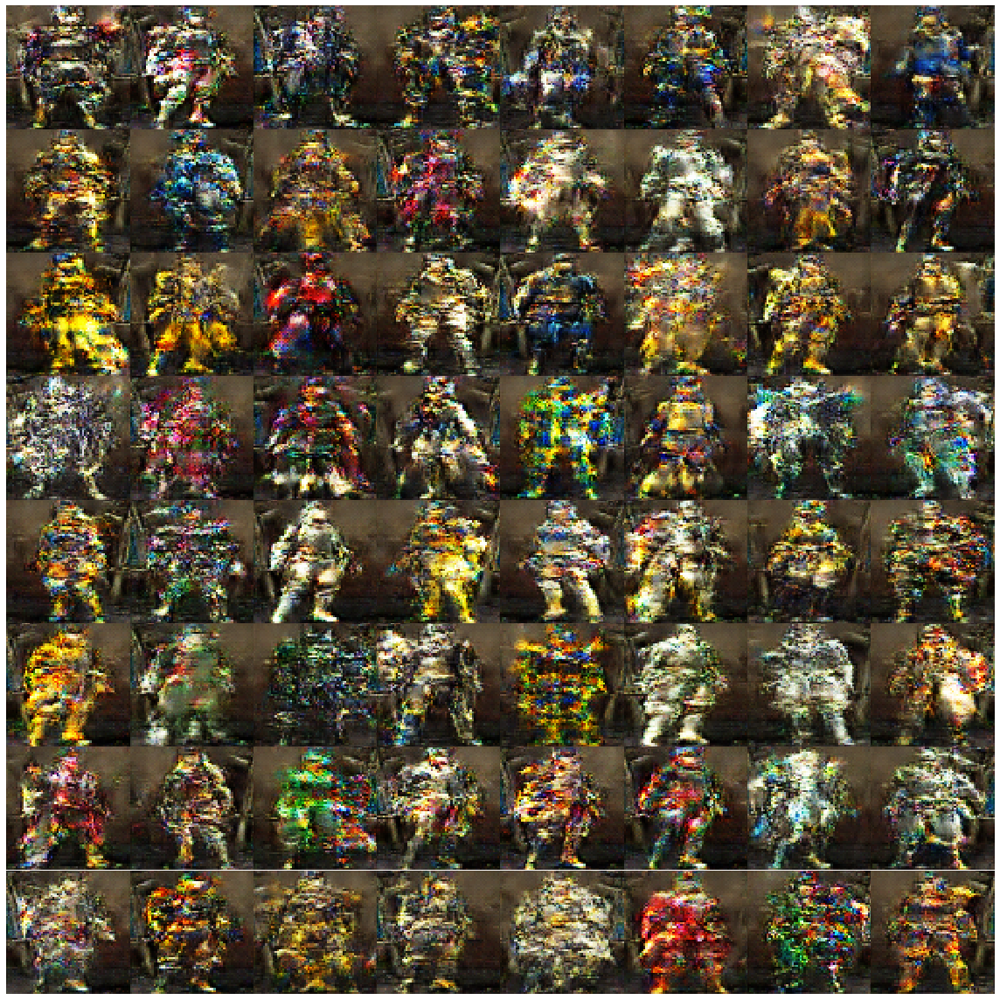

Disc: real loss: 0.407357 fake loss: 0.395811
GAN loss: 2.858752
Step 3500 completed. Time took: 6 secs.
Begin step:  3501
Disc: real loss: 0.405041 fake loss: 0.392765
GAN loss: 2.721707
Step 3501 completed. Time took: 3 secs.
Begin step:  3502
Disc: real loss: 0.393241 fake loss: 0.382743
GAN loss: 2.155663
Step 3502 completed. Time took: 3 secs.
Begin step:  3503
Disc: real loss: 0.353161 fake loss: 0.390642
GAN loss: 2.840524
Step 3503 completed. Time took: 3 secs.
Begin step:  3504
Disc: real loss: 0.391400 fake loss: 0.347239
GAN loss: 2.234719
Step 3504 completed. Time took: 3 secs.
Begin step:  3505
Disc: real loss: 0.347965 fake loss: 0.392460
GAN loss: 2.168377
Step 3505 completed. Time took: 3 secs.
Begin step:  3506
Disc: real loss: 0.345895 fake loss: 0.379673
GAN loss: 2.744118
Step 3506 completed. Time took: 3 secs.
Begin step:  3507
Disc: real loss: 0.429187 fake loss: 0.387600
GAN loss: 2.762125
Step 3507 completed. Time took: 3 secs.
Begin step:  3508
Disc: real loss:

Disc: real loss: 0.352784 fake loss: 0.390509
GAN loss: 3.062860
Step 3567 completed. Time took: 3 secs.
Begin step:  3568
Disc: real loss: 0.423998 fake loss: 0.391501
GAN loss: 2.126740
Step 3568 completed. Time took: 3 secs.
Begin step:  3569
Disc: real loss: 0.387449 fake loss: 0.350587
GAN loss: 2.828051
Step 3569 completed. Time took: 3 secs.
Begin step:  3570
Disc: real loss: 0.407702 fake loss: 0.372962
GAN loss: 2.303545
Step 3570 completed. Time took: 3 secs.
Begin step:  3571
Disc: real loss: 0.349000 fake loss: 0.394513
GAN loss: 2.330080
Step 3571 completed. Time took: 3 secs.
Begin step:  3572
Disc: real loss: 0.373016 fake loss: 0.392842
GAN loss: 2.889866
Step 3572 completed. Time took: 3 secs.
Begin step:  3573
Disc: real loss: 0.366376 fake loss: 0.365883
GAN loss: 1.962586
Step 3573 completed. Time took: 3 secs.
Begin step:  3574
Disc: real loss: 0.338199 fake loss: 0.411255
GAN loss: 3.363392
Step 3574 completed. Time took: 3 secs.
Begin step:  3575
Disc: real loss:

Disc: real loss: 0.493299 fake loss: 0.345642
GAN loss: 2.203624
Step 3634 completed. Time took: 3 secs.
Begin step:  3635
Disc: real loss: 0.362825 fake loss: 0.320613
GAN loss: 2.237071
Step 3635 completed. Time took: 3 secs.
Begin step:  3636
Disc: real loss: 0.373654 fake loss: 0.364619
GAN loss: 2.672732
Step 3636 completed. Time took: 3 secs.
Begin step:  3637
Disc: real loss: 0.401016 fake loss: 0.384509
GAN loss: 2.211354
Step 3637 completed. Time took: 3 secs.
Begin step:  3638
Disc: real loss: 0.344966 fake loss: 0.359567
GAN loss: 2.185755
Step 3638 completed. Time took: 3 secs.
Begin step:  3639
Disc: real loss: 0.356016 fake loss: 0.429475
GAN loss: 2.578081
Step 3639 completed. Time took: 3 secs.
Begin step:  3640
Disc: real loss: 0.387548 fake loss: 0.371387
GAN loss: 2.198319
Step 3640 completed. Time took: 3 secs.
Begin step:  3641
Disc: real loss: 0.330920 fake loss: 0.360695
GAN loss: 2.875809
Step 3641 completed. Time took: 3 secs.
Begin step:  3642
Disc: real loss:

Disc: real loss: 0.359152 fake loss: 0.397047
GAN loss: 2.769970
Step 3701 completed. Time took: 3 secs.
Begin step:  3702
Disc: real loss: 0.363850 fake loss: 0.349563
GAN loss: 2.041574
Step 3702 completed. Time took: 3 secs.
Begin step:  3703
Disc: real loss: 0.339503 fake loss: 0.391731
GAN loss: 2.773308
Step 3703 completed. Time took: 3 secs.
Begin step:  3704
Disc: real loss: 0.417723 fake loss: 0.397591
GAN loss: 2.713552
Step 3704 completed. Time took: 3 secs.
Begin step:  3705
Disc: real loss: 0.376817 fake loss: 0.349239
GAN loss: 2.138003
Step 3705 completed. Time took: 3 secs.
Begin step:  3706
Disc: real loss: 0.329507 fake loss: 0.375587
GAN loss: 2.376125
Step 3706 completed. Time took: 3 secs.
Begin step:  3707
Disc: real loss: 0.331204 fake loss: 0.357775
GAN loss: 2.070687
Step 3707 completed. Time took: 3 secs.
Begin step:  3708
Disc: real loss: 0.364704 fake loss: 0.335865
GAN loss: 2.648511
Step 3708 completed. Time took: 3 secs.
Begin step:  3709
Disc: real loss:

Disc: real loss: 0.362909 fake loss: 0.323966
GAN loss: 2.791781
Step 3768 completed. Time took: 3 secs.
Begin step:  3769
Disc: real loss: 0.430357 fake loss: 0.453752
GAN loss: 2.771307
Step 3769 completed. Time took: 3 secs.
Begin step:  3770
Disc: real loss: 0.368612 fake loss: 0.357298
GAN loss: 2.424221
Step 3770 completed. Time took: 3 secs.
Begin step:  3771
Disc: real loss: 0.331868 fake loss: 0.373990
GAN loss: 2.296226
Step 3771 completed. Time took: 3 secs.
Begin step:  3772
Disc: real loss: 0.342405 fake loss: 0.368797
GAN loss: 2.900079
Step 3772 completed. Time took: 3 secs.
Begin step:  3773
Disc: real loss: 0.383387 fake loss: 0.372904
GAN loss: 2.714777
Step 3773 completed. Time took: 3 secs.
Begin step:  3774
Disc: real loss: 0.420752 fake loss: 0.374980
GAN loss: 2.311523
Step 3774 completed. Time took: 3 secs.
Begin step:  3775
Disc: real loss: 0.348886 fake loss: 0.356726
GAN loss: 2.256119
Step 3775 completed. Time took: 3 secs.
Begin step:  3776
Disc: real loss:

Disc: real loss: 0.342456 fake loss: 0.374303
GAN loss: 2.201083
Step 3835 completed. Time took: 3 secs.
Begin step:  3836
Disc: real loss: 0.350935 fake loss: 0.381719
GAN loss: 2.775454
Step 3836 completed. Time took: 3 secs.
Begin step:  3837
Disc: real loss: 0.382100 fake loss: 0.450728
GAN loss: 2.814818
Step 3837 completed. Time took: 3 secs.
Begin step:  3838
Disc: real loss: 0.391913 fake loss: 0.365349
GAN loss: 2.433926
Step 3838 completed. Time took: 3 secs.
Begin step:  3839
Disc: real loss: 0.364102 fake loss: 0.346615
GAN loss: 2.209175
Step 3839 completed. Time took: 3 secs.
Begin step:  3840
Disc: real loss: 0.370234 fake loss: 0.396754
GAN loss: 2.966932
Step 3840 completed. Time took: 3 secs.
Begin step:  3841
Disc: real loss: 0.411343 fake loss: 0.361249
GAN loss: 2.071609
Step 3841 completed. Time took: 3 secs.
Begin step:  3842
Disc: real loss: 0.374623 fake loss: 0.368232
GAN loss: 2.567984
Step 3842 completed. Time took: 3 secs.
Begin step:  3843
Disc: real loss:

Disc: real loss: 0.394505 fake loss: 0.403036
GAN loss: 2.956710
Step 3902 completed. Time took: 3 secs.
Begin step:  3903
Disc: real loss: 0.416831 fake loss: 0.456997
GAN loss: 3.793151
Step 3903 completed. Time took: 3 secs.
Begin step:  3904
Disc: real loss: 0.367284 fake loss: 0.373659
GAN loss: 2.216776
Step 3904 completed. Time took: 3 secs.
Begin step:  3905
Disc: real loss: 0.343905 fake loss: 0.393483
GAN loss: 2.341610
Step 3905 completed. Time took: 3 secs.
Begin step:  3906
Disc: real loss: 0.339533 fake loss: 0.389900
GAN loss: 2.707438
Step 3906 completed. Time took: 3 secs.
Begin step:  3907
Disc: real loss: 0.390407 fake loss: 0.356880
GAN loss: 2.745822
Step 3907 completed. Time took: 3 secs.
Begin step:  3908
Disc: real loss: 0.416242 fake loss: 0.456326
GAN loss: 3.076606
Step 3908 completed. Time took: 3 secs.
Begin step:  3909
Disc: real loss: 0.387477 fake loss: 0.339357
GAN loss: 2.596703
Step 3909 completed. Time took: 3 secs.
Begin step:  3910
Disc: real loss:

Disc: real loss: 0.401209 fake loss: 0.387190
GAN loss: 2.156075
Step 3969 completed. Time took: 3 secs.
Begin step:  3970
Disc: real loss: 0.416741 fake loss: 0.356588
GAN loss: 2.848503
Step 3970 completed. Time took: 3 secs.
Begin step:  3971
Disc: real loss: 0.370992 fake loss: 0.345907
GAN loss: 1.957663
Step 3971 completed. Time took: 3 secs.
Begin step:  3972
Disc: real loss: 0.333484 fake loss: 0.317768
GAN loss: 2.569062
Step 3972 completed. Time took: 3 secs.
Begin step:  3973
Disc: real loss: 0.349387 fake loss: 0.344352
GAN loss: 2.263608
Step 3973 completed. Time took: 3 secs.
Begin step:  3974
Disc: real loss: 0.353041 fake loss: 0.419831
GAN loss: 3.235458
Step 3974 completed. Time took: 3 secs.
Begin step:  3975
Disc: real loss: 0.460901 fake loss: 0.369615
GAN loss: 1.756608
Step 3975 completed. Time took: 3 secs.
Begin step:  3976
Disc: real loss: 0.336811 fake loss: 0.361148
GAN loss: 2.820622
Step 3976 completed. Time took: 3 secs.
Begin step:  3977
Disc: real loss:

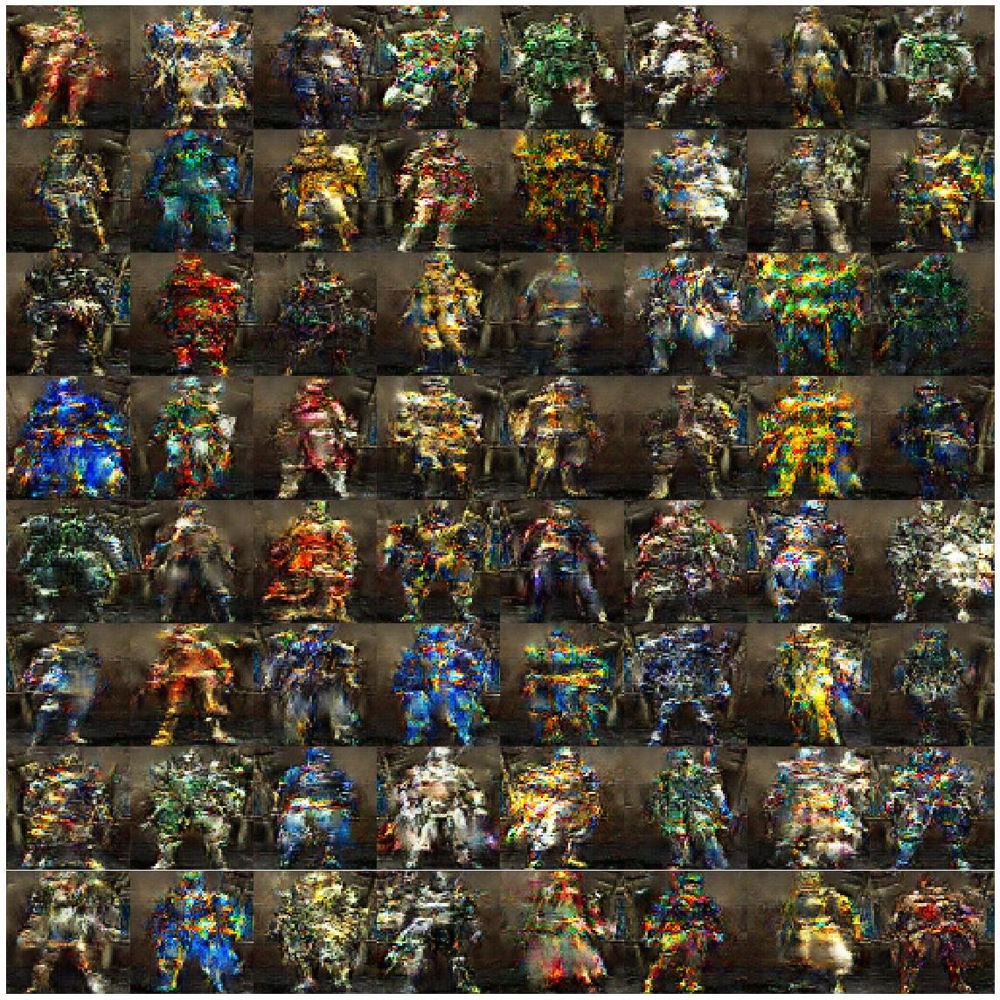

Begin step:  4000


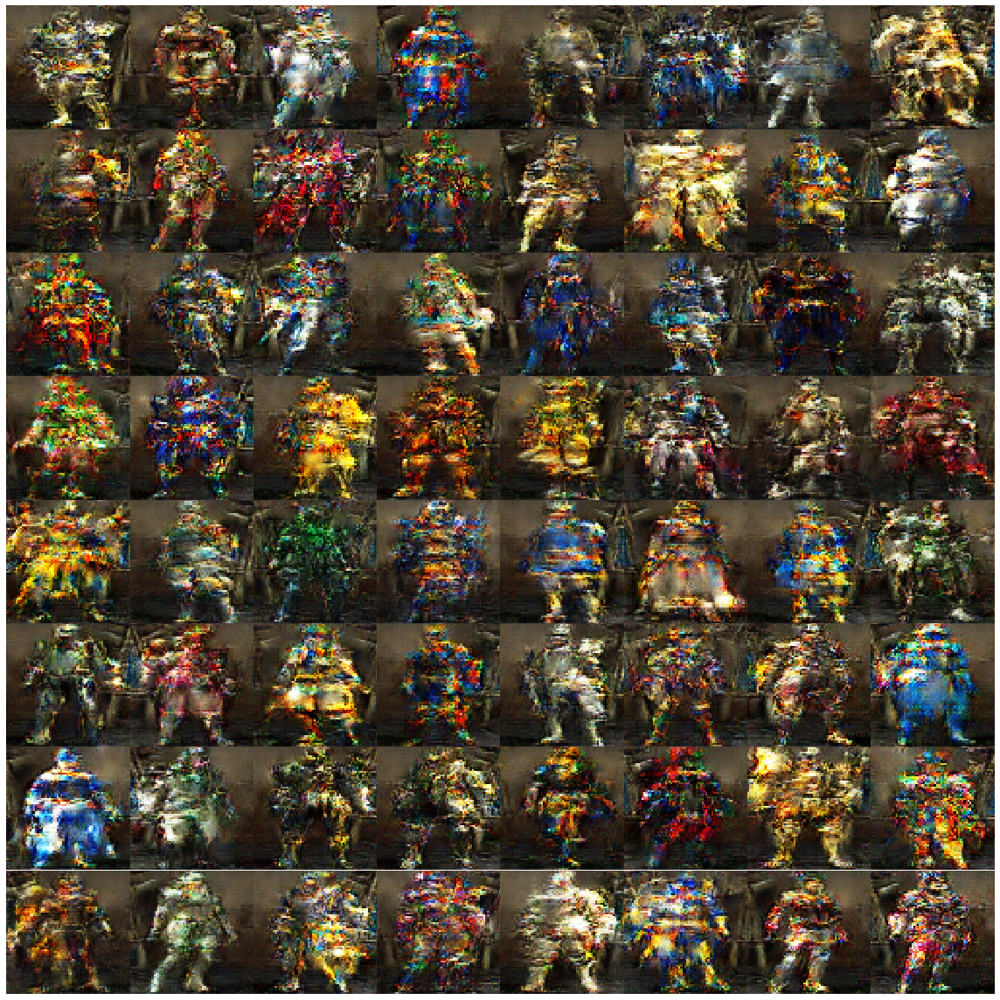

Disc: real loss: 0.509101 fake loss: 0.545042
GAN loss: 3.290786
Step 4000 completed. Time took: 6 secs.
Begin step:  4001
Disc: real loss: 0.364096 fake loss: 0.370524
GAN loss: 2.729126
Step 4001 completed. Time took: 3 secs.
Begin step:  4002
Disc: real loss: 0.339970 fake loss: 0.360191
GAN loss: 3.022173
Step 4002 completed. Time took: 3 secs.
Begin step:  4003
Disc: real loss: 0.368081 fake loss: 0.363614
GAN loss: 2.341034
Step 4003 completed. Time took: 3 secs.
Begin step:  4004
Disc: real loss: 0.345747 fake loss: 0.365860
GAN loss: 2.530581
Step 4004 completed. Time took: 3 secs.
Begin step:  4005
Disc: real loss: 0.353489 fake loss: 0.362191
GAN loss: 2.395231
Step 4005 completed. Time took: 3 secs.
Begin step:  4006
Disc: real loss: 0.358092 fake loss: 0.480010
GAN loss: 3.693614
Step 4006 completed. Time took: 3 secs.
Begin step:  4007
Disc: real loss: 0.521501 fake loss: 0.359106
GAN loss: 2.120754
Step 4007 completed. Time took: 3 secs.
Begin step:  4008
Disc: real loss:

Disc: real loss: 0.372357 fake loss: 0.418314
GAN loss: 2.952403
Step 4067 completed. Time took: 3 secs.
Begin step:  4068
Disc: real loss: 0.355965 fake loss: 0.379383
GAN loss: 2.491167
Step 4068 completed. Time took: 3 secs.
Begin step:  4069
Disc: real loss: 0.352061 fake loss: 0.419144
GAN loss: 2.557121
Step 4069 completed. Time took: 3 secs.
Begin step:  4070
Disc: real loss: 0.445617 fake loss: 0.458901
GAN loss: 2.529095
Step 4070 completed. Time took: 3 secs.
Begin step:  4071
Disc: real loss: 0.378074 fake loss: 0.364528
GAN loss: 2.369957
Step 4071 completed. Time took: 3 secs.
Begin step:  4072
Disc: real loss: 0.414197 fake loss: 0.381333
GAN loss: 2.348200
Step 4072 completed. Time took: 3 secs.
Begin step:  4073
Disc: real loss: 0.445249 fake loss: 0.525231
GAN loss: 2.871474
Step 4073 completed. Time took: 3 secs.
Begin step:  4074
Disc: real loss: 0.432992 fake loss: 0.361895
GAN loss: 2.191145
Step 4074 completed. Time took: 3 secs.
Begin step:  4075
Disc: real loss:

Disc: real loss: 0.378773 fake loss: 0.358811
GAN loss: 2.578992
Step 4134 completed. Time took: 4 secs.
Begin step:  4135
Disc: real loss: 0.370681 fake loss: 0.357363
GAN loss: 2.297906
Step 4135 completed. Time took: 4 secs.
Begin step:  4136
Disc: real loss: 0.341341 fake loss: 0.418803
GAN loss: 2.432183
Step 4136 completed. Time took: 3 secs.
Begin step:  4137
Disc: real loss: 0.359006 fake loss: 0.368796
GAN loss: 2.370648
Step 4137 completed. Time took: 3 secs.
Begin step:  4138
Disc: real loss: 0.405992 fake loss: 0.398691
GAN loss: 2.009842
Step 4138 completed. Time took: 3 secs.
Begin step:  4139
Disc: real loss: 0.367709 fake loss: 0.355238
GAN loss: 2.490201
Step 4139 completed. Time took: 3 secs.
Begin step:  4140
Disc: real loss: 0.392405 fake loss: 0.385692
GAN loss: 2.112394
Step 4140 completed. Time took: 3 secs.
Begin step:  4141
Disc: real loss: 0.346619 fake loss: 0.402638
GAN loss: 2.712522
Step 4141 completed. Time took: 3 secs.
Begin step:  4142
Disc: real loss:

Disc: real loss: 0.348777 fake loss: 0.349096
GAN loss: 2.449184
Step 4201 completed. Time took: 3 secs.
Begin step:  4202
Disc: real loss: 0.355655 fake loss: 0.341774
GAN loss: 2.025934
Step 4202 completed. Time took: 3 secs.
Begin step:  4203
Disc: real loss: 0.320078 fake loss: 0.350354
GAN loss: 2.528824
Step 4203 completed. Time took: 3 secs.
Begin step:  4204
Disc: real loss: 0.348170 fake loss: 0.342793
GAN loss: 2.431775
Step 4204 completed. Time took: 3 secs.
Begin step:  4205
Disc: real loss: 0.355697 fake loss: 0.360232
GAN loss: 2.311447
Step 4205 completed. Time took: 3 secs.
Begin step:  4206
Disc: real loss: 0.342304 fake loss: 0.338258
GAN loss: 2.489185
Step 4206 completed. Time took: 3 secs.
Begin step:  4207
Disc: real loss: 0.367989 fake loss: 0.362187
GAN loss: 2.172470
Step 4207 completed. Time took: 3 secs.
Begin step:  4208
Disc: real loss: 0.381960 fake loss: 0.359641
GAN loss: 2.395725
Step 4208 completed. Time took: 3 secs.
Begin step:  4209
Disc: real loss:

Disc: real loss: 0.372375 fake loss: 0.347018
GAN loss: 2.578882
Step 4268 completed. Time took: 3 secs.
Begin step:  4269
Disc: real loss: 0.347800 fake loss: 0.327923
GAN loss: 2.460909
Step 4269 completed. Time took: 3 secs.
Begin step:  4270
Disc: real loss: 0.348342 fake loss: 0.378686
GAN loss: 2.633703
Step 4270 completed. Time took: 3 secs.
Begin step:  4271
Disc: real loss: 0.364867 fake loss: 0.384746
GAN loss: 2.467044
Step 4271 completed. Time took: 3 secs.
Begin step:  4272
Disc: real loss: 0.362789 fake loss: 0.444800
GAN loss: 2.901152
Step 4272 completed. Time took: 3 secs.
Begin step:  4273
Disc: real loss: 0.390511 fake loss: 0.347769
GAN loss: 2.017177
Step 4273 completed. Time took: 3 secs.
Begin step:  4274
Disc: real loss: 0.316712 fake loss: 0.357553
GAN loss: 2.923482
Step 4274 completed. Time took: 3 secs.
Begin step:  4275
Disc: real loss: 0.356278 fake loss: 0.339321
GAN loss: 1.953754
Step 4275 completed. Time took: 3 secs.
Begin step:  4276
Disc: real loss:

Disc: real loss: 0.369298 fake loss: 0.336507
GAN loss: 2.489656
Step 4335 completed. Time took: 3 secs.
Begin step:  4336
Disc: real loss: 0.368086 fake loss: 0.343045
GAN loss: 2.039682
Step 4336 completed. Time took: 3 secs.
Begin step:  4337
Disc: real loss: 0.362257 fake loss: 0.388547
GAN loss: 2.355713
Step 4337 completed. Time took: 3 secs.
Begin step:  4338
Disc: real loss: 0.383752 fake loss: 0.347383
GAN loss: 2.507010
Step 4338 completed. Time took: 3 secs.
Begin step:  4339
Disc: real loss: 0.344751 fake loss: 0.350310
GAN loss: 2.473553
Step 4339 completed. Time took: 3 secs.
Begin step:  4340
Disc: real loss: 0.350454 fake loss: 0.374016
GAN loss: 2.090160
Step 4340 completed. Time took: 3 secs.
Begin step:  4341
Disc: real loss: 0.350034 fake loss: 0.356511
GAN loss: 2.969007
Step 4341 completed. Time took: 3 secs.
Begin step:  4342
Disc: real loss: 0.433444 fake loss: 0.396859
GAN loss: 2.822773
Step 4342 completed. Time took: 3 secs.
Begin step:  4343
Disc: real loss:

Disc: real loss: 0.360987 fake loss: 0.346044
GAN loss: 2.232951
Step 4402 completed. Time took: 3 secs.
Begin step:  4403
Disc: real loss: 0.357517 fake loss: 0.313237
GAN loss: 2.425574
Step 4403 completed. Time took: 4 secs.
Begin step:  4404
Disc: real loss: 0.344100 fake loss: 0.382056
GAN loss: 2.884475
Step 4404 completed. Time took: 3 secs.
Begin step:  4405
Disc: real loss: 0.413691 fake loss: 0.411462
GAN loss: 2.788260
Step 4405 completed. Time took: 3 secs.
Begin step:  4406
Disc: real loss: 0.402706 fake loss: 0.393618
GAN loss: 2.453961
Step 4406 completed. Time took: 3 secs.
Begin step:  4407
Disc: real loss: 0.350080 fake loss: 0.355284
GAN loss: 2.903262
Step 4407 completed. Time took: 3 secs.
Begin step:  4408
Disc: real loss: 0.393048 fake loss: 0.358584
GAN loss: 2.078994
Step 4408 completed. Time took: 3 secs.
Begin step:  4409
Disc: real loss: 0.357065 fake loss: 0.370144
GAN loss: 2.574890
Step 4409 completed. Time took: 3 secs.
Begin step:  4410
Disc: real loss:

Disc: real loss: 0.365568 fake loss: 0.369373
GAN loss: 2.194632
Step 4469 completed. Time took: 3 secs.
Begin step:  4470
Disc: real loss: 0.341428 fake loss: 0.394975
GAN loss: 2.781232
Step 4470 completed. Time took: 3 secs.
Begin step:  4471
Disc: real loss: 0.376075 fake loss: 0.340462
GAN loss: 2.297150
Step 4471 completed. Time took: 3 secs.
Begin step:  4472
Disc: real loss: 0.371278 fake loss: 0.384093
GAN loss: 2.463573
Step 4472 completed. Time took: 3 secs.
Begin step:  4473
Disc: real loss: 0.355678 fake loss: 0.382223
GAN loss: 2.295388
Step 4473 completed. Time took: 3 secs.
Begin step:  4474
Disc: real loss: 0.336078 fake loss: 0.393145
GAN loss: 2.305731
Step 4474 completed. Time took: 3 secs.
Begin step:  4475
Disc: real loss: 0.384733 fake loss: 0.325381
GAN loss: 2.925705
Step 4475 completed. Time took: 3 secs.
Begin step:  4476
Disc: real loss: 0.387709 fake loss: 0.367778
GAN loss: 2.649989
Step 4476 completed. Time took: 3 secs.
Begin step:  4477
Disc: real loss:

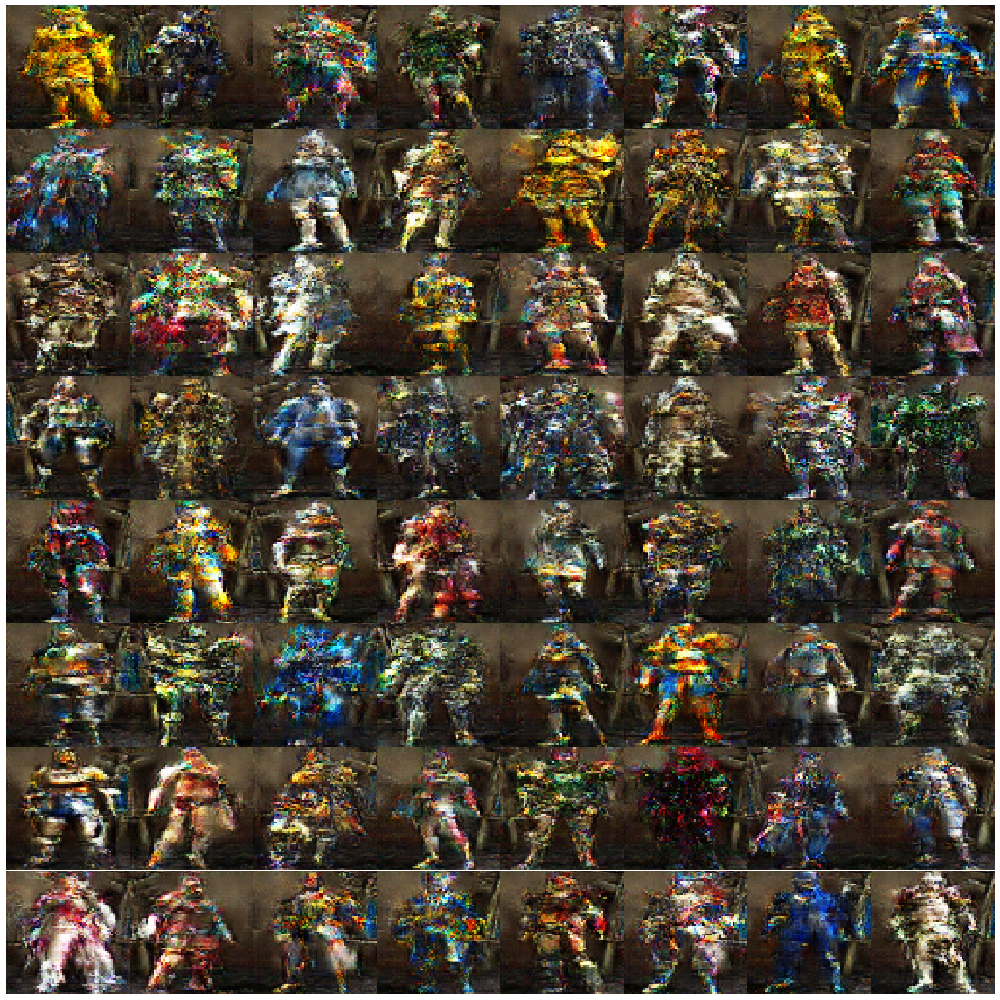

Disc: real loss: 0.376415 fake loss: 0.334710
GAN loss: 2.400720
Step 4500 completed. Time took: 7 secs.
Begin step:  4501
Disc: real loss: 0.340582 fake loss: 0.396972
GAN loss: 3.009228
Step 4501 completed. Time took: 3 secs.
Begin step:  4502
Disc: real loss: 0.517136 fake loss: 0.442597
GAN loss: 3.160575
Step 4502 completed. Time took: 3 secs.
Begin step:  4503
Disc: real loss: 0.422004 fake loss: 0.322488
GAN loss: 2.192041
Step 4503 completed. Time took: 3 secs.
Begin step:  4504
Disc: real loss: 0.373632 fake loss: 0.337313
GAN loss: 2.349523
Step 4504 completed. Time took: 3 secs.
Begin step:  4505
Disc: real loss: 0.371535 fake loss: 0.357994
GAN loss: 3.014480
Step 4505 completed. Time took: 3 secs.
Begin step:  4506
Disc: real loss: 0.373965 fake loss: 0.357534
GAN loss: 2.143177
Step 4506 completed. Time took: 3 secs.
Begin step:  4507
Disc: real loss: 0.341433 fake loss: 0.372609
GAN loss: 2.452560
Step 4507 completed. Time took: 3 secs.
Begin step:  4508
Disc: real loss:

Disc: real loss: 0.399536 fake loss: 0.442439
GAN loss: 2.989737
Step 4567 completed. Time took: 3 secs.
Begin step:  4568
Disc: real loss: 0.342391 fake loss: 0.359003
GAN loss: 2.172997
Step 4568 completed. Time took: 3 secs.
Begin step:  4569
Disc: real loss: 0.356597 fake loss: 0.368763
GAN loss: 2.377867
Step 4569 completed. Time took: 3 secs.
Begin step:  4570
Disc: real loss: 0.352257 fake loss: 0.341920
GAN loss: 2.560821
Step 4570 completed. Time took: 3 secs.
Begin step:  4571
Disc: real loss: 0.364502 fake loss: 0.430959
GAN loss: 2.754520
Step 4571 completed. Time took: 3 secs.
Begin step:  4572
Disc: real loss: 0.355004 fake loss: 0.363546
GAN loss: 2.723101
Step 4572 completed. Time took: 3 secs.
Begin step:  4573
Disc: real loss: 0.383105 fake loss: 0.452479
GAN loss: 2.970881
Step 4573 completed. Time took: 3 secs.
Begin step:  4574
Disc: real loss: 0.362223 fake loss: 0.406408
GAN loss: 2.011417
Step 4574 completed. Time took: 3 secs.
Begin step:  4575
Disc: real loss:

Disc: real loss: 0.375757 fake loss: 0.577209
GAN loss: 4.271853
Step 4634 completed. Time took: 3 secs.
Begin step:  4635
Disc: real loss: 0.861805 fake loss: 0.373304
GAN loss: 1.773733
Step 4635 completed. Time took: 3 secs.
Begin step:  4636
Disc: real loss: 0.374524 fake loss: 0.462941
GAN loss: 2.730502
Step 4636 completed. Time took: 3 secs.
Begin step:  4637
Disc: real loss: 0.422294 fake loss: 0.392630
GAN loss: 2.312949
Step 4637 completed. Time took: 3 secs.
Begin step:  4638
Disc: real loss: 0.376895 fake loss: 0.417201
GAN loss: 2.937837
Step 4638 completed. Time took: 3 secs.
Begin step:  4639
Disc: real loss: 0.421760 fake loss: 0.370242
GAN loss: 2.326401
Step 4639 completed. Time took: 3 secs.
Begin step:  4640
Disc: real loss: 0.364524 fake loss: 0.471668
GAN loss: 3.094633
Step 4640 completed. Time took: 3 secs.
Begin step:  4641
Disc: real loss: 0.459083 fake loss: 0.429583
GAN loss: 2.458745
Step 4641 completed. Time took: 3 secs.
Begin step:  4642
Disc: real loss:

Disc: real loss: 0.341231 fake loss: 0.399965
GAN loss: 2.317235
Step 4701 completed. Time took: 3 secs.
Begin step:  4702
Disc: real loss: 0.401197 fake loss: 0.392621
GAN loss: 2.688349
Step 4702 completed. Time took: 3 secs.
Begin step:  4703
Disc: real loss: 0.376712 fake loss: 0.367019
GAN loss: 2.379682
Step 4703 completed. Time took: 3 secs.
Begin step:  4704
Disc: real loss: 0.324463 fake loss: 0.361249
GAN loss: 2.378676
Step 4704 completed. Time took: 3 secs.
Begin step:  4705
Disc: real loss: 0.327383 fake loss: 0.386133
GAN loss: 2.428597
Step 4705 completed. Time took: 3 secs.
Begin step:  4706
Disc: real loss: 0.386299 fake loss: 0.327250
GAN loss: 2.321692
Step 4706 completed. Time took: 3 secs.
Begin step:  4707
Disc: real loss: 0.356167 fake loss: 0.418047
GAN loss: 2.918377
Step 4707 completed. Time took: 3 secs.
Begin step:  4708
Disc: real loss: 0.395514 fake loss: 0.342095
GAN loss: 2.258647
Step 4708 completed. Time took: 3 secs.
Begin step:  4709
Disc: real loss:

Disc: real loss: 0.364435 fake loss: 0.426946
GAN loss: 2.807474
Step 4768 completed. Time took: 3 secs.
Begin step:  4769
Disc: real loss: 0.388837 fake loss: 0.396211
GAN loss: 2.512240
Step 4769 completed. Time took: 3 secs.
Begin step:  4770
Disc: real loss: 0.343733 fake loss: 0.350579
GAN loss: 2.095682
Step 4770 completed. Time took: 3 secs.
Begin step:  4771
Disc: real loss: 0.357920 fake loss: 0.388274
GAN loss: 2.166766
Step 4771 completed. Time took: 3 secs.
Begin step:  4772
Disc: real loss: 0.350415 fake loss: 0.485020
GAN loss: 3.340872
Step 4772 completed. Time took: 3 secs.
Begin step:  4773
Disc: real loss: 0.482335 fake loss: 0.336405
GAN loss: 2.297023
Step 4773 completed. Time took: 3 secs.
Begin step:  4774
Disc: real loss: 0.375463 fake loss: 0.374620
GAN loss: 2.702210
Step 4774 completed. Time took: 3 secs.
Begin step:  4775
Disc: real loss: 0.367720 fake loss: 0.398253
GAN loss: 2.203765
Step 4775 completed. Time took: 3 secs.
Begin step:  4776
Disc: real loss:

Disc: real loss: 0.348219 fake loss: 0.369426
GAN loss: 2.203691
Step 4835 completed. Time took: 3 secs.
Begin step:  4836
Disc: real loss: 0.351076 fake loss: 0.377002
GAN loss: 2.542366
Step 4836 completed. Time took: 3 secs.
Begin step:  4837
Disc: real loss: 0.349973 fake loss: 0.376327
GAN loss: 2.025774
Step 4837 completed. Time took: 3 secs.
Begin step:  4838
Disc: real loss: 0.335733 fake loss: 0.470589
GAN loss: 3.180526
Step 4838 completed. Time took: 3 secs.
Begin step:  4839
Disc: real loss: 0.486499 fake loss: 0.349923
GAN loss: 1.966857
Step 4839 completed. Time took: 3 secs.
Begin step:  4840
Disc: real loss: 0.345466 fake loss: 0.379139
GAN loss: 2.156075
Step 4840 completed. Time took: 3 secs.
Begin step:  4841
Disc: real loss: 0.337141 fake loss: 0.349509
GAN loss: 2.148691
Step 4841 completed. Time took: 3 secs.
Begin step:  4842
Disc: real loss: 0.339378 fake loss: 0.381241
GAN loss: 1.823770
Step 4842 completed. Time took: 3 secs.
Begin step:  4843
Disc: real loss:

Disc: real loss: 0.354549 fake loss: 0.378623
GAN loss: 2.868963
Step 4902 completed. Time took: 3 secs.
Begin step:  4903
Disc: real loss: 0.408578 fake loss: 0.385716
GAN loss: 2.073033
Step 4903 completed. Time took: 3 secs.
Begin step:  4904
Disc: real loss: 0.346725 fake loss: 0.366901
GAN loss: 2.738272
Step 4904 completed. Time took: 3 secs.
Begin step:  4905
Disc: real loss: 0.371206 fake loss: 0.369734
GAN loss: 1.863923
Step 4905 completed. Time took: 3 secs.
Begin step:  4906
Disc: real loss: 0.333823 fake loss: 0.360235
GAN loss: 2.979702
Step 4906 completed. Time took: 3 secs.
Begin step:  4907
Disc: real loss: 0.384144 fake loss: 0.380857
GAN loss: 1.925045
Step 4907 completed. Time took: 3 secs.
Begin step:  4908
Disc: real loss: 0.333962 fake loss: 0.368673
GAN loss: 2.776504
Step 4908 completed. Time took: 3 secs.
Begin step:  4909
Disc: real loss: 0.379396 fake loss: 0.351274
GAN loss: 2.308757
Step 4909 completed. Time took: 3 secs.
Begin step:  4910
Disc: real loss:

Disc: real loss: 0.358860 fake loss: 0.369093
GAN loss: 2.129281
Step 4969 completed. Time took: 3 secs.
Begin step:  4970
Disc: real loss: 0.356695 fake loss: 0.348840
GAN loss: 3.055768
Step 4970 completed. Time took: 3 secs.
Begin step:  4971
Disc: real loss: 0.363425 fake loss: 0.360440
GAN loss: 2.273702
Step 4971 completed. Time took: 3 secs.
Begin step:  4972
Disc: real loss: 0.346767 fake loss: 0.357426
GAN loss: 2.480131
Step 4972 completed. Time took: 3 secs.
Begin step:  4973
Disc: real loss: 0.332726 fake loss: 0.352881
GAN loss: 2.273233
Step 4973 completed. Time took: 3 secs.
Begin step:  4974
Disc: real loss: 0.377190 fake loss: 0.325585
GAN loss: 2.687255
Step 4974 completed. Time took: 3 secs.
Begin step:  4975
Disc: real loss: 0.347999 fake loss: 0.418880
GAN loss: 1.926585
Step 4975 completed. Time took: 3 secs.
Begin step:  4976
Disc: real loss: 0.326424 fake loss: 0.486404
GAN loss: 3.943503
Step 4976 completed. Time took: 3 secs.
Begin step:  4977
Disc: real loss:

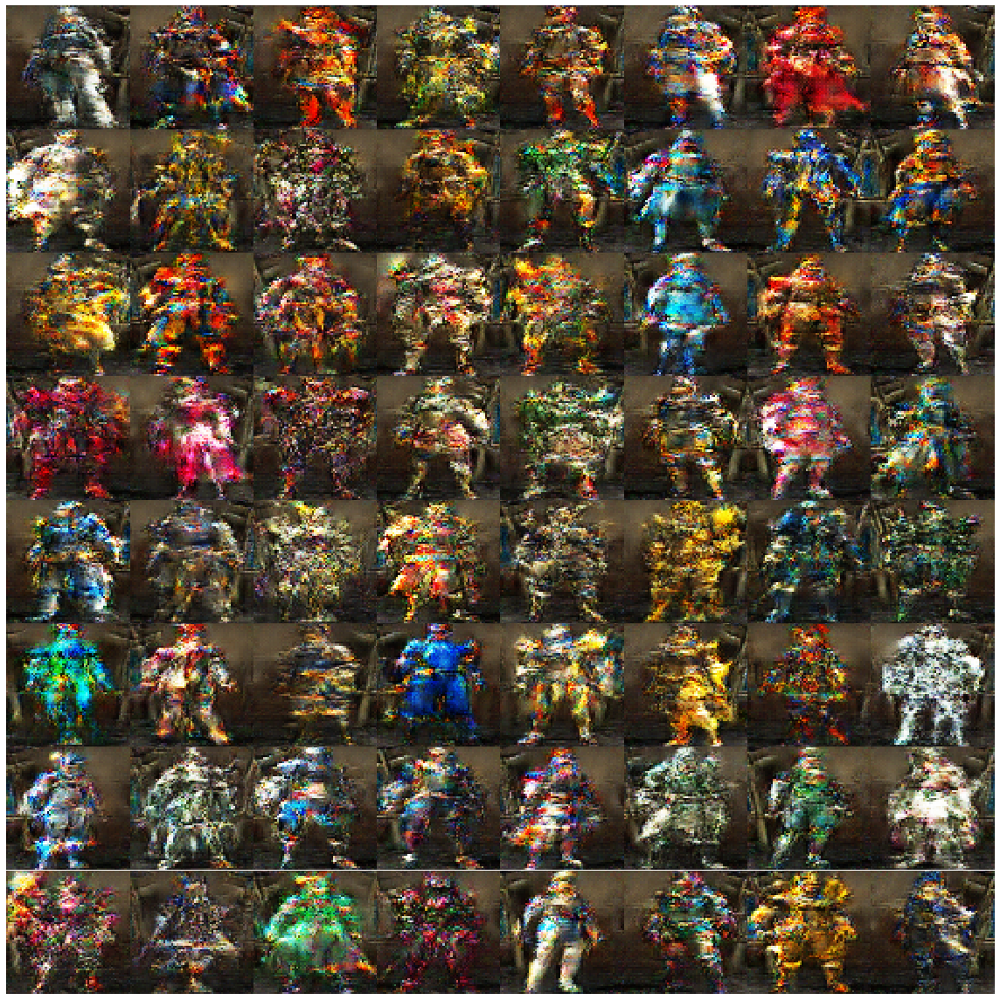

Begin step:  5000


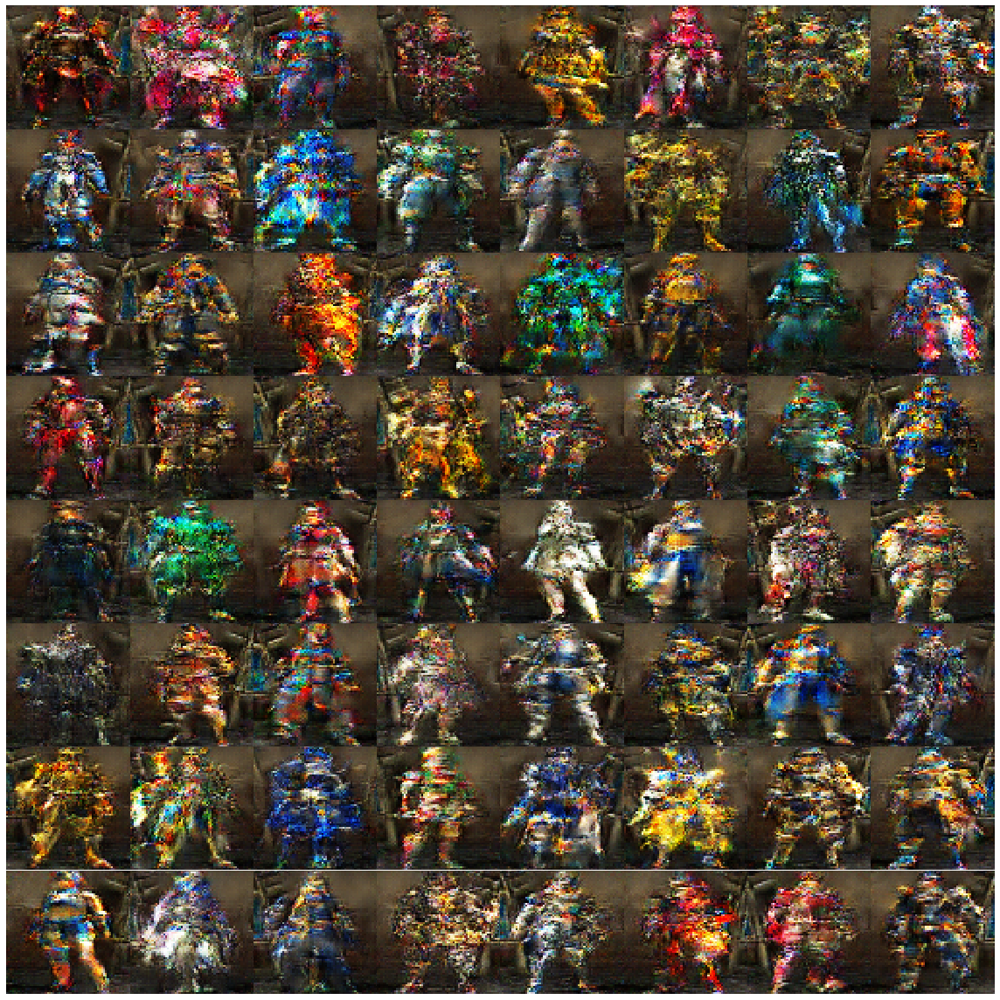

Disc: real loss: 0.338679 fake loss: 0.368609
GAN loss: 2.536040
Step 5000 completed. Time took: 6 secs.
Begin step:  5001
Disc: real loss: 0.340963 fake loss: 0.394085
GAN loss: 1.913080
Step 5001 completed. Time took: 3 secs.
Begin step:  5002
Disc: real loss: 0.342863 fake loss: 0.389193
GAN loss: 2.392678
Step 5002 completed. Time took: 3 secs.
Begin step:  5003
Disc: real loss: 0.379986 fake loss: 0.364667
GAN loss: 2.268228
Step 5003 completed. Time took: 3 secs.
Begin step:  5004
Disc: real loss: 0.346439 fake loss: 0.378837
GAN loss: 2.066107
Step 5004 completed. Time took: 3 secs.
Begin step:  5005
Disc: real loss: 0.329505 fake loss: 0.428382
GAN loss: 3.643188
Step 5005 completed. Time took: 3 secs.
Begin step:  5006
Disc: real loss: 0.506293 fake loss: 0.379231
GAN loss: 1.747202
Step 5006 completed. Time took: 3 secs.
Begin step:  5007
Disc: real loss: 0.421316 fake loss: 0.359392
GAN loss: 2.677865
Step 5007 completed. Time took: 3 secs.
Begin step:  5008
Disc: real loss:

Disc: real loss: 0.352870 fake loss: 0.337411
GAN loss: 2.433114
Step 5067 completed. Time took: 3 secs.
Begin step:  5068
Disc: real loss: 0.366157 fake loss: 0.329875
GAN loss: 2.456086
Step 5068 completed. Time took: 3 secs.
Begin step:  5069
Disc: real loss: 0.391767 fake loss: 0.417460
GAN loss: 2.967453
Step 5069 completed. Time took: 3 secs.
Begin step:  5070
Disc: real loss: 0.430930 fake loss: 0.364063
GAN loss: 2.008884
Step 5070 completed. Time took: 3 secs.
Begin step:  5071
Disc: real loss: 0.364640 fake loss: 0.372665
GAN loss: 2.332820
Step 5071 completed. Time took: 3 secs.
Begin step:  5072
Disc: real loss: 0.389479 fake loss: 0.312871
GAN loss: 2.302048
Step 5072 completed. Time took: 3 secs.
Begin step:  5073
Disc: real loss: 0.350184 fake loss: 0.400976
GAN loss: 2.491268
Step 5073 completed. Time took: 3 secs.
Begin step:  5074
Disc: real loss: 0.348396 fake loss: 0.339388
GAN loss: 2.055477
Step 5074 completed. Time took: 3 secs.
Begin step:  5075
Disc: real loss:

Disc: real loss: 0.390176 fake loss: 0.389010
GAN loss: 2.183930
Step 5134 completed. Time took: 3 secs.
Begin step:  5135
Disc: real loss: 0.359422 fake loss: 0.363201
GAN loss: 2.905003
Step 5135 completed. Time took: 3 secs.
Begin step:  5136
Disc: real loss: 0.403070 fake loss: 0.343703
GAN loss: 2.183144
Step 5136 completed. Time took: 3 secs.
Begin step:  5137
Disc: real loss: 0.381240 fake loss: 0.324815
GAN loss: 2.302824
Step 5137 completed. Time took: 3 secs.
Begin step:  5138
Disc: real loss: 0.376517 fake loss: 0.381757
GAN loss: 2.536500
Step 5138 completed. Time took: 3 secs.
Begin step:  5139
Disc: real loss: 0.325895 fake loss: 0.349172
GAN loss: 2.787935
Step 5139 completed. Time took: 3 secs.
Begin step:  5140
Disc: real loss: 0.386988 fake loss: 0.375070
GAN loss: 2.226413
Step 5140 completed. Time took: 3 secs.
Begin step:  5141
Disc: real loss: 0.361556 fake loss: 0.341959
GAN loss: 2.528968
Step 5141 completed. Time took: 3 secs.
Begin step:  5142
Disc: real loss:

Disc: real loss: 0.357529 fake loss: 0.366802
GAN loss: 2.144157
Step 5201 completed. Time took: 3 secs.
Begin step:  5202
Disc: real loss: 0.370445 fake loss: 0.374340
GAN loss: 2.301309
Step 5202 completed. Time took: 3 secs.
Begin step:  5203
Disc: real loss: 0.335309 fake loss: 0.342119
GAN loss: 2.517293
Step 5203 completed. Time took: 3 secs.
Begin step:  5204
Disc: real loss: 0.366442 fake loss: 0.429040
GAN loss: 3.002084
Step 5204 completed. Time took: 3 secs.
Begin step:  5205
Disc: real loss: 0.368954 fake loss: 0.332241
GAN loss: 2.249317
Step 5205 completed. Time took: 3 secs.
Begin step:  5206
Disc: real loss: 0.352250 fake loss: 0.408527
GAN loss: 2.729831
Step 5206 completed. Time took: 3 secs.
Begin step:  5207
Disc: real loss: 0.324970 fake loss: 0.373843
GAN loss: 2.221773
Step 5207 completed. Time took: 3 secs.
Begin step:  5208
Disc: real loss: 0.335571 fake loss: 0.347952
GAN loss: 2.492340
Step 5208 completed. Time took: 3 secs.
Begin step:  5209
Disc: real loss:

Disc: real loss: 0.379247 fake loss: 0.381549
GAN loss: 2.853801
Step 5268 completed. Time took: 3 secs.
Begin step:  5269
Disc: real loss: 0.382865 fake loss: 0.335251
GAN loss: 2.506405
Step 5269 completed. Time took: 3 secs.
Begin step:  5270
Disc: real loss: 0.361632 fake loss: 0.391624
GAN loss: 1.937702
Step 5270 completed. Time took: 3 secs.
Begin step:  5271
Disc: real loss: 0.354240 fake loss: 0.444125
GAN loss: 3.541860
Step 5271 completed. Time took: 3 secs.
Begin step:  5272
Disc: real loss: 0.581493 fake loss: 0.483210
GAN loss: 3.141929
Step 5272 completed. Time took: 3 secs.
Begin step:  5273
Disc: real loss: 0.357435 fake loss: 0.359515
GAN loss: 2.573884
Step 5273 completed. Time took: 3 secs.
Begin step:  5274
Disc: real loss: 0.360833 fake loss: 0.362152
GAN loss: 2.672980
Step 5274 completed. Time took: 3 secs.
Begin step:  5275
Disc: real loss: 0.379571 fake loss: 0.334989
GAN loss: 2.279083
Step 5275 completed. Time took: 3 secs.
Begin step:  5276
Disc: real loss:

Disc: real loss: 0.366385 fake loss: 0.354667
GAN loss: 2.180681
Step 5335 completed. Time took: 3 secs.
Begin step:  5336
Disc: real loss: 0.382391 fake loss: 0.371302
GAN loss: 2.330464
Step 5336 completed. Time took: 3 secs.
Begin step:  5337
Disc: real loss: 0.331122 fake loss: 0.362296
GAN loss: 2.522438
Step 5337 completed. Time took: 3 secs.
Begin step:  5338
Disc: real loss: 0.366196 fake loss: 0.330775
GAN loss: 2.343686
Step 5338 completed. Time took: 3 secs.
Begin step:  5339
Disc: real loss: 0.362563 fake loss: 0.382438
GAN loss: 2.357801
Step 5339 completed. Time took: 3 secs.
Begin step:  5340
Disc: real loss: 0.373284 fake loss: 0.365746
GAN loss: 2.705361
Step 5340 completed. Time took: 3 secs.
Begin step:  5341
Disc: real loss: 0.370158 fake loss: 0.358985
GAN loss: 2.015336
Step 5341 completed. Time took: 3 secs.
Begin step:  5342
Disc: real loss: 0.367987 fake loss: 0.381227
GAN loss: 2.746300
Step 5342 completed. Time took: 3 secs.
Begin step:  5343
Disc: real loss:

Disc: real loss: 0.338483 fake loss: 0.372133
GAN loss: 2.856603
Step 5402 completed. Time took: 3 secs.
Begin step:  5403
Disc: real loss: 0.341149 fake loss: 0.359735
GAN loss: 2.290499
Step 5403 completed. Time took: 3 secs.
Begin step:  5404
Disc: real loss: 0.356293 fake loss: 0.329321
GAN loss: 2.617631
Step 5404 completed. Time took: 3 secs.
Begin step:  5405
Disc: real loss: 0.354437 fake loss: 0.340335
GAN loss: 2.316031
Step 5405 completed. Time took: 3 secs.
Begin step:  5406
Disc: real loss: 0.343588 fake loss: 0.341705
GAN loss: 2.239066
Step 5406 completed. Time took: 3 secs.
Begin step:  5407
Disc: real loss: 0.354061 fake loss: 0.360792
GAN loss: 2.483803
Step 5407 completed. Time took: 3 secs.
Begin step:  5408
Disc: real loss: 0.341685 fake loss: 0.388763
GAN loss: 2.128870
Step 5408 completed. Time took: 3 secs.
Begin step:  5409
Disc: real loss: 0.332807 fake loss: 0.338104
GAN loss: 2.524623
Step 5409 completed. Time took: 3 secs.
Begin step:  5410
Disc: real loss:

Disc: real loss: 0.338507 fake loss: 0.370034
GAN loss: 2.757400
Step 5469 completed. Time took: 3 secs.
Begin step:  5470
Disc: real loss: 0.375803 fake loss: 0.378138
GAN loss: 2.298207
Step 5470 completed. Time took: 3 secs.
Begin step:  5471
Disc: real loss: 0.345451 fake loss: 0.323302
GAN loss: 2.348585
Step 5471 completed. Time took: 3 secs.
Begin step:  5472
Disc: real loss: 0.341098 fake loss: 0.423210
GAN loss: 3.201023
Step 5472 completed. Time took: 3 secs.
Begin step:  5473
Disc: real loss: 0.358672 fake loss: 0.346111
GAN loss: 2.286572
Step 5473 completed. Time took: 3 secs.
Begin step:  5474
Disc: real loss: 0.398120 fake loss: 0.377999
GAN loss: 2.366855
Step 5474 completed. Time took: 3 secs.
Begin step:  5475
Disc: real loss: 0.354550 fake loss: 0.337888
GAN loss: 2.184244
Step 5475 completed. Time took: 3 secs.
Begin step:  5476
Disc: real loss: 0.385852 fake loss: 0.380125
GAN loss: 2.464434
Step 5476 completed. Time took: 3 secs.
Begin step:  5477
Disc: real loss:

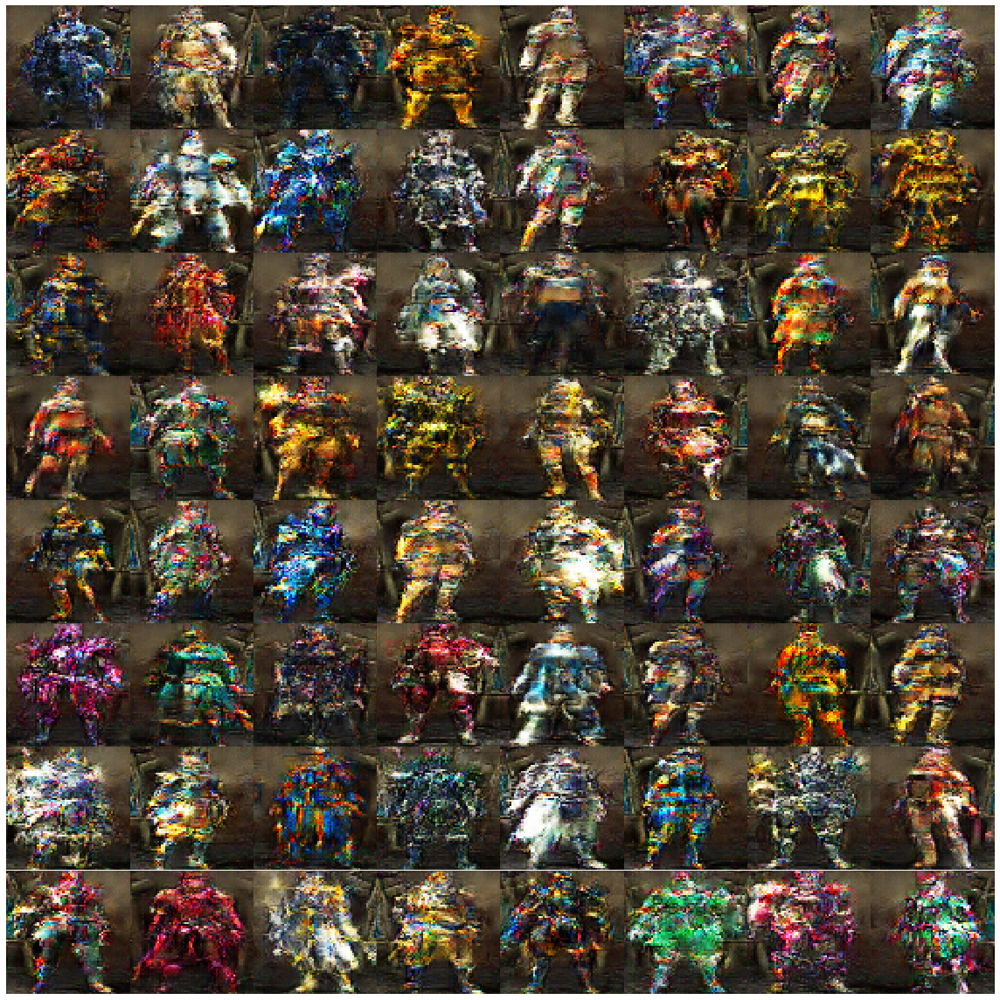

Disc: real loss: 0.384078 fake loss: 0.374845
GAN loss: 2.265713
Step 5500 completed. Time took: 6 secs.
Begin step:  5501
Disc: real loss: 0.350927 fake loss: 0.376749
GAN loss: 2.383895
Step 5501 completed. Time took: 3 secs.
Begin step:  5502
Disc: real loss: 0.329090 fake loss: 0.373157
GAN loss: 2.804473
Step 5502 completed. Time took: 3 secs.
Begin step:  5503
Disc: real loss: 0.335369 fake loss: 0.367162
GAN loss: 2.185946
Step 5503 completed. Time took: 3 secs.
Begin step:  5504
Disc: real loss: 0.333030 fake loss: 0.365575
GAN loss: 2.905932
Step 5504 completed. Time took: 3 secs.
Begin step:  5505
Disc: real loss: 0.365475 fake loss: 0.327013
GAN loss: 2.124958
Step 5505 completed. Time took: 3 secs.
Begin step:  5506
Disc: real loss: 0.356739 fake loss: 0.349427
GAN loss: 3.220287
Step 5506 completed. Time took: 3 secs.
Begin step:  5507
Disc: real loss: 0.443085 fake loss: 0.339002
GAN loss: 1.845492
Step 5507 completed. Time took: 3 secs.
Begin step:  5508
Disc: real loss:

Disc: real loss: 0.340508 fake loss: 0.416877
GAN loss: 3.348172
Step 5567 completed. Time took: 3 secs.
Begin step:  5568
Disc: real loss: 0.397196 fake loss: 0.351188
GAN loss: 2.199158
Step 5568 completed. Time took: 3 secs.
Begin step:  5569
Disc: real loss: 0.387938 fake loss: 0.348822
GAN loss: 2.589563
Step 5569 completed. Time took: 3 secs.
Begin step:  5570
Disc: real loss: 0.366468 fake loss: 0.368058
GAN loss: 2.160777
Step 5570 completed. Time took: 3 secs.
Begin step:  5571
Disc: real loss: 0.347450 fake loss: 0.371543
GAN loss: 2.331128
Step 5571 completed. Time took: 3 secs.
Begin step:  5572
Disc: real loss: 0.350693 fake loss: 0.539104
GAN loss: 4.446109
Step 5572 completed. Time took: 3 secs.
Begin step:  5573
Disc: real loss: 0.901798 fake loss: 0.416646
GAN loss: 2.566325
Step 5573 completed. Time took: 3 secs.
Begin step:  5574
Disc: real loss: 0.448292 fake loss: 0.462397
GAN loss: 4.462938
Step 5574 completed. Time took: 3 secs.
Begin step:  5575
Disc: real loss:

Disc: real loss: 0.343995 fake loss: 0.366772
GAN loss: 2.413941
Step 5634 completed. Time took: 3 secs.
Begin step:  5635
Disc: real loss: 0.371753 fake loss: 0.368906
GAN loss: 2.706765
Step 5635 completed. Time took: 3 secs.
Begin step:  5636
Disc: real loss: 0.404060 fake loss: 0.387582
GAN loss: 1.820849
Step 5636 completed. Time took: 3 secs.
Begin step:  5637
Disc: real loss: 0.356035 fake loss: 0.420340
GAN loss: 2.940603
Step 5637 completed. Time took: 3 secs.
Begin step:  5638
Disc: real loss: 0.436958 fake loss: 0.402385
GAN loss: 2.299347
Step 5638 completed. Time took: 3 secs.
Begin step:  5639
Disc: real loss: 0.323395 fake loss: 0.363390
GAN loss: 2.511335
Step 5639 completed. Time took: 3 secs.
Begin step:  5640
Disc: real loss: 0.373083 fake loss: 0.343716
GAN loss: 2.468870
Step 5640 completed. Time took: 3 secs.
Begin step:  5641
Disc: real loss: 0.380621 fake loss: 0.365819
GAN loss: 2.259712
Step 5641 completed. Time took: 3 secs.
Begin step:  5642
Disc: real loss:

Disc: real loss: 0.392206 fake loss: 0.342997
GAN loss: 2.095752
Step 5701 completed. Time took: 3 secs.
Begin step:  5702
Disc: real loss: 0.356630 fake loss: 0.381264
GAN loss: 2.453084
Step 5702 completed. Time took: 3 secs.
Begin step:  5703
Disc: real loss: 0.334097 fake loss: 0.324706
GAN loss: 2.493267
Step 5703 completed. Time took: 3 secs.
Begin step:  5704
Disc: real loss: 0.346709 fake loss: 0.350492
GAN loss: 2.313311
Step 5704 completed. Time took: 3 secs.
Begin step:  5705
Disc: real loss: 0.353281 fake loss: 0.407247
GAN loss: 2.411480
Step 5705 completed. Time took: 3 secs.
Begin step:  5706
Disc: real loss: 0.353540 fake loss: 0.334691
GAN loss: 2.332698
Step 5706 completed. Time took: 3 secs.
Begin step:  5707
Disc: real loss: 0.336233 fake loss: 0.329503
GAN loss: 2.177518
Step 5707 completed. Time took: 3 secs.
Begin step:  5708
Disc: real loss: 0.320985 fake loss: 0.394837
GAN loss: 2.548233
Step 5708 completed. Time took: 3 secs.
Begin step:  5709
Disc: real loss:

Disc: real loss: 0.353217 fake loss: 0.350682
GAN loss: 2.169643
Step 5768 completed. Time took: 3 secs.
Begin step:  5769
Disc: real loss: 0.359178 fake loss: 0.341251
GAN loss: 3.096664
Step 5769 completed. Time took: 3 secs.
Begin step:  5770
Disc: real loss: 0.431041 fake loss: 0.345539
GAN loss: 2.047411
Step 5770 completed. Time took: 3 secs.
Begin step:  5771
Disc: real loss: 0.383648 fake loss: 0.413324
GAN loss: 2.058625
Step 5771 completed. Time took: 3 secs.
Begin step:  5772
Disc: real loss: 0.309927 fake loss: 0.345272
GAN loss: 2.407179
Step 5772 completed. Time took: 3 secs.
Begin step:  5773
Disc: real loss: 0.346083 fake loss: 0.370444
GAN loss: 2.291403
Step 5773 completed. Time took: 3 secs.
Begin step:  5774
Disc: real loss: 0.374774 fake loss: 0.380359
GAN loss: 2.185915
Step 5774 completed. Time took: 3 secs.
Begin step:  5775
Disc: real loss: 0.327482 fake loss: 0.338302
GAN loss: 2.125051
Step 5775 completed. Time took: 3 secs.
Begin step:  5776
Disc: real loss:

Disc: real loss: 0.377107 fake loss: 0.382973
GAN loss: 2.511324
Step 5835 completed. Time took: 3 secs.
Begin step:  5836
Disc: real loss: 0.375456 fake loss: 0.359274
GAN loss: 2.014403
Step 5836 completed. Time took: 3 secs.
Begin step:  5837
Disc: real loss: 0.305347 fake loss: 0.357410
GAN loss: 3.052355
Step 5837 completed. Time took: 3 secs.
Begin step:  5838
Disc: real loss: 0.365130 fake loss: 0.356076
GAN loss: 2.325644
Step 5838 completed. Time took: 3 secs.
Begin step:  5839
Disc: real loss: 0.344059 fake loss: 0.397242
GAN loss: 2.952670
Step 5839 completed. Time took: 3 secs.
Begin step:  5840
Disc: real loss: 0.402471 fake loss: 0.390464
GAN loss: 1.972558
Step 5840 completed. Time took: 3 secs.
Begin step:  5841
Disc: real loss: 0.326056 fake loss: 0.417836
GAN loss: 3.103943
Step 5841 completed. Time took: 3 secs.
Begin step:  5842
Disc: real loss: 0.377923 fake loss: 0.342369
GAN loss: 2.637531
Step 5842 completed. Time took: 3 secs.
Begin step:  5843
Disc: real loss:

Disc: real loss: 0.366788 fake loss: 0.379581
GAN loss: 1.784528
Step 5902 completed. Time took: 3 secs.
Begin step:  5903
Disc: real loss: 0.362764 fake loss: 0.363979
GAN loss: 2.806324
Step 5903 completed. Time took: 3 secs.
Begin step:  5904
Disc: real loss: 0.406975 fake loss: 0.340727
GAN loss: 2.020149
Step 5904 completed. Time took: 3 secs.
Begin step:  5905
Disc: real loss: 0.362818 fake loss: 0.327778
GAN loss: 2.624747
Step 5905 completed. Time took: 3 secs.
Begin step:  5906
Disc: real loss: 0.371045 fake loss: 0.355876
GAN loss: 1.727382
Step 5906 completed. Time took: 3 secs.
Begin step:  5907
Disc: real loss: 0.337915 fake loss: 0.370415
GAN loss: 2.749185
Step 5907 completed. Time took: 3 secs.
Begin step:  5908
Disc: real loss: 0.460732 fake loss: 0.471298
GAN loss: 3.188467
Step 5908 completed. Time took: 3 secs.
Begin step:  5909
Disc: real loss: 0.352706 fake loss: 0.406850
GAN loss: 2.500061
Step 5909 completed. Time took: 3 secs.
Begin step:  5910
Disc: real loss:

Disc: real loss: 0.361278 fake loss: 0.361440
GAN loss: 2.319220
Step 5969 completed. Time took: 3 secs.
Begin step:  5970
Disc: real loss: 0.336264 fake loss: 0.322180
GAN loss: 2.329397
Step 5970 completed. Time took: 3 secs.
Begin step:  5971
Disc: real loss: 0.314885 fake loss: 0.381292
GAN loss: 2.158123
Step 5971 completed. Time took: 3 secs.
Begin step:  5972
Disc: real loss: 0.340356 fake loss: 0.331687
GAN loss: 2.436194
Step 5972 completed. Time took: 3 secs.
Begin step:  5973
Disc: real loss: 0.346056 fake loss: 0.330743
GAN loss: 2.457155
Step 5973 completed. Time took: 3 secs.
Begin step:  5974
Disc: real loss: 0.354279 fake loss: 0.347520
GAN loss: 2.229146
Step 5974 completed. Time took: 3 secs.
Begin step:  5975
Disc: real loss: 0.293629 fake loss: 0.361766
GAN loss: 2.612134
Step 5975 completed. Time took: 3 secs.
Begin step:  5976
Disc: real loss: 0.360409 fake loss: 0.357283
GAN loss: 2.323598
Step 5976 completed. Time took: 3 secs.
Begin step:  5977
Disc: real loss:

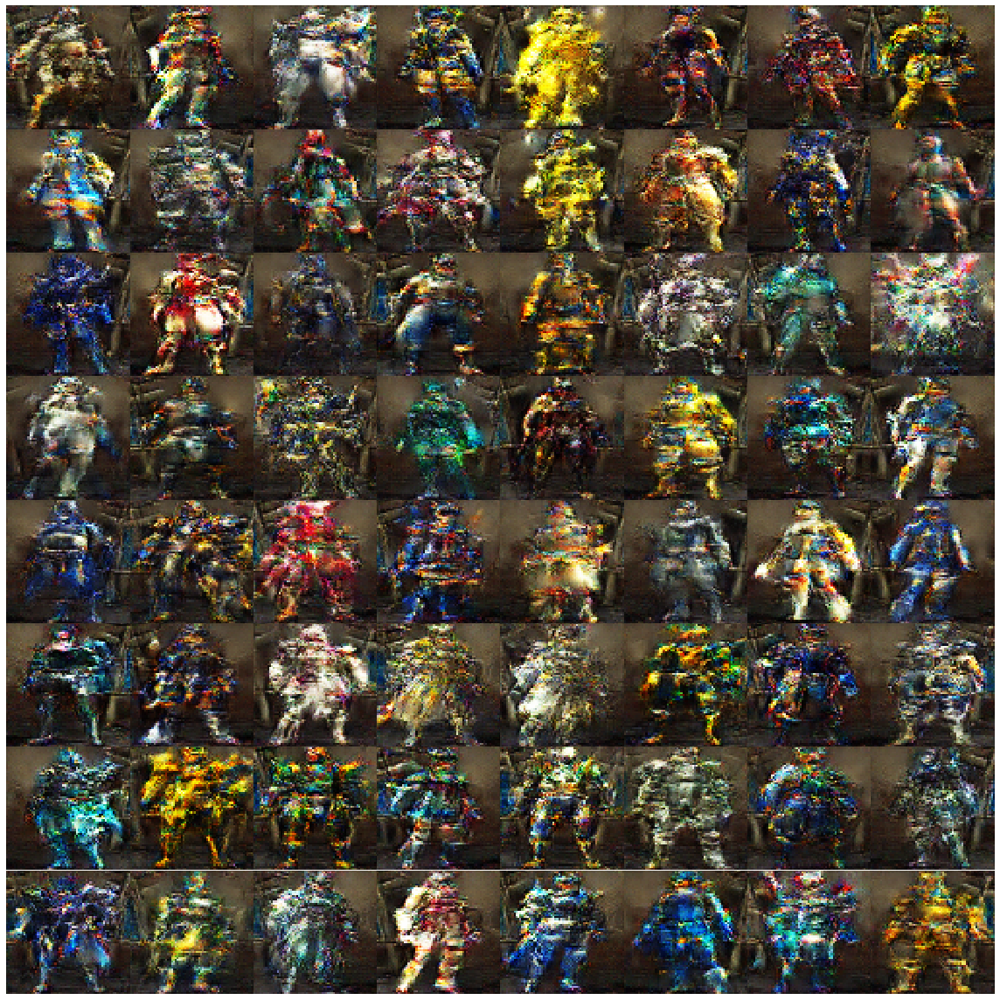

Begin step:  6000


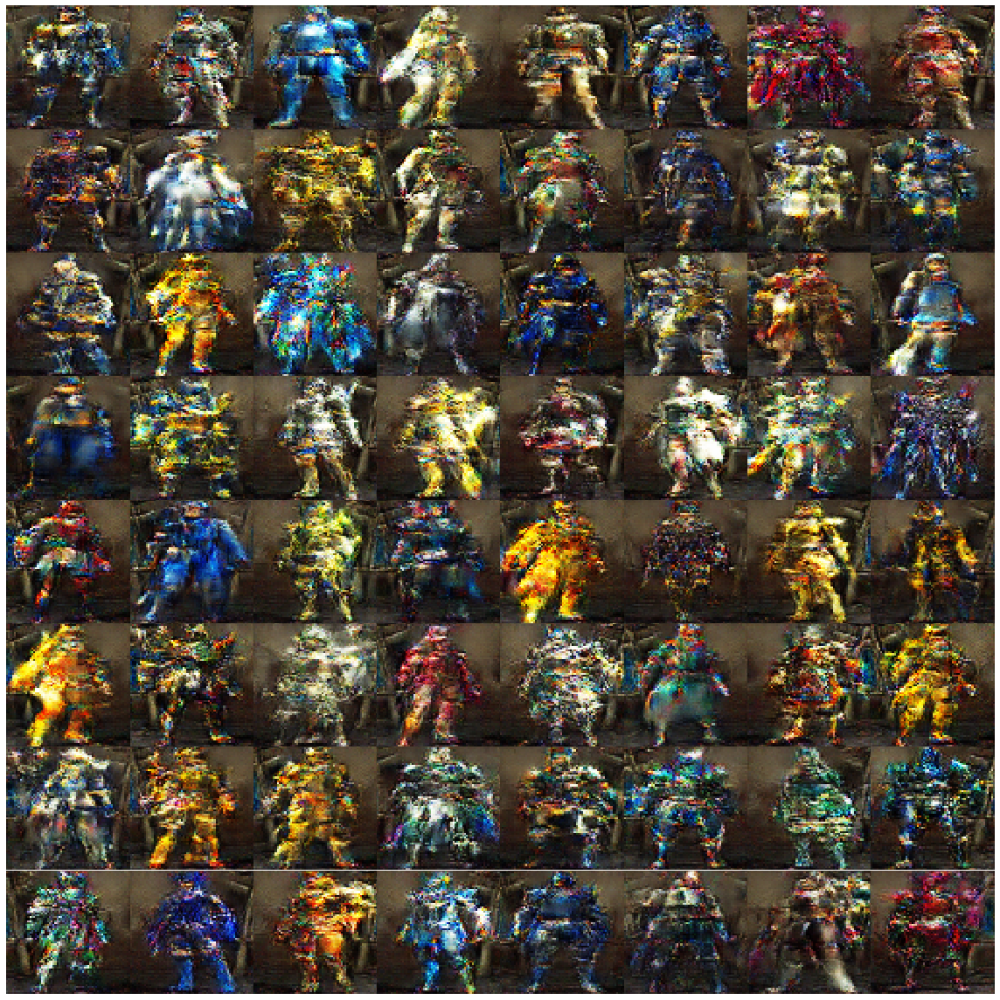

Disc: real loss: 0.373172 fake loss: 0.452791
GAN loss: 4.215176
Step 6000 completed. Time took: 6 secs.
Begin step:  6001
Disc: real loss: 0.600399 fake loss: 0.387230
GAN loss: 2.167681
Step 6001 completed. Time took: 3 secs.
Begin step:  6002
Disc: real loss: 0.379521 fake loss: 0.309718
GAN loss: 2.605301
Step 6002 completed. Time took: 3 secs.
Begin step:  6003
Disc: real loss: 0.335813 fake loss: 0.359275
GAN loss: 2.111077
Step 6003 completed. Time took: 3 secs.
Begin step:  6004
Disc: real loss: 0.351227 fake loss: 0.420075
GAN loss: 2.421511
Step 6004 completed. Time took: 3 secs.
Begin step:  6005
Disc: real loss: 0.352025 fake loss: 0.340707
GAN loss: 2.676588
Step 6005 completed. Time took: 3 secs.
Begin step:  6006
Disc: real loss: 0.342488 fake loss: 0.347090
GAN loss: 2.410631
Step 6006 completed. Time took: 3 secs.
Begin step:  6007
Disc: real loss: 0.390977 fake loss: 0.315362
GAN loss: 2.524751
Step 6007 completed. Time took: 3 secs.
Begin step:  6008
Disc: real loss:

Disc: real loss: 0.349188 fake loss: 0.342216
GAN loss: 2.101642
Step 6067 completed. Time took: 3 secs.
Begin step:  6068
Disc: real loss: 0.347568 fake loss: 0.361858
GAN loss: 2.568368
Step 6068 completed. Time took: 3 secs.
Begin step:  6069
Disc: real loss: 0.354634 fake loss: 0.334553
GAN loss: 2.301985
Step 6069 completed. Time took: 3 secs.
Begin step:  6070
Disc: real loss: 0.351470 fake loss: 0.363559
GAN loss: 2.145631
Step 6070 completed. Time took: 3 secs.
Begin step:  6071
Disc: real loss: 0.362135 fake loss: 0.403480
GAN loss: 2.241175
Step 6071 completed. Time took: 3 secs.
Begin step:  6072
Disc: real loss: 0.346890 fake loss: 0.337978
GAN loss: 2.275148
Step 6072 completed. Time took: 3 secs.
Begin step:  6073
Disc: real loss: 0.329141 fake loss: 0.306012
GAN loss: 2.354017
Step 6073 completed. Time took: 3 secs.
Begin step:  6074
Disc: real loss: 0.336391 fake loss: 0.377582
GAN loss: 2.093612
Step 6074 completed. Time took: 3 secs.
Begin step:  6075
Disc: real loss:

Disc: real loss: 0.390105 fake loss: 0.342192
GAN loss: 2.545941
Step 6134 completed. Time took: 3 secs.
Begin step:  6135
Disc: real loss: 0.331654 fake loss: 0.382428
GAN loss: 2.506329
Step 6135 completed. Time took: 3 secs.
Begin step:  6136
Disc: real loss: 0.335219 fake loss: 0.339735
GAN loss: 2.201499
Step 6136 completed. Time took: 3 secs.
Begin step:  6137
Disc: real loss: 0.353785 fake loss: 0.355962
GAN loss: 2.341437
Step 6137 completed. Time took: 3 secs.
Begin step:  6138
Disc: real loss: 0.382751 fake loss: 0.383640
GAN loss: 2.330477
Step 6138 completed. Time took: 3 secs.
Begin step:  6139
Disc: real loss: 0.342498 fake loss: 0.337879
GAN loss: 2.574107
Step 6139 completed. Time took: 3 secs.
Begin step:  6140
Disc: real loss: 0.369266 fake loss: 0.304482
GAN loss: 2.007028
Step 6140 completed. Time took: 3 secs.
Begin step:  6141
Disc: real loss: 0.377756 fake loss: 0.355631
GAN loss: 2.517688
Step 6141 completed. Time took: 3 secs.
Begin step:  6142
Disc: real loss:

Disc: real loss: 0.338712 fake loss: 0.361056
GAN loss: 2.723589
Step 6201 completed. Time took: 3 secs.
Begin step:  6202
Disc: real loss: 0.366453 fake loss: 0.326850
GAN loss: 2.303399
Step 6202 completed. Time took: 3 secs.
Begin step:  6203
Disc: real loss: 0.341881 fake loss: 0.366426
GAN loss: 2.232302
Step 6203 completed. Time took: 3 secs.
Begin step:  6204
Disc: real loss: 0.353298 fake loss: 0.321477
GAN loss: 2.116160
Step 6204 completed. Time took: 3 secs.
Begin step:  6205
Disc: real loss: 0.347707 fake loss: 0.474213
GAN loss: 3.495672
Step 6205 completed. Time took: 3 secs.
Begin step:  6206
Disc: real loss: 0.389003 fake loss: 0.390115
GAN loss: 2.286720
Step 6206 completed. Time took: 3 secs.
Begin step:  6207
Disc: real loss: 0.354748 fake loss: 0.358649
GAN loss: 2.058298
Step 6207 completed. Time took: 3 secs.
Begin step:  6208
Disc: real loss: 0.382323 fake loss: 0.363328
GAN loss: 2.357850
Step 6208 completed. Time took: 3 secs.
Begin step:  6209
Disc: real loss:

Disc: real loss: 0.359550 fake loss: 0.369026
GAN loss: 2.132126
Step 6268 completed. Time took: 3 secs.
Begin step:  6269
Disc: real loss: 0.350390 fake loss: 0.374002
GAN loss: 2.952909
Step 6269 completed. Time took: 3 secs.
Begin step:  6270
Disc: real loss: 0.437646 fake loss: 0.366784
GAN loss: 1.969618
Step 6270 completed. Time took: 3 secs.
Begin step:  6271
Disc: real loss: 0.351964 fake loss: 0.318539
GAN loss: 2.324306
Step 6271 completed. Time took: 3 secs.
Begin step:  6272
Disc: real loss: 0.346969 fake loss: 0.355284
GAN loss: 2.185768
Step 6272 completed. Time took: 3 secs.
Begin step:  6273
Disc: real loss: 0.365557 fake loss: 0.359220
GAN loss: 2.179029
Step 6273 completed. Time took: 3 secs.
Begin step:  6274
Disc: real loss: 0.315288 fake loss: 0.370948
GAN loss: 2.638401
Step 6274 completed. Time took: 3 secs.
Begin step:  6275
Disc: real loss: 0.338424 fake loss: 0.339614
GAN loss: 1.986704
Step 6275 completed. Time took: 3 secs.
Begin step:  6276
Disc: real loss:

Disc: real loss: 0.360076 fake loss: 0.400193
GAN loss: 2.738735
Step 6335 completed. Time took: 3 secs.
Begin step:  6336
Disc: real loss: 0.396550 fake loss: 0.380877
GAN loss: 2.315797
Step 6336 completed. Time took: 3 secs.
Begin step:  6337
Disc: real loss: 0.322841 fake loss: 0.427830
GAN loss: 2.161623
Step 6337 completed. Time took: 3 secs.
Begin step:  6338
Disc: real loss: 0.369722 fake loss: 0.362016
GAN loss: 2.653515
Step 6338 completed. Time took: 3 secs.
Begin step:  6339
Disc: real loss: 0.357185 fake loss: 0.368134
GAN loss: 2.088497
Step 6339 completed. Time took: 3 secs.
Begin step:  6340
Disc: real loss: 0.333982 fake loss: 0.385464
GAN loss: 2.884035
Step 6340 completed. Time took: 3 secs.
Begin step:  6341
Disc: real loss: 0.435341 fake loss: 0.424056
GAN loss: 2.633598
Step 6341 completed. Time took: 3 secs.
Begin step:  6342
Disc: real loss: 0.369220 fake loss: 0.372179
GAN loss: 2.316556
Step 6342 completed. Time took: 3 secs.
Begin step:  6343
Disc: real loss:

Disc: real loss: 0.410866 fake loss: 0.349976
GAN loss: 2.276137
Step 6402 completed. Time took: 3 secs.
Begin step:  6403
Disc: real loss: 0.374483 fake loss: 0.371329
GAN loss: 2.033893
Step 6403 completed. Time took: 3 secs.
Begin step:  6404
Disc: real loss: 0.348531 fake loss: 0.340376
GAN loss: 2.703124
Step 6404 completed. Time took: 3 secs.
Begin step:  6405
Disc: real loss: 0.361674 fake loss: 0.382007
GAN loss: 2.566072
Step 6405 completed. Time took: 3 secs.
Begin step:  6406
Disc: real loss: 0.360133 fake loss: 0.331734
GAN loss: 2.157218
Step 6406 completed. Time took: 3 secs.
Begin step:  6407
Disc: real loss: 0.352876 fake loss: 0.371669
GAN loss: 2.616904
Step 6407 completed. Time took: 3 secs.
Begin step:  6408
Disc: real loss: 0.356620 fake loss: 0.356235
GAN loss: 2.254155
Step 6408 completed. Time took: 3 secs.
Begin step:  6409
Disc: real loss: 0.367928 fake loss: 0.367297
GAN loss: 1.947383
Step 6409 completed. Time took: 3 secs.
Begin step:  6410
Disc: real loss:

Disc: real loss: 0.359878 fake loss: 0.366759
GAN loss: 2.477157
Step 6469 completed. Time took: 3 secs.
Begin step:  6470
Disc: real loss: 0.354423 fake loss: 0.361716
GAN loss: 2.164212
Step 6470 completed. Time took: 3 secs.
Begin step:  6471
Disc: real loss: 0.334316 fake loss: 0.379344
GAN loss: 2.167521
Step 6471 completed. Time took: 3 secs.
Begin step:  6472
Disc: real loss: 0.345724 fake loss: 0.330675
GAN loss: 2.632498
Step 6472 completed. Time took: 3 secs.
Begin step:  6473
Disc: real loss: 0.356616 fake loss: 0.351392
GAN loss: 2.269331
Step 6473 completed. Time took: 3 secs.
Begin step:  6474
Disc: real loss: 0.345835 fake loss: 0.336794
GAN loss: 2.446540
Step 6474 completed. Time took: 3 secs.
Begin step:  6475
Disc: real loss: 0.332944 fake loss: 0.314421
GAN loss: 2.422596
Step 6475 completed. Time took: 3 secs.
Begin step:  6476
Disc: real loss: 0.353074 fake loss: 0.346138
GAN loss: 2.546348
Step 6476 completed. Time took: 3 secs.
Begin step:  6477
Disc: real loss:

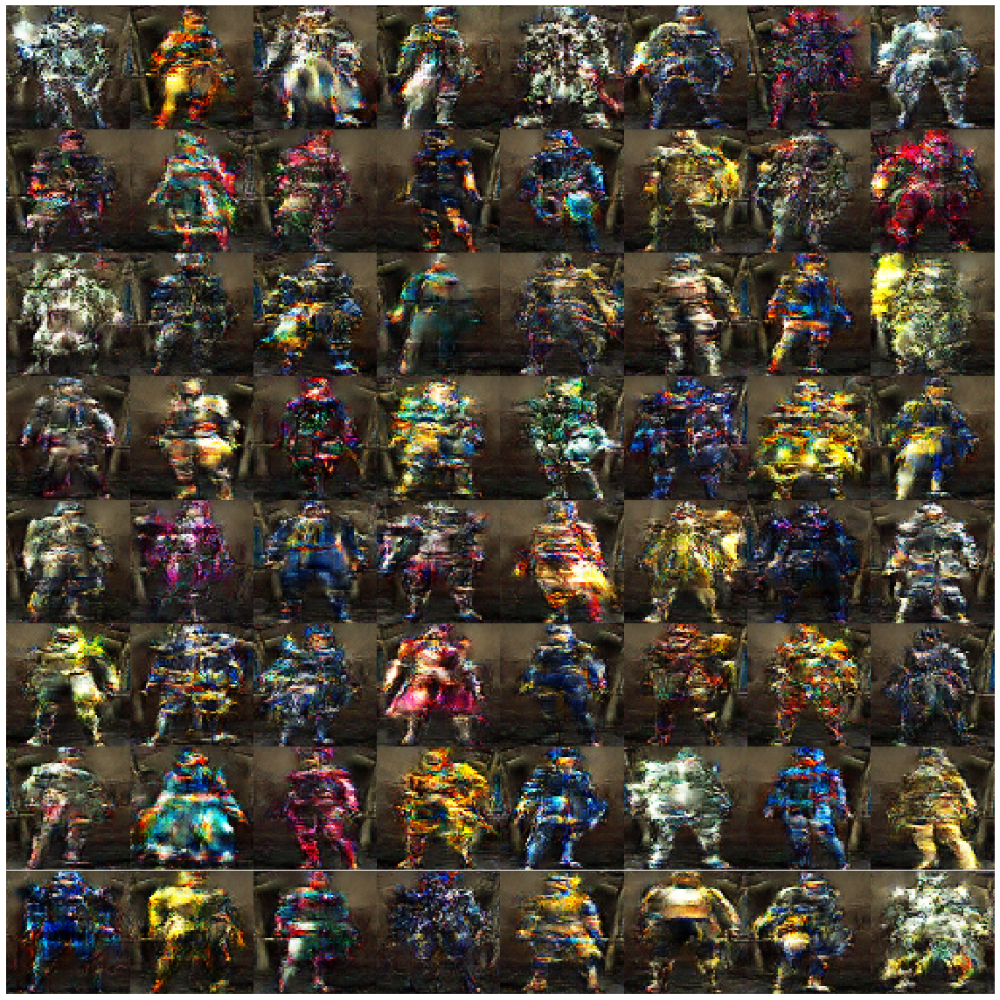

Disc: real loss: 0.345447 fake loss: 0.383069
GAN loss: 2.345549
Step 6500 completed. Time took: 6 secs.
Begin step:  6501
Disc: real loss: 0.346863 fake loss: 0.401005
GAN loss: 2.708692
Step 6501 completed. Time took: 3 secs.
Begin step:  6502
Disc: real loss: 0.382336 fake loss: 0.343274
GAN loss: 2.377185
Step 6502 completed. Time took: 3 secs.
Begin step:  6503
Disc: real loss: 0.340687 fake loss: 0.372181
GAN loss: 2.027806
Step 6503 completed. Time took: 3 secs.
Begin step:  6504
Disc: real loss: 0.348031 fake loss: 0.344597
GAN loss: 2.579053
Step 6504 completed. Time took: 3 secs.
Begin step:  6505
Disc: real loss: 0.333052 fake loss: 0.328914
GAN loss: 2.311905
Step 6505 completed. Time took: 3 secs.
Begin step:  6506
Disc: real loss: 0.360053 fake loss: 0.361810
GAN loss: 2.737676
Step 6506 completed. Time took: 3 secs.
Begin step:  6507
Disc: real loss: 0.375231 fake loss: 0.361335
GAN loss: 2.268490
Step 6507 completed. Time took: 3 secs.
Begin step:  6508
Disc: real loss:

Disc: real loss: 0.346479 fake loss: 0.323074
GAN loss: 2.351698
Step 6567 completed. Time took: 3 secs.
Begin step:  6568
Disc: real loss: 0.358095 fake loss: 0.375502
GAN loss: 2.423073
Step 6568 completed. Time took: 3 secs.
Begin step:  6569
Disc: real loss: 0.355479 fake loss: 0.353464
GAN loss: 2.358326
Step 6569 completed. Time took: 3 secs.
Begin step:  6570
Disc: real loss: 0.354064 fake loss: 0.338406
GAN loss: 2.212810
Step 6570 completed. Time took: 3 secs.
Begin step:  6571
Disc: real loss: 0.350543 fake loss: 0.336326
GAN loss: 2.120120
Step 6571 completed. Time took: 3 secs.
Begin step:  6572
Disc: real loss: 0.352394 fake loss: 0.355356
GAN loss: 2.597407
Step 6572 completed. Time took: 3 secs.
Begin step:  6573
Disc: real loss: 0.378796 fake loss: 0.375886
GAN loss: 2.160309
Step 6573 completed. Time took: 3 secs.
Begin step:  6574
Disc: real loss: 0.343646 fake loss: 0.329064
GAN loss: 2.366716
Step 6574 completed. Time took: 3 secs.
Begin step:  6575
Disc: real loss:

Disc: real loss: 0.320760 fake loss: 0.323733
GAN loss: 2.105123
Step 6634 completed. Time took: 3 secs.
Begin step:  6635
Disc: real loss: 0.344166 fake loss: 0.410885
GAN loss: 3.833779
Step 6635 completed. Time took: 3 secs.
Begin step:  6636
Disc: real loss: 0.570648 fake loss: 0.393220
GAN loss: 2.178627
Step 6636 completed. Time took: 3 secs.
Begin step:  6637
Disc: real loss: 0.400374 fake loss: 0.366042
GAN loss: 2.669089
Step 6637 completed. Time took: 3 secs.
Begin step:  6638
Disc: real loss: 0.395840 fake loss: 0.492707
GAN loss: 3.838212
Step 6638 completed. Time took: 3 secs.
Begin step:  6639
Disc: real loss: 0.385414 fake loss: 0.391944
GAN loss: 2.065261
Step 6639 completed. Time took: 3 secs.
Begin step:  6640
Disc: real loss: 0.404858 fake loss: 0.377606
GAN loss: 3.553774
Step 6640 completed. Time took: 3 secs.
Begin step:  6641
Disc: real loss: 0.458937 fake loss: 0.386906
GAN loss: 2.700588
Step 6641 completed. Time took: 3 secs.
Begin step:  6642
Disc: real loss:

Disc: real loss: 0.361905 fake loss: 0.419261
GAN loss: 2.813669
Step 6701 completed. Time took: 3 secs.
Begin step:  6702
Disc: real loss: 0.337812 fake loss: 0.383991
GAN loss: 2.169951
Step 6702 completed. Time took: 3 secs.
Begin step:  6703
Disc: real loss: 0.341194 fake loss: 0.366576
GAN loss: 2.591721
Step 6703 completed. Time took: 3 secs.
Begin step:  6704
Disc: real loss: 0.370452 fake loss: 0.364604
GAN loss: 1.863977
Step 6704 completed. Time took: 3 secs.
Begin step:  6705
Disc: real loss: 0.366781 fake loss: 0.385847
GAN loss: 2.943617
Step 6705 completed. Time took: 3 secs.
Begin step:  6706
Disc: real loss: 0.385481 fake loss: 0.344986
GAN loss: 2.286382
Step 6706 completed. Time took: 3 secs.
Begin step:  6707
Disc: real loss: 0.359349 fake loss: 0.368010
GAN loss: 2.203411
Step 6707 completed. Time took: 3 secs.
Begin step:  6708
Disc: real loss: 0.345100 fake loss: 0.346586
GAN loss: 2.272750
Step 6708 completed. Time took: 3 secs.
Begin step:  6709
Disc: real loss:

Disc: real loss: 0.342796 fake loss: 0.321759
GAN loss: 2.327420
Step 6768 completed. Time took: 3 secs.
Begin step:  6769
Disc: real loss: 0.366774 fake loss: 0.351177
GAN loss: 2.393463
Step 6769 completed. Time took: 3 secs.
Begin step:  6770
Disc: real loss: 0.361652 fake loss: 0.359297
GAN loss: 2.142584
Step 6770 completed. Time took: 3 secs.
Begin step:  6771
Disc: real loss: 0.331896 fake loss: 0.370913
GAN loss: 2.404562
Step 6771 completed. Time took: 3 secs.
Begin step:  6772
Disc: real loss: 0.348014 fake loss: 0.384505
GAN loss: 2.194529
Step 6772 completed. Time took: 3 secs.
Begin step:  6773
Disc: real loss: 0.376474 fake loss: 0.402414
GAN loss: 2.912092
Step 6773 completed. Time took: 3 secs.
Begin step:  6774
Disc: real loss: 0.397702 fake loss: 0.342895
GAN loss: 1.846965
Step 6774 completed. Time took: 3 secs.
Begin step:  6775
Disc: real loss: 0.352549 fake loss: 0.359033
GAN loss: 2.514851
Step 6775 completed. Time took: 3 secs.
Begin step:  6776
Disc: real loss:

Disc: real loss: 0.350886 fake loss: 0.334023
GAN loss: 2.401424
Step 6835 completed. Time took: 3 secs.
Begin step:  6836
Disc: real loss: 0.389753 fake loss: 0.385797
GAN loss: 2.702528
Step 6836 completed. Time took: 3 secs.
Begin step:  6837
Disc: real loss: 0.340519 fake loss: 0.341357
GAN loss: 2.611739
Step 6837 completed. Time took: 3 secs.
Begin step:  6838
Disc: real loss: 0.370566 fake loss: 0.376729
GAN loss: 2.562203
Step 6838 completed. Time took: 3 secs.
Begin step:  6839
Disc: real loss: 0.312340 fake loss: 0.353183
GAN loss: 2.081548
Step 6839 completed. Time took: 3 secs.
Begin step:  6840
Disc: real loss: 0.329794 fake loss: 0.415876
GAN loss: 3.241132
Step 6840 completed. Time took: 3 secs.
Begin step:  6841
Disc: real loss: 0.468368 fake loss: 0.348176
GAN loss: 1.977541
Step 6841 completed. Time took: 3 secs.
Begin step:  6842
Disc: real loss: 0.394911 fake loss: 0.344296
GAN loss: 2.683429
Step 6842 completed. Time took: 3 secs.
Begin step:  6843
Disc: real loss:

Disc: real loss: 0.340279 fake loss: 0.323906
GAN loss: 2.111526
Step 6902 completed. Time took: 3 secs.
Begin step:  6903
Disc: real loss: 0.337576 fake loss: 0.355702
GAN loss: 2.334054
Step 6903 completed. Time took: 3 secs.
Begin step:  6904
Disc: real loss: 0.342344 fake loss: 0.345884
GAN loss: 2.343428
Step 6904 completed. Time took: 3 secs.
Begin step:  6905
Disc: real loss: 0.337138 fake loss: 0.361216
GAN loss: 2.768405
Step 6905 completed. Time took: 3 secs.
Begin step:  6906
Disc: real loss: 0.341541 fake loss: 0.331721
GAN loss: 2.585994
Step 6906 completed. Time took: 3 secs.
Begin step:  6907
Disc: real loss: 0.338341 fake loss: 0.358016
GAN loss: 2.026916
Step 6907 completed. Time took: 3 secs.
Begin step:  6908
Disc: real loss: 0.313608 fake loss: 0.343983
GAN loss: 2.928642
Step 6908 completed. Time took: 3 secs.
Begin step:  6909
Disc: real loss: 0.355519 fake loss: 0.369496
GAN loss: 2.182101
Step 6909 completed. Time took: 3 secs.
Begin step:  6910
Disc: real loss:

Disc: real loss: 0.526554 fake loss: 0.474465
GAN loss: 2.945132
Step 6969 completed. Time took: 3 secs.
Begin step:  6970
Disc: real loss: 0.390568 fake loss: 0.345732
GAN loss: 2.797589
Step 6970 completed. Time took: 3 secs.
Begin step:  6971
Disc: real loss: 0.444849 fake loss: 0.463859
GAN loss: 3.059032
Step 6971 completed. Time took: 3 secs.
Begin step:  6972
Disc: real loss: 0.449587 fake loss: 0.432117
GAN loss: 2.908864
Step 6972 completed. Time took: 3 secs.
Begin step:  6973
Disc: real loss: 0.375190 fake loss: 0.377663
GAN loss: 2.657622
Step 6973 completed. Time took: 3 secs.
Begin step:  6974
Disc: real loss: 0.390745 fake loss: 0.430430
GAN loss: 2.736203
Step 6974 completed. Time took: 3 secs.
Begin step:  6975
Disc: real loss: 0.371323 fake loss: 0.459209
GAN loss: 3.462295
Step 6975 completed. Time took: 3 secs.
Begin step:  6976
Disc: real loss: 0.556457 fake loss: 0.395822
GAN loss: 2.325759
Step 6976 completed. Time took: 3 secs.
Begin step:  6977
Disc: real loss:

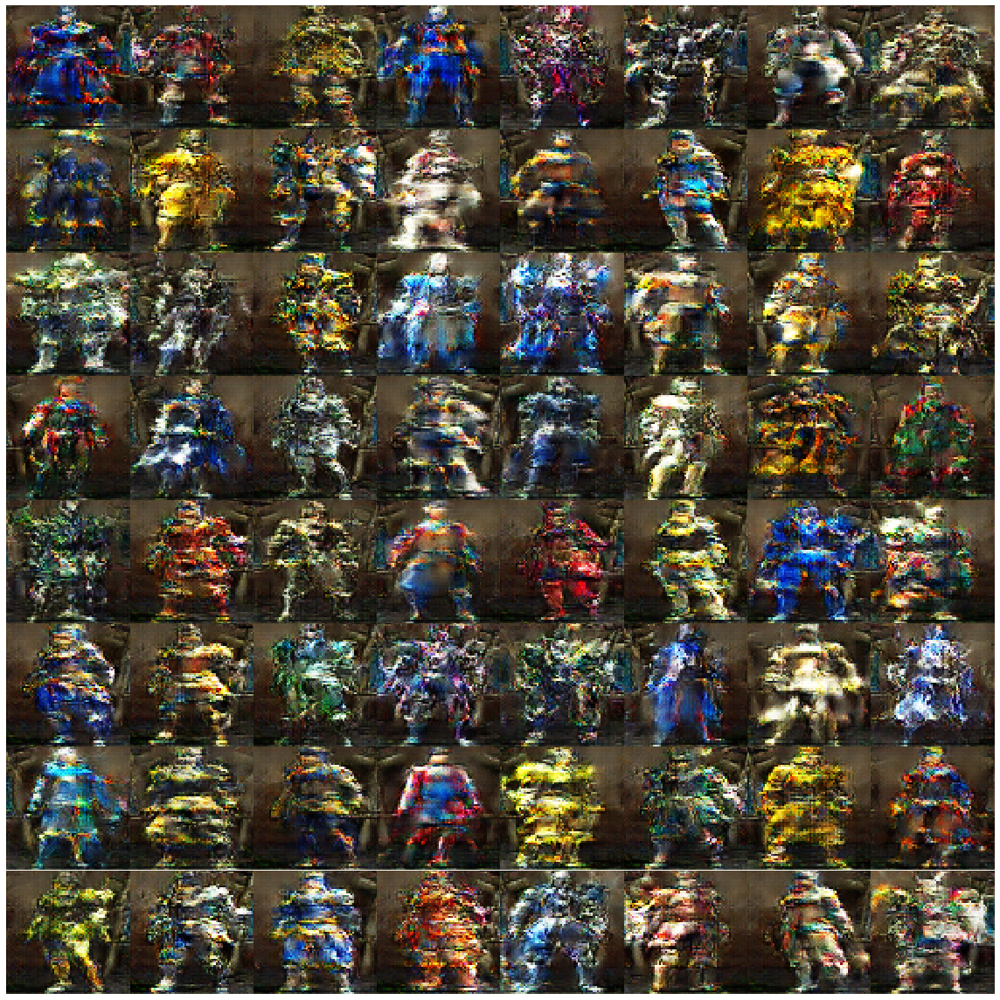

Begin step:  7000


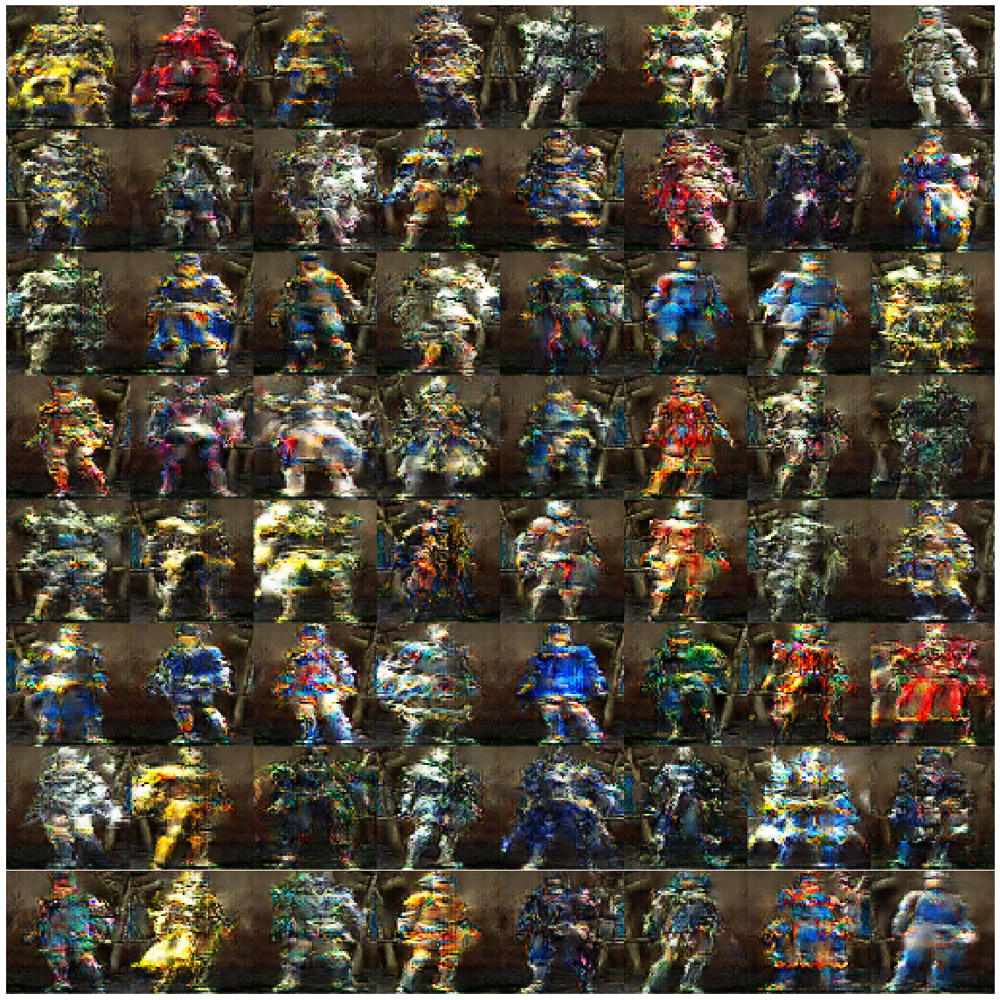

Disc: real loss: 0.411778 fake loss: 0.473387
GAN loss: 3.449266
Step 7000 completed. Time took: 6 secs.
Begin step:  7001
Disc: real loss: 0.505888 fake loss: 0.378608
GAN loss: 2.062959
Step 7001 completed. Time took: 3 secs.
Begin step:  7002
Disc: real loss: 0.357148 fake loss: 0.387075
GAN loss: 2.729025
Step 7002 completed. Time took: 3 secs.
Begin step:  7003
Disc: real loss: 0.363162 fake loss: 0.355649
GAN loss: 2.571599
Step 7003 completed. Time took: 3 secs.
Begin step:  7004
Disc: real loss: 0.395073 fake loss: 0.336342
GAN loss: 2.278791
Step 7004 completed. Time took: 3 secs.
Begin step:  7005
Disc: real loss: 0.352810 fake loss: 0.399835
GAN loss: 2.532388
Step 7005 completed. Time took: 3 secs.
Begin step:  7006
Disc: real loss: 0.377508 fake loss: 0.348290
GAN loss: 2.477895
Step 7006 completed. Time took: 3 secs.
Begin step:  7007
Disc: real loss: 0.376210 fake loss: 0.394173
GAN loss: 2.425483
Step 7007 completed. Time took: 3 secs.
Begin step:  7008
Disc: real loss:

Disc: real loss: 0.383697 fake loss: 0.359630
GAN loss: 2.503031
Step 7067 completed. Time took: 3 secs.
Begin step:  7068
Disc: real loss: 0.363556 fake loss: 0.342584
GAN loss: 2.308141
Step 7068 completed. Time took: 3 secs.
Begin step:  7069
Disc: real loss: 0.340637 fake loss: 0.348229
GAN loss: 2.466094
Step 7069 completed. Time took: 3 secs.
Begin step:  7070
Disc: real loss: 0.367184 fake loss: 0.357479
GAN loss: 2.160045
Step 7070 completed. Time took: 3 secs.
Begin step:  7071
Disc: real loss: 0.361597 fake loss: 0.335504
GAN loss: 2.128478
Step 7071 completed. Time took: 3 secs.
Begin step:  7072
Disc: real loss: 0.377722 fake loss: 0.322245
GAN loss: 2.743798
Step 7072 completed. Time took: 3 secs.
Begin step:  7073
Disc: real loss: 0.414403 fake loss: 0.413431
GAN loss: 2.515447
Step 7073 completed. Time took: 3 secs.
Begin step:  7074
Disc: real loss: 0.357888 fake loss: 0.332669
GAN loss: 2.495203
Step 7074 completed. Time took: 3 secs.
Begin step:  7075
Disc: real loss:

Disc: real loss: 0.359895 fake loss: 0.336206
GAN loss: 2.014804
Step 7134 completed. Time took: 3 secs.
Begin step:  7135
Disc: real loss: 0.361557 fake loss: 0.351188
GAN loss: 2.354509
Step 7135 completed. Time took: 3 secs.
Begin step:  7136
Disc: real loss: 0.322492 fake loss: 0.384505
GAN loss: 2.205709
Step 7136 completed. Time took: 3 secs.
Begin step:  7137
Disc: real loss: 0.358618 fake loss: 0.338490
GAN loss: 2.573629
Step 7137 completed. Time took: 3 secs.
Begin step:  7138
Disc: real loss: 0.379982 fake loss: 0.337786
GAN loss: 1.945195
Step 7138 completed. Time took: 3 secs.
Begin step:  7139
Disc: real loss: 0.354971 fake loss: 0.372805
GAN loss: 2.428769
Step 7139 completed. Time took: 3 secs.
Begin step:  7140
Disc: real loss: 0.353267 fake loss: 0.364889
GAN loss: 2.443287
Step 7140 completed. Time took: 3 secs.
Begin step:  7141
Disc: real loss: 0.366800 fake loss: 0.388964
GAN loss: 2.090682
Step 7141 completed. Time took: 3 secs.
Begin step:  7142
Disc: real loss:

Disc: real loss: 0.345668 fake loss: 0.350885
GAN loss: 2.423170
Step 7201 completed. Time took: 3 secs.
Begin step:  7202
Disc: real loss: 0.360534 fake loss: 0.364443
GAN loss: 1.926366
Step 7202 completed. Time took: 3 secs.
Begin step:  7203
Disc: real loss: 0.376196 fake loss: 0.354809
GAN loss: 2.300729
Step 7203 completed. Time took: 3 secs.
Begin step:  7204
Disc: real loss: 0.356514 fake loss: 0.363162
GAN loss: 2.526295
Step 7204 completed. Time took: 3 secs.
Begin step:  7205
Disc: real loss: 0.368022 fake loss: 0.356410
GAN loss: 2.057143
Step 7205 completed. Time took: 3 secs.
Begin step:  7206
Disc: real loss: 0.320915 fake loss: 0.365604
GAN loss: 2.411355
Step 7206 completed. Time took: 3 secs.
Begin step:  7207
Disc: real loss: 0.339494 fake loss: 0.364062
GAN loss: 2.106122
Step 7207 completed. Time took: 3 secs.
Begin step:  7208
Disc: real loss: 0.332891 fake loss: 0.401844
GAN loss: 2.705909
Step 7208 completed. Time took: 3 secs.
Begin step:  7209
Disc: real loss:

Disc: real loss: 0.358582 fake loss: 0.342568
GAN loss: 2.203716
Step 7268 completed. Time took: 3 secs.
Begin step:  7269
Disc: real loss: 0.349697 fake loss: 0.315187
GAN loss: 2.393124
Step 7269 completed. Time took: 3 secs.
Begin step:  7270
Disc: real loss: 0.351716 fake loss: 0.348306
GAN loss: 2.299734
Step 7270 completed. Time took: 3 secs.
Begin step:  7271
Disc: real loss: 0.343125 fake loss: 0.360614
GAN loss: 2.427615
Step 7271 completed. Time took: 3 secs.
Begin step:  7272
Disc: real loss: 0.308822 fake loss: 0.366953
GAN loss: 2.137586
Step 7272 completed. Time took: 3 secs.
Begin step:  7273
Disc: real loss: 0.357322 fake loss: 0.325715
GAN loss: 2.406729
Step 7273 completed. Time took: 3 secs.
Begin step:  7274
Disc: real loss: 0.351168 fake loss: 0.360575
GAN loss: 2.239397
Step 7274 completed. Time took: 3 secs.
Begin step:  7275
Disc: real loss: 0.370800 fake loss: 0.359807
GAN loss: 2.713312
Step 7275 completed. Time took: 3 secs.
Begin step:  7276
Disc: real loss:

Disc: real loss: 0.331816 fake loss: 0.358388
GAN loss: 2.595901
Step 7335 completed. Time took: 3 secs.
Begin step:  7336
Disc: real loss: 0.347315 fake loss: 0.345051
GAN loss: 2.362421
Step 7336 completed. Time took: 3 secs.
Begin step:  7337
Disc: real loss: 0.311231 fake loss: 0.340182
GAN loss: 2.255167
Step 7337 completed. Time took: 3 secs.
Begin step:  7338
Disc: real loss: 0.329903 fake loss: 0.334587
GAN loss: 2.214888
Step 7338 completed. Time took: 3 secs.
Begin step:  7339
Disc: real loss: 0.358056 fake loss: 0.344437
GAN loss: 2.185426
Step 7339 completed. Time took: 3 secs.
Begin step:  7340
Disc: real loss: 0.375324 fake loss: 0.406403
GAN loss: 2.711331
Step 7340 completed. Time took: 3 secs.
Begin step:  7341
Disc: real loss: 0.414745 fake loss: 0.330803
GAN loss: 2.201700
Step 7341 completed. Time took: 3 secs.
Begin step:  7342
Disc: real loss: 0.349658 fake loss: 0.320007
GAN loss: 2.302777
Step 7342 completed. Time took: 3 secs.
Begin step:  7343
Disc: real loss:

Disc: real loss: 0.346106 fake loss: 0.358367
GAN loss: 2.310863
Step 7402 completed. Time took: 3 secs.
Begin step:  7403
Disc: real loss: 0.385372 fake loss: 0.340413
GAN loss: 2.142750
Step 7403 completed. Time took: 3 secs.
Begin step:  7404
Disc: real loss: 0.326226 fake loss: 0.331987
GAN loss: 2.201880
Step 7404 completed. Time took: 3 secs.
Begin step:  7405
Disc: real loss: 0.334500 fake loss: 0.349247
GAN loss: 2.148850
Step 7405 completed. Time took: 3 secs.
Begin step:  7406
Disc: real loss: 0.357428 fake loss: 0.351960
GAN loss: 2.271144
Step 7406 completed. Time took: 3 secs.
Begin step:  7407
Disc: real loss: 0.362564 fake loss: 0.352543
GAN loss: 2.022172
Step 7407 completed. Time took: 3 secs.
Begin step:  7408
Disc: real loss: 0.351792 fake loss: 0.314149
GAN loss: 2.546770
Step 7408 completed. Time took: 3 secs.
Begin step:  7409
Disc: real loss: 0.372635 fake loss: 0.313685
GAN loss: 2.012863
Step 7409 completed. Time took: 3 secs.
Begin step:  7410
Disc: real loss:

Disc: real loss: 0.367989 fake loss: 0.329350
GAN loss: 2.286752
Step 7469 completed. Time took: 3 secs.
Begin step:  7470
Disc: real loss: 0.362698 fake loss: 0.327943
GAN loss: 2.281174
Step 7470 completed. Time took: 3 secs.
Begin step:  7471
Disc: real loss: 0.360891 fake loss: 0.357121
GAN loss: 2.131718
Step 7471 completed. Time took: 3 secs.
Begin step:  7472
Disc: real loss: 0.329363 fake loss: 0.324820
GAN loss: 2.255403
Step 7472 completed. Time took: 3 secs.
Begin step:  7473
Disc: real loss: 0.330794 fake loss: 0.368782
GAN loss: 2.526942
Step 7473 completed. Time took: 3 secs.
Begin step:  7474
Disc: real loss: 0.345453 fake loss: 0.342125
GAN loss: 2.211852
Step 7474 completed. Time took: 3 secs.
Begin step:  7475
Disc: real loss: 0.326600 fake loss: 0.326167
GAN loss: 2.593415
Step 7475 completed. Time took: 3 secs.
Begin step:  7476
Disc: real loss: 0.361537 fake loss: 0.326315
GAN loss: 2.091775
Step 7476 completed. Time took: 3 secs.
Begin step:  7477
Disc: real loss:

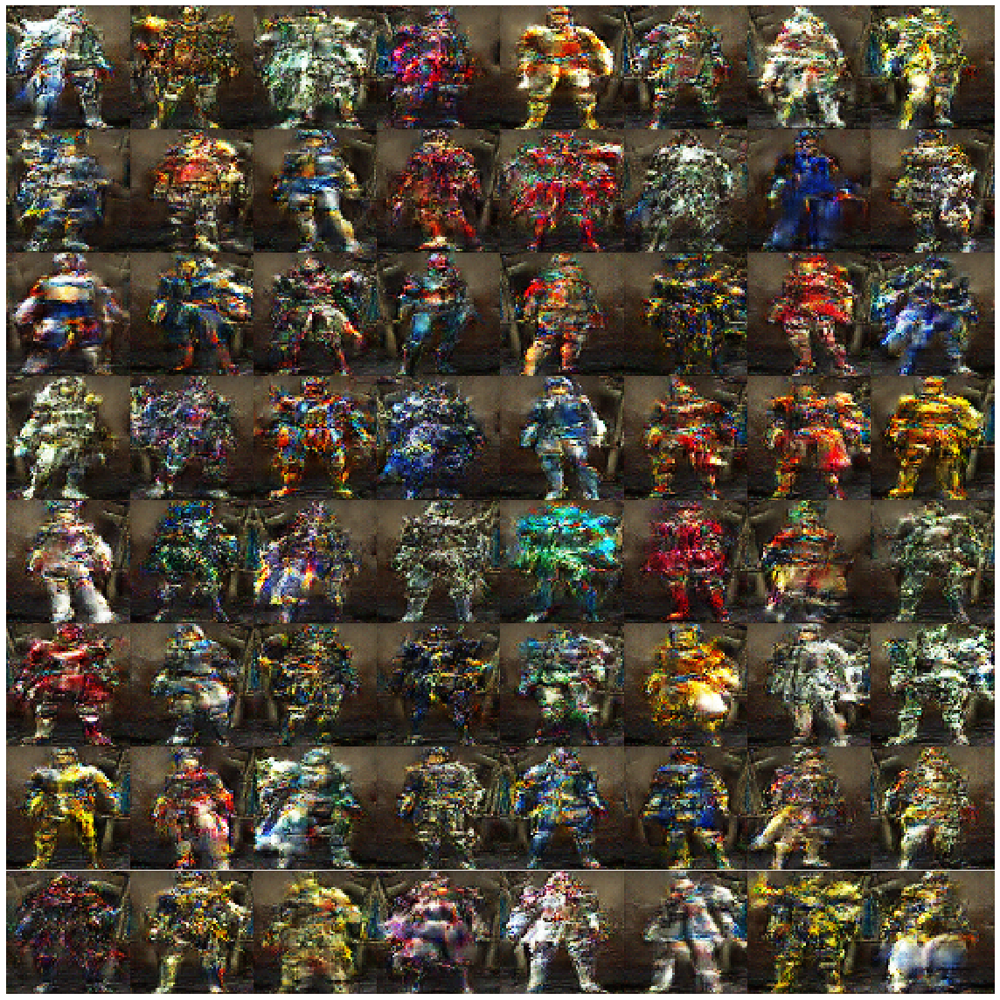

Disc: real loss: 0.355465 fake loss: 0.326602
GAN loss: 2.116421
Step 7500 completed. Time took: 6 secs.
Begin step:  7501
Disc: real loss: 0.362837 fake loss: 0.372164
GAN loss: 2.575750
Step 7501 completed. Time took: 3 secs.
Begin step:  7502
Disc: real loss: 0.369699 fake loss: 0.349152
GAN loss: 2.328152
Step 7502 completed. Time took: 3 secs.
Begin step:  7503
Disc: real loss: 0.326850 fake loss: 0.386589
GAN loss: 2.434057
Step 7503 completed. Time took: 3 secs.
Begin step:  7504
Disc: real loss: 0.328972 fake loss: 0.387751
GAN loss: 2.460535
Step 7504 completed. Time took: 3 secs.
Begin step:  7505
Disc: real loss: 0.363466 fake loss: 0.358534
GAN loss: 2.234668
Step 7505 completed. Time took: 3 secs.
Begin step:  7506
Disc: real loss: 0.375836 fake loss: 0.309144
GAN loss: 2.520068
Step 7506 completed. Time took: 3 secs.
Begin step:  7507
Disc: real loss: 0.367099 fake loss: 0.336007
GAN loss: 1.885130
Step 7507 completed. Time took: 3 secs.
Begin step:  7508
Disc: real loss:

Disc: real loss: 0.348342 fake loss: 0.333565
GAN loss: 2.398666
Step 7567 completed. Time took: 3 secs.
Begin step:  7568
Disc: real loss: 0.395050 fake loss: 0.461829
GAN loss: 3.333201
Step 7568 completed. Time took: 3 secs.
Begin step:  7569
Disc: real loss: 0.390702 fake loss: 0.393939
GAN loss: 2.322202
Step 7569 completed. Time took: 3 secs.
Begin step:  7570
Disc: real loss: 0.326783 fake loss: 0.373836
GAN loss: 2.687542
Step 7570 completed. Time took: 3 secs.
Begin step:  7571
Disc: real loss: 0.318321 fake loss: 0.345440
GAN loss: 2.245657
Step 7571 completed. Time took: 3 secs.
Begin step:  7572
Disc: real loss: 0.356916 fake loss: 0.318424
GAN loss: 2.280382
Step 7572 completed. Time took: 3 secs.
Begin step:  7573
Disc: real loss: 0.357405 fake loss: 0.339085
GAN loss: 2.483871
Step 7573 completed. Time took: 3 secs.
Begin step:  7574
Disc: real loss: 0.340291 fake loss: 0.349775
GAN loss: 2.419549
Step 7574 completed. Time took: 3 secs.
Begin step:  7575
Disc: real loss:

Disc: real loss: 0.375099 fake loss: 0.319882
GAN loss: 2.082855
Step 7634 completed. Time took: 3 secs.
Begin step:  7635
Disc: real loss: 0.367705 fake loss: 0.335882
GAN loss: 2.219172
Step 7635 completed. Time took: 3 secs.
Begin step:  7636
Disc: real loss: 0.342772 fake loss: 0.325999
GAN loss: 2.297137
Step 7636 completed. Time took: 3 secs.
Begin step:  7637
Disc: real loss: 0.360472 fake loss: 0.345145
GAN loss: 2.130000
Step 7637 completed. Time took: 3 secs.
Begin step:  7638
Disc: real loss: 0.326376 fake loss: 0.373550
GAN loss: 2.573276
Step 7638 completed. Time took: 3 secs.
Begin step:  7639
Disc: real loss: 0.358296 fake loss: 0.358054
GAN loss: 2.120461
Step 7639 completed. Time took: 3 secs.
Begin step:  7640
Disc: real loss: 0.340212 fake loss: 0.362122
GAN loss: 2.200660
Step 7640 completed. Time took: 3 secs.
Begin step:  7641
Disc: real loss: 0.364823 fake loss: 0.338806
GAN loss: 2.472570
Step 7641 completed. Time took: 3 secs.
Begin step:  7642
Disc: real loss:

Disc: real loss: 0.364365 fake loss: 0.328780
GAN loss: 2.438653
Step 7701 completed. Time took: 3 secs.
Begin step:  7702
Disc: real loss: 0.360900 fake loss: 0.352669
GAN loss: 2.201638
Step 7702 completed. Time took: 3 secs.
Begin step:  7703
Disc: real loss: 0.331316 fake loss: 0.393955
GAN loss: 1.722498
Step 7703 completed. Time took: 3 secs.
Begin step:  7704
Disc: real loss: 0.358659 fake loss: 0.337704
GAN loss: 2.705760
Step 7704 completed. Time took: 3 secs.
Begin step:  7705
Disc: real loss: 0.408178 fake loss: 0.439912
GAN loss: 3.277225
Step 7705 completed. Time took: 3 secs.
Begin step:  7706
Disc: real loss: 0.388909 fake loss: 0.388370
GAN loss: 2.176173
Step 7706 completed. Time took: 3 secs.
Begin step:  7707
Disc: real loss: 0.346371 fake loss: 0.342061
GAN loss: 2.271663
Step 7707 completed. Time took: 3 secs.
Begin step:  7708
Disc: real loss: 0.362427 fake loss: 0.383399
GAN loss: 2.049739
Step 7708 completed. Time took: 3 secs.
Begin step:  7709
Disc: real loss:

Disc: real loss: 0.347246 fake loss: 0.350466
GAN loss: 2.350499
Step 7768 completed. Time took: 3 secs.
Begin step:  7769
Disc: real loss: 0.358599 fake loss: 0.353233
GAN loss: 2.538743
Step 7769 completed. Time took: 3 secs.
Begin step:  7770
Disc: real loss: 0.359037 fake loss: 0.348566
GAN loss: 3.061798
Step 7770 completed. Time took: 3 secs.
Begin step:  7771
Disc: real loss: 0.366002 fake loss: 0.387206
GAN loss: 1.857433
Step 7771 completed. Time took: 3 secs.
Begin step:  7772
Disc: real loss: 0.357127 fake loss: 0.352380
GAN loss: 2.701317
Step 7772 completed. Time took: 3 secs.
Begin step:  7773
Disc: real loss: 0.358787 fake loss: 0.386148
GAN loss: 2.029373
Step 7773 completed. Time took: 3 secs.
Begin step:  7774
Disc: real loss: 0.349764 fake loss: 0.372447
GAN loss: 2.420537
Step 7774 completed. Time took: 3 secs.
Begin step:  7775
Disc: real loss: 0.345148 fake loss: 0.306165
GAN loss: 2.620744
Step 7775 completed. Time took: 3 secs.
Begin step:  7776
Disc: real loss:

Disc: real loss: 0.329836 fake loss: 0.353278
GAN loss: 2.309297
Step 7835 completed. Time took: 3 secs.
Begin step:  7836
Disc: real loss: 0.341402 fake loss: 0.320926
GAN loss: 2.521760
Step 7836 completed. Time took: 3 secs.
Begin step:  7837
Disc: real loss: 0.345265 fake loss: 0.407152
GAN loss: 2.617328
Step 7837 completed. Time took: 3 secs.
Begin step:  7838
Disc: real loss: 0.315314 fake loss: 0.367224
GAN loss: 2.267554
Step 7838 completed. Time took: 3 secs.
Begin step:  7839
Disc: real loss: 0.324003 fake loss: 0.371570
GAN loss: 2.799843
Step 7839 completed. Time took: 3 secs.
Begin step:  7840
Disc: real loss: 0.356600 fake loss: 0.375582
GAN loss: 2.210919
Step 7840 completed. Time took: 3 secs.
Begin step:  7841
Disc: real loss: 0.348101 fake loss: 0.383035
GAN loss: 2.562318
Step 7841 completed. Time took: 3 secs.
Begin step:  7842
Disc: real loss: 0.367719 fake loss: 0.389684
GAN loss: 2.192058
Step 7842 completed. Time took: 3 secs.
Begin step:  7843
Disc: real loss:

Disc: real loss: 0.307029 fake loss: 0.334142
GAN loss: 2.402977
Step 7902 completed. Time took: 3 secs.
Begin step:  7903
Disc: real loss: 0.359128 fake loss: 0.359785
GAN loss: 2.227325
Step 7903 completed. Time took: 3 secs.
Begin step:  7904
Disc: real loss: 0.337515 fake loss: 0.346622
GAN loss: 2.212572
Step 7904 completed. Time took: 3 secs.
Begin step:  7905
Disc: real loss: 0.337451 fake loss: 0.340024
GAN loss: 2.063867
Step 7905 completed. Time took: 3 secs.
Begin step:  7906
Disc: real loss: 0.352954 fake loss: 0.338060
GAN loss: 2.426840
Step 7906 completed. Time took: 3 secs.
Begin step:  7907
Disc: real loss: 0.392275 fake loss: 0.374018
GAN loss: 2.537760
Step 7907 completed. Time took: 3 secs.
Begin step:  7908
Disc: real loss: 0.354902 fake loss: 0.340051
GAN loss: 2.270083
Step 7908 completed. Time took: 3 secs.
Begin step:  7909
Disc: real loss: 0.352012 fake loss: 0.362543
GAN loss: 2.175074
Step 7909 completed. Time took: 3 secs.
Begin step:  7910
Disc: real loss:

Disc: real loss: 0.350475 fake loss: 0.343213
GAN loss: 2.404568
Step 7969 completed. Time took: 3 secs.
Begin step:  7970
Disc: real loss: 0.364033 fake loss: 0.305522
GAN loss: 2.324743
Step 7970 completed. Time took: 3 secs.
Begin step:  7971
Disc: real loss: 0.353081 fake loss: 0.357726
GAN loss: 2.061990
Step 7971 completed. Time took: 3 secs.
Begin step:  7972
Disc: real loss: 0.345532 fake loss: 0.361839
GAN loss: 2.461583
Step 7972 completed. Time took: 3 secs.
Begin step:  7973
Disc: real loss: 0.372272 fake loss: 0.358778
GAN loss: 2.503707
Step 7973 completed. Time took: 3 secs.
Begin step:  7974
Disc: real loss: 0.365332 fake loss: 0.345677
GAN loss: 2.124357
Step 7974 completed. Time took: 3 secs.
Begin step:  7975
Disc: real loss: 0.326007 fake loss: 0.401852
GAN loss: 2.697320
Step 7975 completed. Time took: 3 secs.
Begin step:  7976
Disc: real loss: 0.358129 fake loss: 0.379195
GAN loss: 2.478827
Step 7976 completed. Time took: 3 secs.
Begin step:  7977
Disc: real loss:

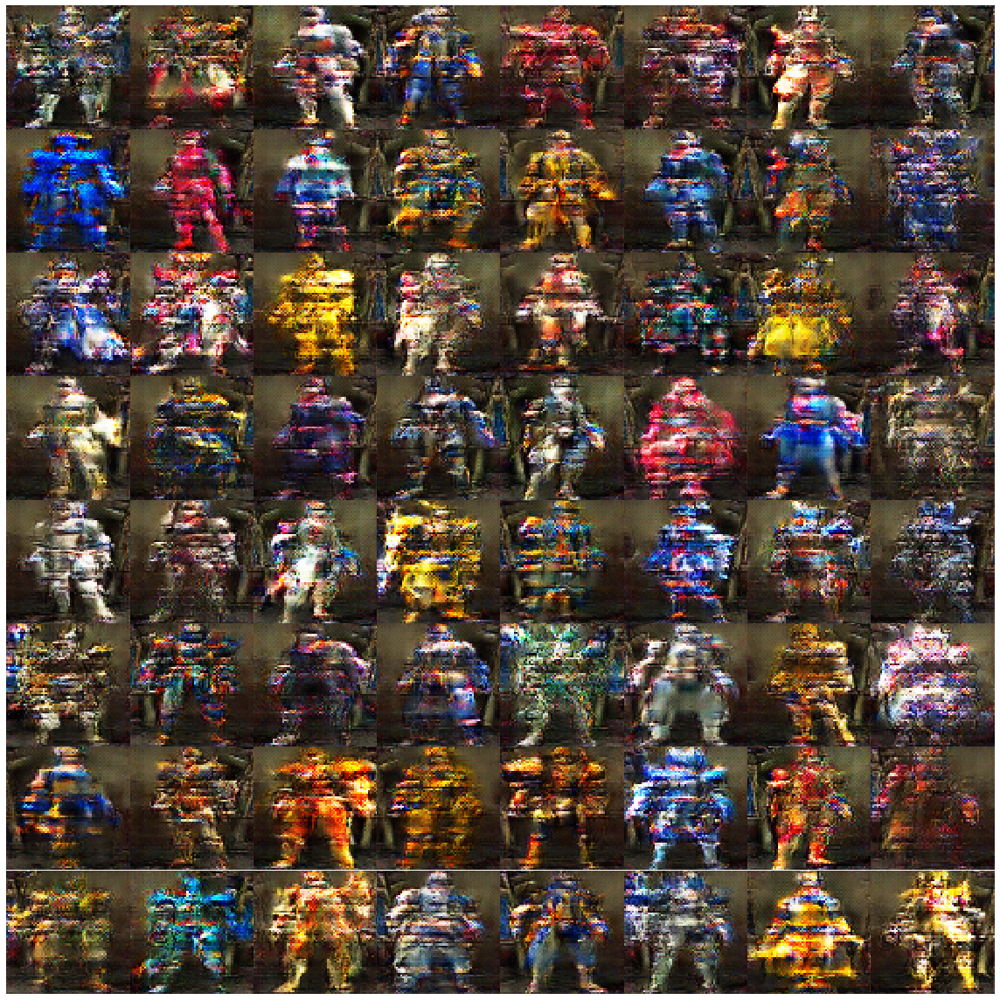

Begin step:  8000


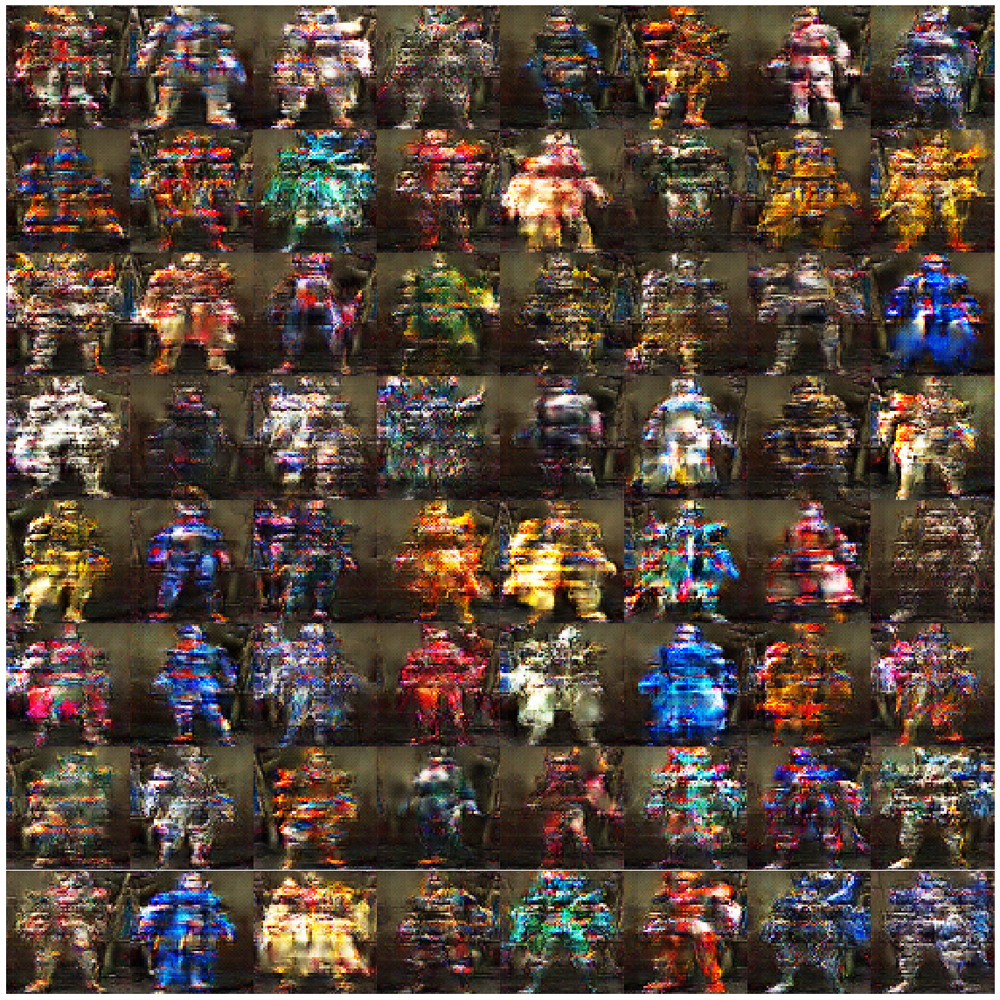

Disc: real loss: 0.545301 fake loss: 0.479074
GAN loss: 3.185093
Step 8000 completed. Time took: 6 secs.
Begin step:  8001
Disc: real loss: 0.413922 fake loss: 0.383969
GAN loss: 2.402959
Step 8001 completed. Time took: 3 secs.
Begin step:  8002
Disc: real loss: 0.350280 fake loss: 0.453421
GAN loss: 3.979860
Step 8002 completed. Time took: 3 secs.
Begin step:  8003
Disc: real loss: 0.705167 fake loss: 0.700613
GAN loss: 5.778614
Step 8003 completed. Time took: 3 secs.
Begin step:  8004
Disc: real loss: 0.807635 fake loss: 0.395245
GAN loss: 2.368692
Step 8004 completed. Time took: 3 secs.
Begin step:  8005
Disc: real loss: 0.362605 fake loss: 0.439587
GAN loss: 3.249214
Step 8005 completed. Time took: 3 secs.
Begin step:  8006
Disc: real loss: 0.566501 fake loss: 0.651416
GAN loss: 3.807385
Step 8006 completed. Time took: 3 secs.
Begin step:  8007
Disc: real loss: 0.472793 fake loss: 0.410312
GAN loss: 2.443495
Step 8007 completed. Time took: 3 secs.
Begin step:  8008
Disc: real loss:

Disc: real loss: 0.380332 fake loss: 0.345071
GAN loss: 2.477243
Step 8067 completed. Time took: 3 secs.
Begin step:  8068
Disc: real loss: 0.359803 fake loss: 0.346425
GAN loss: 2.339325
Step 8068 completed. Time took: 3 secs.
Begin step:  8069
Disc: real loss: 0.347933 fake loss: 0.387836
GAN loss: 2.422136
Step 8069 completed. Time took: 3 secs.
Begin step:  8070
Disc: real loss: 0.351235 fake loss: 0.372872
GAN loss: 2.149734
Step 8070 completed. Time took: 3 secs.
Begin step:  8071
Disc: real loss: 0.324584 fake loss: 0.371393
GAN loss: 2.807221
Step 8071 completed. Time took: 3 secs.
Begin step:  8072
Disc: real loss: 0.394486 fake loss: 0.368999
GAN loss: 2.170171
Step 8072 completed. Time took: 3 secs.
Begin step:  8073
Disc: real loss: 0.353694 fake loss: 0.347959
GAN loss: 2.087516
Step 8073 completed. Time took: 3 secs.
Begin step:  8074
Disc: real loss: 0.368134 fake loss: 0.351882
GAN loss: 2.176339
Step 8074 completed. Time took: 3 secs.
Begin step:  8075
Disc: real loss:

Disc: real loss: 0.342798 fake loss: 0.342253
GAN loss: 2.228875
Step 8134 completed. Time took: 3 secs.
Begin step:  8135
Disc: real loss: 0.338291 fake loss: 0.316415
GAN loss: 2.215345
Step 8135 completed. Time took: 3 secs.
Begin step:  8136
Disc: real loss: 0.370607 fake loss: 0.377656
GAN loss: 2.056800
Step 8136 completed. Time took: 3 secs.
Begin step:  8137
Disc: real loss: 0.342087 fake loss: 0.363078
GAN loss: 2.587443
Step 8137 completed. Time took: 3 secs.
Begin step:  8138
Disc: real loss: 0.337378 fake loss: 0.333298
GAN loss: 2.343477
Step 8138 completed. Time took: 3 secs.
Begin step:  8139
Disc: real loss: 0.362198 fake loss: 0.360455
GAN loss: 2.920116
Step 8139 completed. Time took: 3 secs.
Begin step:  8140
Disc: real loss: 0.393950 fake loss: 0.361823
GAN loss: 1.957018
Step 8140 completed. Time took: 3 secs.
Begin step:  8141
Disc: real loss: 0.379045 fake loss: 0.341829
GAN loss: 2.093948
Step 8141 completed. Time took: 3 secs.
Begin step:  8142
Disc: real loss:

Disc: real loss: 0.316595 fake loss: 0.363798
GAN loss: 2.897405
Step 8201 completed. Time took: 3 secs.
Begin step:  8202
Disc: real loss: 0.411235 fake loss: 0.337224
GAN loss: 2.022999
Step 8202 completed. Time took: 3 secs.
Begin step:  8203
Disc: real loss: 0.338971 fake loss: 0.320087
GAN loss: 2.315676
Step 8203 completed. Time took: 3 secs.
Begin step:  8204
Disc: real loss: 0.358902 fake loss: 0.356772
GAN loss: 2.132264
Step 8204 completed. Time took: 3 secs.
Begin step:  8205
Disc: real loss: 0.343606 fake loss: 0.379713
GAN loss: 2.367395
Step 8205 completed. Time took: 3 secs.
Begin step:  8206
Disc: real loss: 0.363808 fake loss: 0.334795
GAN loss: 2.488758
Step 8206 completed. Time took: 3 secs.
Begin step:  8207
Disc: real loss: 0.347114 fake loss: 0.372494
GAN loss: 2.776269
Step 8207 completed. Time took: 3 secs.
Begin step:  8208
Disc: real loss: 0.339104 fake loss: 0.387732
GAN loss: 1.799710
Step 8208 completed. Time took: 3 secs.
Begin step:  8209
Disc: real loss:

Disc: real loss: 0.353277 fake loss: 0.323663
GAN loss: 2.433320
Step 8268 completed. Time took: 3 secs.
Begin step:  8269
Disc: real loss: 0.341593 fake loss: 0.356631
GAN loss: 2.046267
Step 8269 completed. Time took: 3 secs.
Begin step:  8270
Disc: real loss: 0.337365 fake loss: 0.340209
GAN loss: 2.060111
Step 8270 completed. Time took: 3 secs.
Begin step:  8271
Disc: real loss: 0.339149 fake loss: 0.382748
GAN loss: 2.222663
Step 8271 completed. Time took: 3 secs.
Begin step:  8272
Disc: real loss: 0.359041 fake loss: 0.365855
GAN loss: 2.515922
Step 8272 completed. Time took: 3 secs.
Begin step:  8273
Disc: real loss: 0.353186 fake loss: 0.350610
GAN loss: 2.227593
Step 8273 completed. Time took: 3 secs.
Begin step:  8274
Disc: real loss: 0.309515 fake loss: 0.351227
GAN loss: 2.228159
Step 8274 completed. Time took: 3 secs.
Begin step:  8275
Disc: real loss: 0.331823 fake loss: 0.355022
GAN loss: 2.167430
Step 8275 completed. Time took: 3 secs.
Begin step:  8276
Disc: real loss:

Disc: real loss: 0.320854 fake loss: 0.354115
GAN loss: 2.355436
Step 8335 completed. Time took: 3 secs.
Begin step:  8336
Disc: real loss: 0.329429 fake loss: 0.342805
GAN loss: 2.463805
Step 8336 completed. Time took: 3 secs.
Begin step:  8337
Disc: real loss: 0.335953 fake loss: 0.357885
GAN loss: 2.092017
Step 8337 completed. Time took: 3 secs.
Begin step:  8338
Disc: real loss: 0.342529 fake loss: 0.353526
GAN loss: 2.086562
Step 8338 completed. Time took: 3 secs.
Begin step:  8339
Disc: real loss: 0.343466 fake loss: 0.330680
GAN loss: 2.232527
Step 8339 completed. Time took: 3 secs.
Begin step:  8340
Disc: real loss: 0.320564 fake loss: 0.381768
GAN loss: 2.183492
Step 8340 completed. Time took: 3 secs.
Begin step:  8341
Disc: real loss: 0.332246 fake loss: 0.361127
GAN loss: 2.012581
Step 8341 completed. Time took: 3 secs.
Begin step:  8342
Disc: real loss: 0.333407 fake loss: 0.398545
GAN loss: 2.651734
Step 8342 completed. Time took: 3 secs.
Begin step:  8343
Disc: real loss:

Disc: real loss: 0.323900 fake loss: 0.374241
GAN loss: 2.400680
Step 8402 completed. Time took: 3 secs.
Begin step:  8403
Disc: real loss: 0.332494 fake loss: 0.322667
GAN loss: 2.193141
Step 8403 completed. Time took: 3 secs.
Begin step:  8404
Disc: real loss: 0.352852 fake loss: 0.371805
GAN loss: 2.289116
Step 8404 completed. Time took: 3 secs.
Begin step:  8405
Disc: real loss: 0.345748 fake loss: 0.361157
GAN loss: 2.186191
Step 8405 completed. Time took: 3 secs.
Begin step:  8406
Disc: real loss: 0.370202 fake loss: 0.348409
GAN loss: 2.492659
Step 8406 completed. Time took: 3 secs.
Begin step:  8407
Disc: real loss: 0.375243 fake loss: 0.389622
GAN loss: 2.371269
Step 8407 completed. Time took: 3 secs.
Begin step:  8408
Disc: real loss: 0.381211 fake loss: 0.351530
GAN loss: 1.826473
Step 8408 completed. Time took: 3 secs.
Begin step:  8409
Disc: real loss: 0.354898 fake loss: 0.375044
GAN loss: 2.163815
Step 8409 completed. Time took: 3 secs.
Begin step:  8410
Disc: real loss:

Disc: real loss: 0.334219 fake loss: 0.337991
GAN loss: 2.577284
Step 8469 completed. Time took: 3 secs.
Begin step:  8470
Disc: real loss: 0.374973 fake loss: 0.337009
GAN loss: 2.439893
Step 8470 completed. Time took: 3 secs.
Begin step:  8471
Disc: real loss: 0.323525 fake loss: 0.376396
GAN loss: 1.940877
Step 8471 completed. Time took: 3 secs.
Begin step:  8472
Disc: real loss: 0.371044 fake loss: 0.360483
GAN loss: 2.616363
Step 8472 completed. Time took: 3 secs.
Begin step:  8473
Disc: real loss: 0.320866 fake loss: 0.390749
GAN loss: 1.987658
Step 8473 completed. Time took: 3 secs.
Begin step:  8474
Disc: real loss: 0.342142 fake loss: 0.385573
GAN loss: 2.937022
Step 8474 completed. Time took: 3 secs.
Begin step:  8475
Disc: real loss: 0.421498 fake loss: 0.334206
GAN loss: 1.892937
Step 8475 completed. Time took: 3 secs.
Begin step:  8476
Disc: real loss: 0.347465 fake loss: 0.341990
GAN loss: 2.932403
Step 8476 completed. Time took: 3 secs.
Begin step:  8477
Disc: real loss:

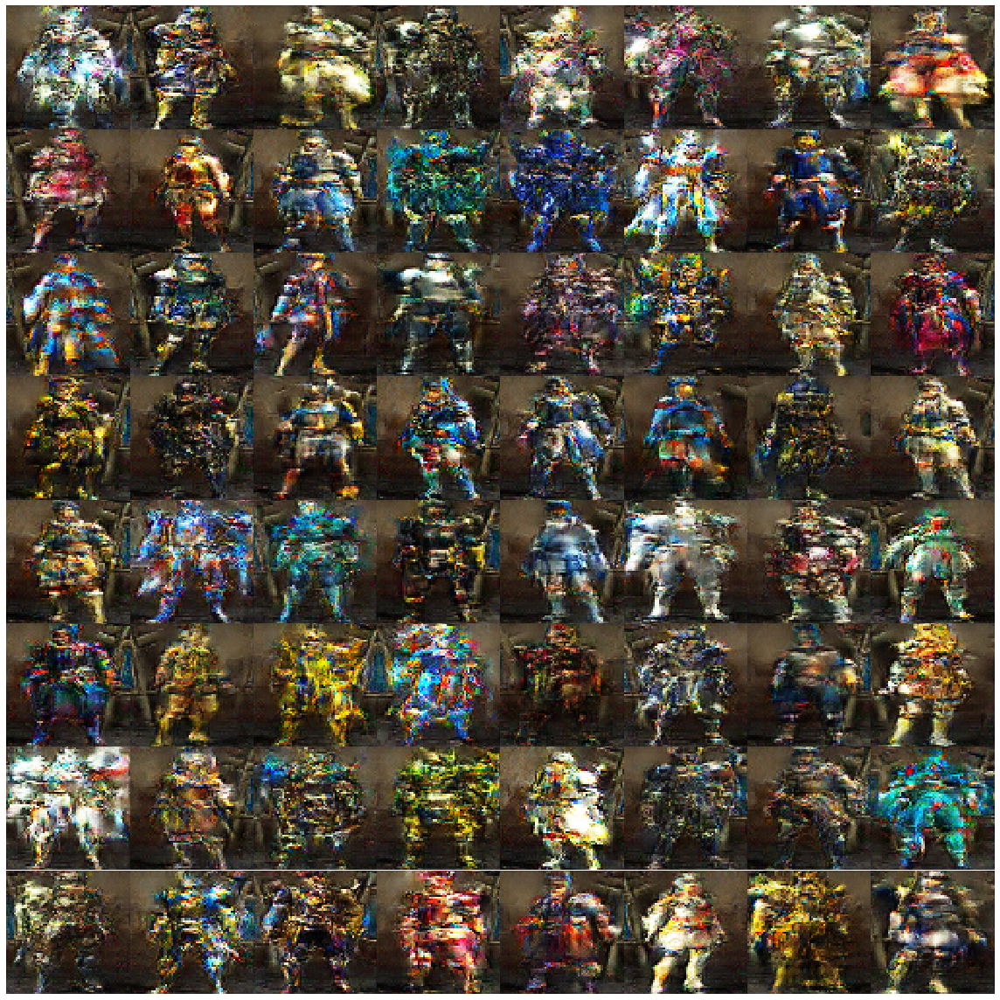

Disc: real loss: 0.317807 fake loss: 0.338135
GAN loss: 2.272339
Step 8500 completed. Time took: 6 secs.
Begin step:  8501
Disc: real loss: 0.322884 fake loss: 0.363017
GAN loss: 2.273214
Step 8501 completed. Time took: 3 secs.
Begin step:  8502
Disc: real loss: 0.337210 fake loss: 0.363018
GAN loss: 2.548619
Step 8502 completed. Time took: 3 secs.
Begin step:  8503
Disc: real loss: 0.361060 fake loss: 0.333534
GAN loss: 2.101520
Step 8503 completed. Time took: 3 secs.
Begin step:  8504
Disc: real loss: 0.359813 fake loss: 0.340564
GAN loss: 2.287190
Step 8504 completed. Time took: 3 secs.
Begin step:  8505
Disc: real loss: 0.339506 fake loss: 0.337786
GAN loss: 2.543801
Step 8505 completed. Time took: 3 secs.
Begin step:  8506
Disc: real loss: 0.359923 fake loss: 0.316784
GAN loss: 2.588247
Step 8506 completed. Time took: 3 secs.
Begin step:  8507
Disc: real loss: 0.342301 fake loss: 0.344106
GAN loss: 2.358752
Step 8507 completed. Time took: 3 secs.
Begin step:  8508
Disc: real loss:

Disc: real loss: 0.337312 fake loss: 0.358472
GAN loss: 1.954521
Step 8567 completed. Time took: 3 secs.
Begin step:  8568
Disc: real loss: 0.345159 fake loss: 0.358008
GAN loss: 2.379357
Step 8568 completed. Time took: 3 secs.
Begin step:  8569
Disc: real loss: 0.355336 fake loss: 0.365155
GAN loss: 2.000562
Step 8569 completed. Time took: 3 secs.
Begin step:  8570
Disc: real loss: 0.321737 fake loss: 0.388303
GAN loss: 2.682025
Step 8570 completed. Time took: 3 secs.
Begin step:  8571
Disc: real loss: 0.359038 fake loss: 0.392166
GAN loss: 2.187469
Step 8571 completed. Time took: 3 secs.
Begin step:  8572
Disc: real loss: 0.341727 fake loss: 0.339141
GAN loss: 2.394815
Step 8572 completed. Time took: 3 secs.
Begin step:  8573
Disc: real loss: 0.315773 fake loss: 0.326703
GAN loss: 2.106000
Step 8573 completed. Time took: 3 secs.
Begin step:  8574
Disc: real loss: 0.327885 fake loss: 0.329132
GAN loss: 2.066865
Step 8574 completed. Time took: 3 secs.
Begin step:  8575
Disc: real loss:

Disc: real loss: 0.324919 fake loss: 0.390385
GAN loss: 3.386202
Step 8634 completed. Time took: 3 secs.
Begin step:  8635
Disc: real loss: 0.394604 fake loss: 0.401148
GAN loss: 1.789765
Step 8635 completed. Time took: 3 secs.
Begin step:  8636
Disc: real loss: 0.414143 fake loss: 0.321993
GAN loss: 2.745105
Step 8636 completed. Time took: 3 secs.
Begin step:  8637
Disc: real loss: 0.335150 fake loss: 0.345315
GAN loss: 2.145199
Step 8637 completed. Time took: 3 secs.
Begin step:  8638
Disc: real loss: 0.355948 fake loss: 0.359375
GAN loss: 2.253689
Step 8638 completed. Time took: 3 secs.
Begin step:  8639
Disc: real loss: 0.340975 fake loss: 0.367277
GAN loss: 1.937667
Step 8639 completed. Time took: 3 secs.
Begin step:  8640
Disc: real loss: 0.376628 fake loss: 0.336654
GAN loss: 2.057651
Step 8640 completed. Time took: 3 secs.
Begin step:  8641
Disc: real loss: 0.368634 fake loss: 0.365681
GAN loss: 2.216590
Step 8641 completed. Time took: 3 secs.
Begin step:  8642
Disc: real loss:

Disc: real loss: 0.356441 fake loss: 0.350510
GAN loss: 2.166199
Step 8701 completed. Time took: 3 secs.
Begin step:  8702
Disc: real loss: 0.319545 fake loss: 0.345090
GAN loss: 2.309403
Step 8702 completed. Time took: 3 secs.
Begin step:  8703
Disc: real loss: 0.356158 fake loss: 0.361960
GAN loss: 2.163214
Step 8703 completed. Time took: 3 secs.
Begin step:  8704
Disc: real loss: 0.348701 fake loss: 0.321567
GAN loss: 2.160791
Step 8704 completed. Time took: 3 secs.
Begin step:  8705
Disc: real loss: 0.338975 fake loss: 0.405956
GAN loss: 2.988011
Step 8705 completed. Time took: 3 secs.
Begin step:  8706
Disc: real loss: 0.365264 fake loss: 0.322668
GAN loss: 2.069423
Step 8706 completed. Time took: 3 secs.
Begin step:  8707
Disc: real loss: 0.347179 fake loss: 0.340252
GAN loss: 2.332920
Step 8707 completed. Time took: 3 secs.
Begin step:  8708
Disc: real loss: 0.357872 fake loss: 0.356040
GAN loss: 2.009071
Step 8708 completed. Time took: 3 secs.
Begin step:  8709
Disc: real loss:

Disc: real loss: 0.366657 fake loss: 0.354122
GAN loss: 2.056803
Step 8768 completed. Time took: 3 secs.
Begin step:  8769
Disc: real loss: 0.370344 fake loss: 0.437573
GAN loss: 3.258590
Step 8769 completed. Time took: 3 secs.
Begin step:  8770
Disc: real loss: 0.476890 fake loss: 0.331785
GAN loss: 2.365311
Step 8770 completed. Time took: 3 secs.
Begin step:  8771
Disc: real loss: 0.373519 fake loss: 0.366218
GAN loss: 2.252448
Step 8771 completed. Time took: 3 secs.
Begin step:  8772
Disc: real loss: 0.356571 fake loss: 0.352213
GAN loss: 2.268359
Step 8772 completed. Time took: 3 secs.
Begin step:  8773
Disc: real loss: 0.340746 fake loss: 0.345089
GAN loss: 2.192949
Step 8773 completed. Time took: 3 secs.
Begin step:  8774
Disc: real loss: 0.334726 fake loss: 0.363766
GAN loss: 2.530357
Step 8774 completed. Time took: 3 secs.
Begin step:  8775
Disc: real loss: 0.362060 fake loss: 0.338749
GAN loss: 2.040334
Step 8775 completed. Time took: 3 secs.
Begin step:  8776
Disc: real loss:

Disc: real loss: 0.362293 fake loss: 0.381830
GAN loss: 1.814633
Step 8835 completed. Time took: 3 secs.
Begin step:  8836
Disc: real loss: 0.368312 fake loss: 0.333162
GAN loss: 2.192579
Step 8836 completed. Time took: 3 secs.
Begin step:  8837
Disc: real loss: 0.370471 fake loss: 0.358173
GAN loss: 2.683363
Step 8837 completed. Time took: 3 secs.
Begin step:  8838
Disc: real loss: 0.364763 fake loss: 0.315888
GAN loss: 2.405180
Step 8838 completed. Time took: 3 secs.
Begin step:  8839
Disc: real loss: 0.356731 fake loss: 0.334833
GAN loss: 2.126395
Step 8839 completed. Time took: 3 secs.
Begin step:  8840
Disc: real loss: 0.371553 fake loss: 0.331233
GAN loss: 2.303237
Step 8840 completed. Time took: 3 secs.
Begin step:  8841
Disc: real loss: 0.337876 fake loss: 0.364719
GAN loss: 1.964599
Step 8841 completed. Time took: 3 secs.
Begin step:  8842
Disc: real loss: 0.329977 fake loss: 0.393337
GAN loss: 2.425454
Step 8842 completed. Time took: 3 secs.
Begin step:  8843
Disc: real loss:

Disc: real loss: 0.335692 fake loss: 0.336633
GAN loss: 2.390225
Step 8902 completed. Time took: 3 secs.
Begin step:  8903
Disc: real loss: 0.330258 fake loss: 0.336829
GAN loss: 2.705914
Step 8903 completed. Time took: 3 secs.
Begin step:  8904
Disc: real loss: 0.366018 fake loss: 0.359005
GAN loss: 2.229466
Step 8904 completed. Time took: 3 secs.
Begin step:  8905
Disc: real loss: 0.348916 fake loss: 0.366800
GAN loss: 2.206143
Step 8905 completed. Time took: 3 secs.
Begin step:  8906
Disc: real loss: 0.350750 fake loss: 0.356252
GAN loss: 2.637197
Step 8906 completed. Time took: 3 secs.
Begin step:  8907
Disc: real loss: 0.347574 fake loss: 0.328772
GAN loss: 1.801119
Step 8907 completed. Time took: 3 secs.
Begin step:  8908
Disc: real loss: 0.304637 fake loss: 0.415577
GAN loss: 3.404787
Step 8908 completed. Time took: 3 secs.
Begin step:  8909
Disc: real loss: 0.389617 fake loss: 0.386039
GAN loss: 2.526660
Step 8909 completed. Time took: 3 secs.
Begin step:  8910
Disc: real loss:

Disc: real loss: 0.359948 fake loss: 0.359121
GAN loss: 2.841110
Step 8969 completed. Time took: 3 secs.
Begin step:  8970
Disc: real loss: 0.342877 fake loss: 0.346299
GAN loss: 1.966349
Step 8970 completed. Time took: 3 secs.
Begin step:  8971
Disc: real loss: 0.346736 fake loss: 0.346415
GAN loss: 2.282202
Step 8971 completed. Time took: 3 secs.
Begin step:  8972
Disc: real loss: 0.323412 fake loss: 0.352166
GAN loss: 2.658513
Step 8972 completed. Time took: 3 secs.
Begin step:  8973
Disc: real loss: 0.386736 fake loss: 0.316126
GAN loss: 2.628038
Step 8973 completed. Time took: 3 secs.
Begin step:  8974
Disc: real loss: 0.341160 fake loss: 0.331637
GAN loss: 1.802086
Step 8974 completed. Time took: 3 secs.
Begin step:  8975
Disc: real loss: 0.310888 fake loss: 0.368747
GAN loss: 2.359883
Step 8975 completed. Time took: 3 secs.
Begin step:  8976
Disc: real loss: 0.333789 fake loss: 0.335970
GAN loss: 2.215800
Step 8976 completed. Time took: 3 secs.
Begin step:  8977
Disc: real loss:

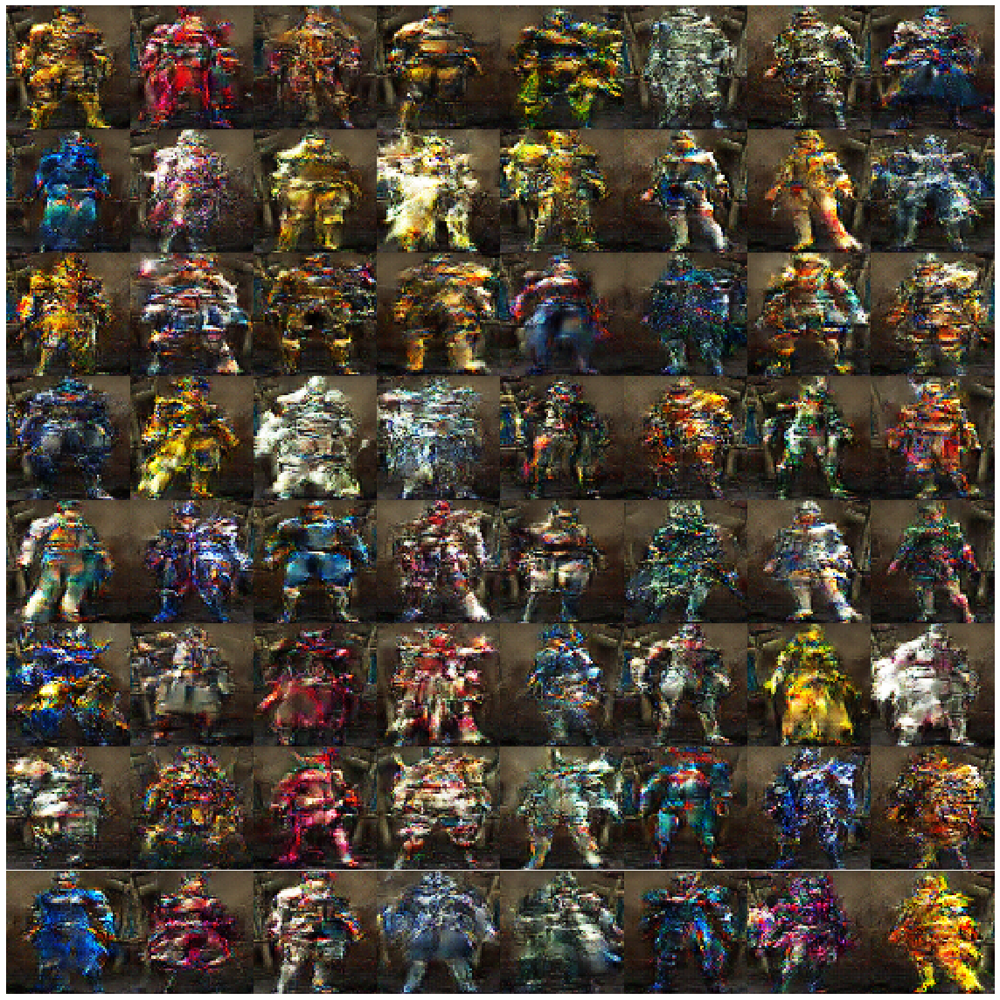

Begin step:  9000


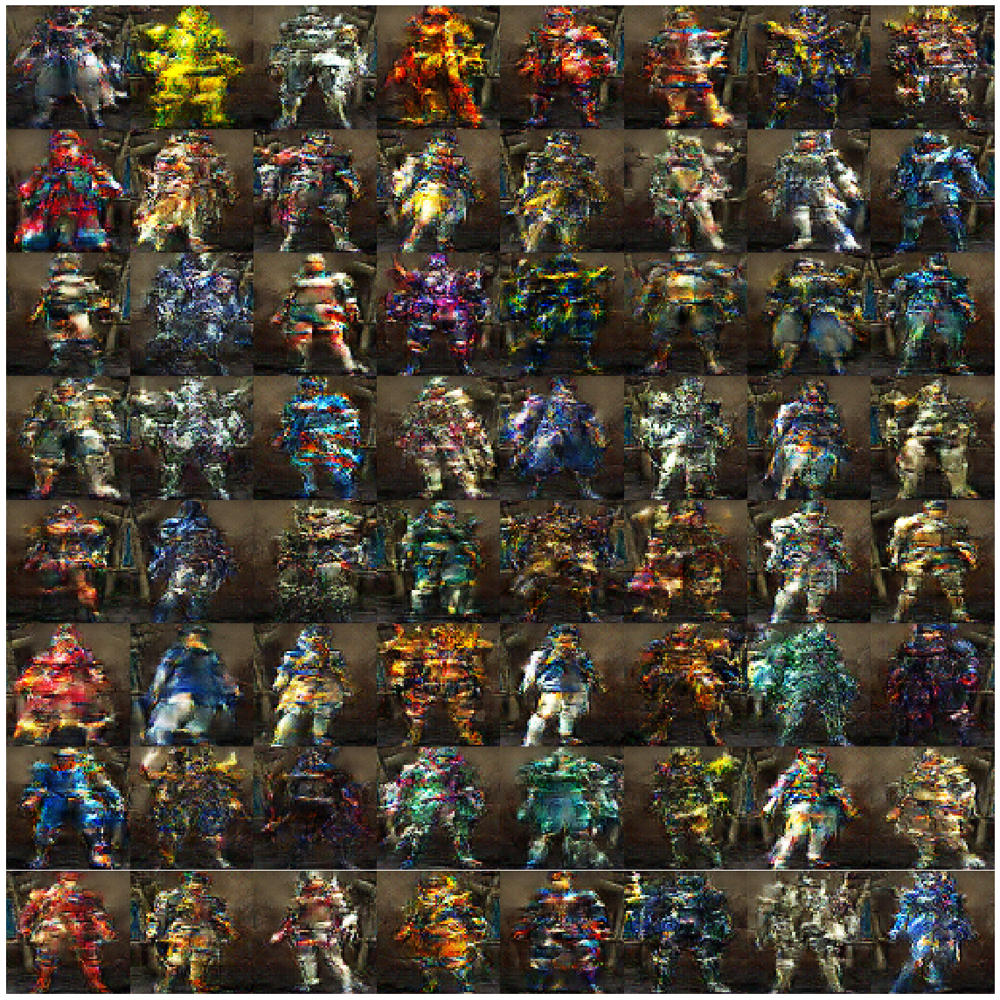

Disc: real loss: 0.564812 fake loss: 0.382537
GAN loss: 2.044198
Step 9000 completed. Time took: 7 secs.
Begin step:  9001
Disc: real loss: 0.391440 fake loss: 0.342797
GAN loss: 2.949158
Step 9001 completed. Time took: 3 secs.
Begin step:  9002
Disc: real loss: 0.394743 fake loss: 0.358734
GAN loss: 2.634292
Step 9002 completed. Time took: 3 secs.
Begin step:  9003
Disc: real loss: 0.365973 fake loss: 0.356570
GAN loss: 2.905572
Step 9003 completed. Time took: 3 secs.
Begin step:  9004
Disc: real loss: 0.367543 fake loss: 0.344180
GAN loss: 2.501152
Step 9004 completed. Time took: 3 secs.
Begin step:  9005
Disc: real loss: 0.354169 fake loss: 0.358277
GAN loss: 2.528416
Step 9005 completed. Time took: 3 secs.
Begin step:  9006
Disc: real loss: 0.387895 fake loss: 0.450206
GAN loss: 3.297650
Step 9006 completed. Time took: 3 secs.
Begin step:  9007
Disc: real loss: 0.360956 fake loss: 0.418254
GAN loss: 2.502339
Step 9007 completed. Time took: 3 secs.
Begin step:  9008
Disc: real loss:

Disc: real loss: 0.324739 fake loss: 0.375329
GAN loss: 2.423823
Step 9067 completed. Time took: 3 secs.
Begin step:  9068
Disc: real loss: 0.367134 fake loss: 0.365431
GAN loss: 2.230958
Step 9068 completed. Time took: 3 secs.
Begin step:  9069
Disc: real loss: 0.354769 fake loss: 0.368556
GAN loss: 2.039753
Step 9069 completed. Time took: 3 secs.
Begin step:  9070
Disc: real loss: 0.339904 fake loss: 0.332819
GAN loss: 2.899898
Step 9070 completed. Time took: 3 secs.
Begin step:  9071
Disc: real loss: 0.383532 fake loss: 0.329046
GAN loss: 2.027248
Step 9071 completed. Time took: 3 secs.
Begin step:  9072
Disc: real loss: 0.359594 fake loss: 0.342139
GAN loss: 2.152077
Step 9072 completed. Time took: 3 secs.
Begin step:  9073
Disc: real loss: 0.316948 fake loss: 0.337699
GAN loss: 2.479477
Step 9073 completed. Time took: 3 secs.
Begin step:  9074
Disc: real loss: 0.339554 fake loss: 0.373359
GAN loss: 2.003634
Step 9074 completed. Time took: 3 secs.
Begin step:  9075
Disc: real loss:

Disc: real loss: 0.373785 fake loss: 0.346815
GAN loss: 2.327783
Step 9134 completed. Time took: 3 secs.
Begin step:  9135
Disc: real loss: 0.369437 fake loss: 0.337460
GAN loss: 2.189274
Step 9135 completed. Time took: 3 secs.
Begin step:  9136
Disc: real loss: 0.339695 fake loss: 0.350326
GAN loss: 2.652155
Step 9136 completed. Time took: 4 secs.
Begin step:  9137
Disc: real loss: 0.332482 fake loss: 0.356512
GAN loss: 2.208758
Step 9137 completed. Time took: 3 secs.
Begin step:  9138
Disc: real loss: 0.367754 fake loss: 0.343061
GAN loss: 2.321831
Step 9138 completed. Time took: 3 secs.
Begin step:  9139
Disc: real loss: 0.306436 fake loss: 0.335206
GAN loss: 2.326354
Step 9139 completed. Time took: 3 secs.
Begin step:  9140
Disc: real loss: 0.340203 fake loss: 0.357867
GAN loss: 2.639398
Step 9140 completed. Time took: 3 secs.
Begin step:  9141
Disc: real loss: 0.368620 fake loss: 0.359209
GAN loss: 2.201463
Step 9141 completed. Time took: 3 secs.
Begin step:  9142
Disc: real loss:

Disc: real loss: 0.345279 fake loss: 0.354720
GAN loss: 2.235580
Step 9201 completed. Time took: 3 secs.
Begin step:  9202
Disc: real loss: 0.341233 fake loss: 0.339350
GAN loss: 2.745645
Step 9202 completed. Time took: 3 secs.
Begin step:  9203
Disc: real loss: 0.352898 fake loss: 0.360091
GAN loss: 2.122755
Step 9203 completed. Time took: 3 secs.
Begin step:  9204
Disc: real loss: 0.303482 fake loss: 0.342014
GAN loss: 2.559424
Step 9204 completed. Time took: 3 secs.
Begin step:  9205
Disc: real loss: 0.357397 fake loss: 0.354303
GAN loss: 2.131912
Step 9205 completed. Time took: 3 secs.
Begin step:  9206
Disc: real loss: 0.319891 fake loss: 0.384552
GAN loss: 3.032879
Step 9206 completed. Time took: 3 secs.
Begin step:  9207
Disc: real loss: 0.398782 fake loss: 0.345312
GAN loss: 1.706260
Step 9207 completed. Time took: 3 secs.
Begin step:  9208
Disc: real loss: 0.357200 fake loss: 0.362089
GAN loss: 2.737230
Step 9208 completed. Time took: 3 secs.
Begin step:  9209
Disc: real loss:

Disc: real loss: 0.362458 fake loss: 0.351315
GAN loss: 2.409961
Step 9268 completed. Time took: 3 secs.
Begin step:  9269
Disc: real loss: 0.354835 fake loss: 0.340580
GAN loss: 2.334105
Step 9269 completed. Time took: 3 secs.
Begin step:  9270
Disc: real loss: 0.346212 fake loss: 0.312563
GAN loss: 2.538043
Step 9270 completed. Time took: 3 secs.
Begin step:  9271
Disc: real loss: 0.375946 fake loss: 0.365911
GAN loss: 1.913739
Step 9271 completed. Time took: 3 secs.
Begin step:  9272
Disc: real loss: 0.367506 fake loss: 0.328952
GAN loss: 2.686969
Step 9272 completed. Time took: 3 secs.
Begin step:  9273
Disc: real loss: 0.369146 fake loss: 0.354850
GAN loss: 1.901659
Step 9273 completed. Time took: 3 secs.
Begin step:  9274
Disc: real loss: 0.330881 fake loss: 0.341693
GAN loss: 2.978787
Step 9274 completed. Time took: 3 secs.
Begin step:  9275
Disc: real loss: 0.402557 fake loss: 0.351852
GAN loss: 2.380515
Step 9275 completed. Time took: 3 secs.
Begin step:  9276
Disc: real loss:

Disc: real loss: 0.398407 fake loss: 0.350107
GAN loss: 2.160101
Step 9335 completed. Time took: 3 secs.
Begin step:  9336
Disc: real loss: 0.400346 fake loss: 0.358049
GAN loss: 2.417595
Step 9336 completed. Time took: 3 secs.
Begin step:  9337
Disc: real loss: 0.317500 fake loss: 0.318843
GAN loss: 2.282482
Step 9337 completed. Time took: 3 secs.
Begin step:  9338
Disc: real loss: 0.364285 fake loss: 0.427777
GAN loss: 3.739236
Step 9338 completed. Time took: 3 secs.
Begin step:  9339
Disc: real loss: 0.412515 fake loss: 0.387296
GAN loss: 1.729313
Step 9339 completed. Time took: 3 secs.
Begin step:  9340
Disc: real loss: 0.420772 fake loss: 0.349795
GAN loss: 3.242493
Step 9340 completed. Time took: 3 secs.
Begin step:  9341
Disc: real loss: 0.454569 fake loss: 0.384578
GAN loss: 2.554152
Step 9341 completed. Time took: 3 secs.
Begin step:  9342
Disc: real loss: 0.357011 fake loss: 0.344835
GAN loss: 2.630974
Step 9342 completed. Time took: 3 secs.
Begin step:  9343
Disc: real loss:

Disc: real loss: 0.344705 fake loss: 0.319370
GAN loss: 2.460204
Step 9402 completed. Time took: 3 secs.
Begin step:  9403
Disc: real loss: 0.336273 fake loss: 0.393739
GAN loss: 2.104796
Step 9403 completed. Time took: 3 secs.
Begin step:  9404
Disc: real loss: 0.325505 fake loss: 0.352393
GAN loss: 2.425520
Step 9404 completed. Time took: 3 secs.
Begin step:  9405
Disc: real loss: 0.392749 fake loss: 0.368114
GAN loss: 2.188336
Step 9405 completed. Time took: 3 secs.
Begin step:  9406
Disc: real loss: 0.338741 fake loss: 0.340043
GAN loss: 2.460077
Step 9406 completed. Time took: 3 secs.
Begin step:  9407
Disc: real loss: 0.347217 fake loss: 0.379202
GAN loss: 2.372764
Step 9407 completed. Time took: 3 secs.
Begin step:  9408
Disc: real loss: 0.334162 fake loss: 0.351653
GAN loss: 2.065908
Step 9408 completed. Time took: 3 secs.
Begin step:  9409
Disc: real loss: 0.331754 fake loss: 0.353002
GAN loss: 1.910046
Step 9409 completed. Time took: 3 secs.
Begin step:  9410
Disc: real loss:

Disc: real loss: 0.361695 fake loss: 0.371091
GAN loss: 2.631650
Step 9469 completed. Time took: 3 secs.
Begin step:  9470
Disc: real loss: 0.381280 fake loss: 0.344775
GAN loss: 2.239918
Step 9470 completed. Time took: 3 secs.
Begin step:  9471
Disc: real loss: 0.345055 fake loss: 0.347872
GAN loss: 2.232760
Step 9471 completed. Time took: 3 secs.
Begin step:  9472
Disc: real loss: 0.333321 fake loss: 0.371832
GAN loss: 2.973215
Step 9472 completed. Time took: 3 secs.
Begin step:  9473
Disc: real loss: 0.383609 fake loss: 0.358922
GAN loss: 2.155894
Step 9473 completed. Time took: 3 secs.
Begin step:  9474
Disc: real loss: 0.351842 fake loss: 0.380625
GAN loss: 2.701844
Step 9474 completed. Time took: 3 secs.
Begin step:  9475
Disc: real loss: 0.357208 fake loss: 0.305806
GAN loss: 2.109875
Step 9475 completed. Time took: 3 secs.
Begin step:  9476
Disc: real loss: 0.378137 fake loss: 0.344202
GAN loss: 2.333785
Step 9476 completed. Time took: 3 secs.
Begin step:  9477
Disc: real loss:

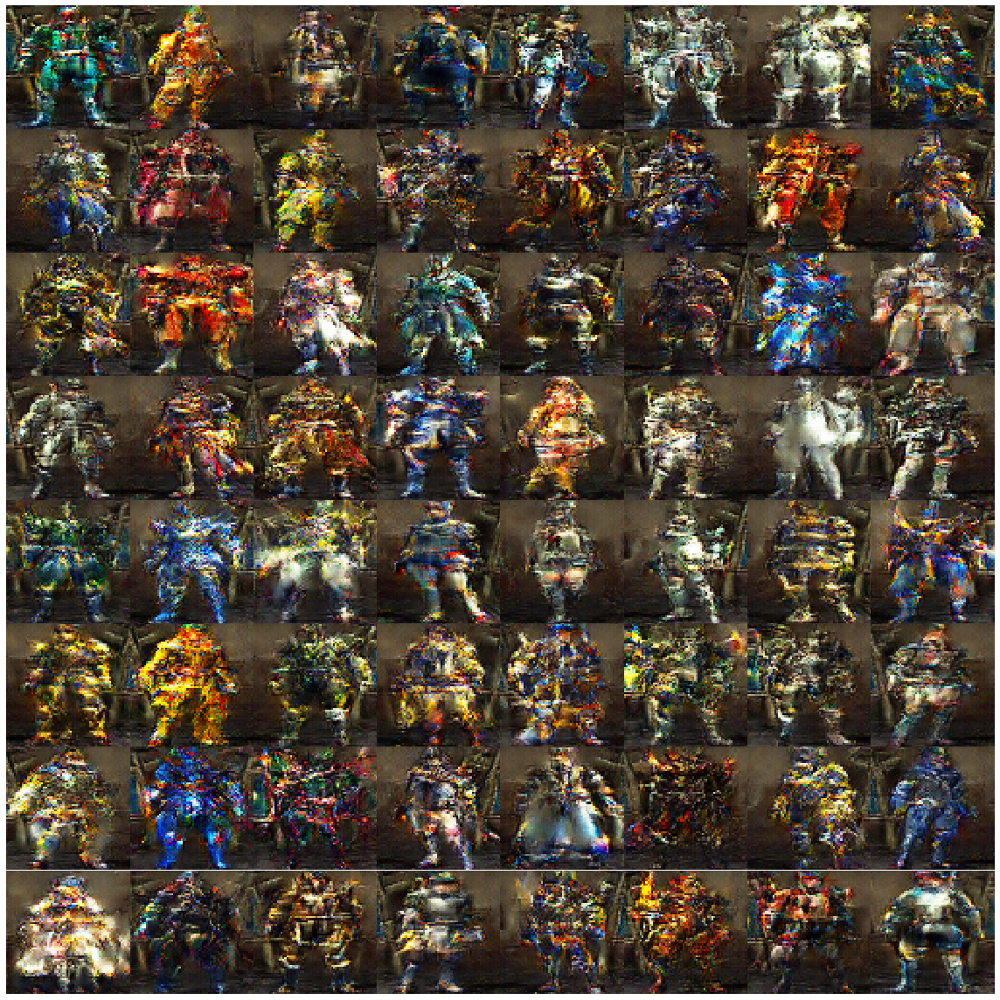

Disc: real loss: 0.343423 fake loss: 0.308289
GAN loss: 2.713429
Step 9500 completed. Time took: 8 secs.
Begin step:  9501
Disc: real loss: 0.387538 fake loss: 0.371125
GAN loss: 2.636074
Step 9501 completed. Time took: 3 secs.
Begin step:  9502
Disc: real loss: 0.358925 fake loss: 0.352771
GAN loss: 2.208529
Step 9502 completed. Time took: 3 secs.
Begin step:  9503
Disc: real loss: 0.343043 fake loss: 0.341035
GAN loss: 2.775684
Step 9503 completed. Time took: 3 secs.
Begin step:  9504
Disc: real loss: 0.349126 fake loss: 0.396876
GAN loss: 1.954037
Step 9504 completed. Time took: 3 secs.
Begin step:  9505
Disc: real loss: 0.367760 fake loss: 0.400842
GAN loss: 2.598609
Step 9505 completed. Time took: 3 secs.
Begin step:  9506
Disc: real loss: 0.333286 fake loss: 0.325731
GAN loss: 2.330381
Step 9506 completed. Time took: 3 secs.
Begin step:  9507
Disc: real loss: 0.357371 fake loss: 0.370600
GAN loss: 2.742059
Step 9507 completed. Time took: 3 secs.
Begin step:  9508
Disc: real loss:

Disc: real loss: 0.358187 fake loss: 0.356580
GAN loss: 2.050865
Step 9567 completed. Time took: 3 secs.
Begin step:  9568
Disc: real loss: 0.350920 fake loss: 0.357922
GAN loss: 2.248090
Step 9568 completed. Time took: 3 secs.
Begin step:  9569
Disc: real loss: 0.338490 fake loss: 0.453246
GAN loss: 3.549838
Step 9569 completed. Time took: 3 secs.
Begin step:  9570
Disc: real loss: 0.564281 fake loss: 0.391287
GAN loss: 2.045821
Step 9570 completed. Time took: 3 secs.
Begin step:  9571
Disc: real loss: 0.362898 fake loss: 0.401306
GAN loss: 3.044300
Step 9571 completed. Time took: 3 secs.
Begin step:  9572
Disc: real loss: 0.410735 fake loss: 0.556563
GAN loss: 4.374287
Step 9572 completed. Time took: 3 secs.
Begin step:  9573
Disc: real loss: 0.464216 fake loss: 0.445742
GAN loss: 1.911079
Step 9573 completed. Time took: 3 secs.
Begin step:  9574
Disc: real loss: 0.429704 fake loss: 0.397219
GAN loss: 3.021013
Step 9574 completed. Time took: 3 secs.
Begin step:  9575
Disc: real loss:

Disc: real loss: 0.354078 fake loss: 0.343956
GAN loss: 2.054875
Step 9634 completed. Time took: 3 secs.
Begin step:  9635
Disc: real loss: 0.322339 fake loss: 0.352199
GAN loss: 2.607336
Step 9635 completed. Time took: 3 secs.
Begin step:  9636
Disc: real loss: 0.337092 fake loss: 0.338986
GAN loss: 2.154927
Step 9636 completed. Time took: 3 secs.
Begin step:  9637
Disc: real loss: 0.334068 fake loss: 0.341032
GAN loss: 2.396556
Step 9637 completed. Time took: 3 secs.
Begin step:  9638
Disc: real loss: 0.358343 fake loss: 0.339762
GAN loss: 2.072587
Step 9638 completed. Time took: 3 secs.
Begin step:  9639
Disc: real loss: 0.363861 fake loss: 0.350480
GAN loss: 2.318476
Step 9639 completed. Time took: 3 secs.
Begin step:  9640
Disc: real loss: 0.348346 fake loss: 0.351118
GAN loss: 2.379449
Step 9640 completed. Time took: 3 secs.
Begin step:  9641
Disc: real loss: 0.339527 fake loss: 0.332264
GAN loss: 2.357269
Step 9641 completed. Time took: 3 secs.
Begin step:  9642
Disc: real loss:

Disc: real loss: 0.370540 fake loss: 0.372154
GAN loss: 2.334998
Step 9701 completed. Time took: 3 secs.
Begin step:  9702
Disc: real loss: 0.371153 fake loss: 0.379305
GAN loss: 2.291651
Step 9702 completed. Time took: 3 secs.
Begin step:  9703
Disc: real loss: 0.360104 fake loss: 0.320964
GAN loss: 2.480334
Step 9703 completed. Time took: 3 secs.
Begin step:  9704
Disc: real loss: 0.349558 fake loss: 0.347468
GAN loss: 2.318889
Step 9704 completed. Time took: 3 secs.
Begin step:  9705
Disc: real loss: 0.316265 fake loss: 0.366681
GAN loss: 2.171621
Step 9705 completed. Time took: 3 secs.
Begin step:  9706
Disc: real loss: 0.355681 fake loss: 0.347208
GAN loss: 2.542148
Step 9706 completed. Time took: 3 secs.
Begin step:  9707
Disc: real loss: 0.369761 fake loss: 0.373087
GAN loss: 1.987904
Step 9707 completed. Time took: 3 secs.
Begin step:  9708
Disc: real loss: 0.365063 fake loss: 0.383252
GAN loss: 2.791024
Step 9708 completed. Time took: 3 secs.
Begin step:  9709
Disc: real loss:

Disc: real loss: 0.330489 fake loss: 0.332698
GAN loss: 2.220859
Step 9768 completed. Time took: 4 secs.
Begin step:  9769
Disc: real loss: 0.315408 fake loss: 0.356901
GAN loss: 3.173553
Step 9769 completed. Time took: 4 secs.
Begin step:  9770
Disc: real loss: 0.367098 fake loss: 0.395382
GAN loss: 1.767181
Step 9770 completed. Time took: 3 secs.
Begin step:  9771
Disc: real loss: 0.361560 fake loss: 0.382985
GAN loss: 2.755327
Step 9771 completed. Time took: 3 secs.
Begin step:  9772
Disc: real loss: 0.339621 fake loss: 0.344332
GAN loss: 1.826657
Step 9772 completed. Time took: 3 secs.
Begin step:  9773
Disc: real loss: 0.367228 fake loss: 0.332759
GAN loss: 2.555202
Step 9773 completed. Time took: 3 secs.
Begin step:  9774
Disc: real loss: 0.332870 fake loss: 0.333529
GAN loss: 2.262803
Step 9774 completed. Time took: 3 secs.
Begin step:  9775
Disc: real loss: 0.345217 fake loss: 0.364119
GAN loss: 2.264611
Step 9775 completed. Time took: 3 secs.
Begin step:  9776
Disc: real loss:

Disc: real loss: 0.362650 fake loss: 0.396444
GAN loss: 2.957412
Step 9835 completed. Time took: 3 secs.
Begin step:  9836
Disc: real loss: 0.363648 fake loss: 0.397384
GAN loss: 1.999336
Step 9836 completed. Time took: 3 secs.
Begin step:  9837
Disc: real loss: 0.345148 fake loss: 0.383298
GAN loss: 2.656923
Step 9837 completed. Time took: 3 secs.
Begin step:  9838
Disc: real loss: 0.333398 fake loss: 0.335322
GAN loss: 2.177427
Step 9838 completed. Time took: 3 secs.
Begin step:  9839
Disc: real loss: 0.302736 fake loss: 0.365727
GAN loss: 1.998921
Step 9839 completed. Time took: 3 secs.
Begin step:  9840
Disc: real loss: 0.335405 fake loss: 0.333969
GAN loss: 2.513581
Step 9840 completed. Time took: 3 secs.
Begin step:  9841
Disc: real loss: 0.345184 fake loss: 0.367315
GAN loss: 1.956143
Step 9841 completed. Time took: 3 secs.
Begin step:  9842
Disc: real loss: 0.361735 fake loss: 0.355394
GAN loss: 2.981709
Step 9842 completed. Time took: 3 secs.
Begin step:  9843
Disc: real loss:

Disc: real loss: 0.326666 fake loss: 0.324582
GAN loss: 2.618068
Step 9902 completed. Time took: 3 secs.
Begin step:  9903
Disc: real loss: 0.359706 fake loss: 0.339110
GAN loss: 2.225180
Step 9903 completed. Time took: 3 secs.
Begin step:  9904
Disc: real loss: 0.364387 fake loss: 0.380865
GAN loss: 1.906457
Step 9904 completed. Time took: 3 secs.
Begin step:  9905
Disc: real loss: 0.327568 fake loss: 0.340290
GAN loss: 2.621228
Step 9905 completed. Time took: 3 secs.
Begin step:  9906
Disc: real loss: 0.333426 fake loss: 0.374638
GAN loss: 2.668909
Step 9906 completed. Time took: 3 secs.
Begin step:  9907
Disc: real loss: 0.404355 fake loss: 0.392484
GAN loss: 3.000481
Step 9907 completed. Time took: 3 secs.
Begin step:  9908
Disc: real loss: 0.346030 fake loss: 0.361752
GAN loss: 2.476642
Step 9908 completed. Time took: 3 secs.
Begin step:  9909
Disc: real loss: 0.378891 fake loss: 0.350845
GAN loss: 2.167450
Step 9909 completed. Time took: 3 secs.
Begin step:  9910
Disc: real loss:

Disc: real loss: 0.332990 fake loss: 0.333739
GAN loss: 2.721626
Step 9969 completed. Time took: 3 secs.
Begin step:  9970
Disc: real loss: 0.348725 fake loss: 0.368423
GAN loss: 1.852066
Step 9970 completed. Time took: 3 secs.
Begin step:  9971
Disc: real loss: 0.334616 fake loss: 0.378461
GAN loss: 3.515322
Step 9971 completed. Time took: 3 secs.
Begin step:  9972
Disc: real loss: 0.501470 fake loss: 0.446163
GAN loss: 2.951005
Step 9972 completed. Time took: 3 secs.
Begin step:  9973
Disc: real loss: 0.370746 fake loss: 0.416394
GAN loss: 2.412132
Step 9973 completed. Time took: 3 secs.
Begin step:  9974
Disc: real loss: 0.361283 fake loss: 0.390723
GAN loss: 2.151582
Step 9974 completed. Time took: 3 secs.
Begin step:  9975
Disc: real loss: 0.360066 fake loss: 0.373956
GAN loss: 2.932844
Step 9975 completed. Time took: 3 secs.
Begin step:  9976
Disc: real loss: 0.356673 fake loss: 0.384169
GAN loss: 1.835678
Step 9976 completed. Time took: 3 secs.
Begin step:  9977
Disc: real loss:

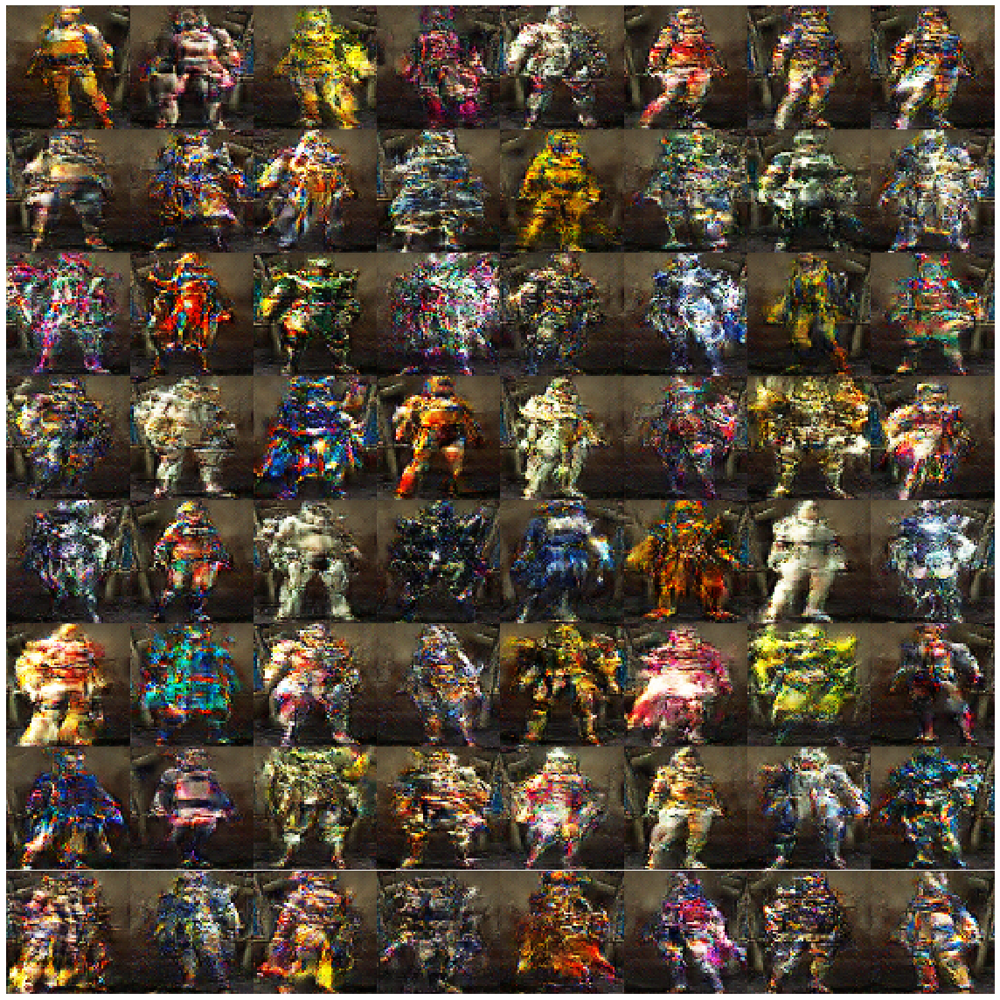

In [20]:
#Calling our Training function and outputting the variables to use for graph later 
avg_disc_fake_loss_complete, avg_disc_real_loss_complete, avg_GAN_loss_complete = train()

### Loss vs Steps 

In [64]:
disc_real_losspd = pd.DataFrame(avg_disc_real_loss_complete).reset_index()
disc_fake_losspd = pd.DataFrame(avg_disc_fake_loss_complete).reset_index()
GAN_losspd = pd.DataFrame(avg_GAN_loss_complete).reset_index()

In [71]:
import plotly.graph_objects as go
import pandas as pd

fig = go.Figure()
fig.add_trace(go.Scatter(x=GAN_losspd['index'], y=GAN_losspd[0], name="Generator Loss",
                         line_color='deepskyblue'))

fig.add_trace(go.Scatter(x=disc_real_losspd['index'], y=disc_real_losspd[0], name="Real Discriminator Loss",
                         line_color='green'))

fig.add_trace(go.Scatter(x=disc_fake_losspd['index'], y=disc_fake_losspd[0], name="Fake Discriminator Loss",
                         line_color='red'))

fig.update_layout(title_text='Losses vs Training steps',
                  xaxis_rangeslider_visible=True)
fig.show()

### Gif and MP4 created from png files during DCGANs training 

In [30]:
#generating gifs from png
import imageio

generated_images = [img_save_dir + str(x).zfill(4) + "_image.png" for x in range(0, num_steps,500)]

In [35]:
#saving as a gif
images = []
for filename in generated_images:
    images.append(imageio.imread(filename))

imageio.mimsave(img_save_dir+'movie.gif', images) 

In [1]:
# from IPython.display import Image
# with open("mhxx_armor/movie.gif",'rb') as f:
#     display(Image(data=f.read(), format='png'))

In [72]:
#saving as a mp4
import os
from moviepy.editor import *

clips = []

for filename in images:
    clips.append(ImageClip(filename).set_duration(0.5))
     
video = concatenate(clips, method="compose")
video.write_videofile('mhxx.mp4', fps=24)

t:   1%|          | 2/240 [00:00<00:15, 15.61it/s, now=None]

Moviepy - Building video mhxx.mp4.
Moviepy - Writing video mhxx.mp4




t:   8%|▊         | 200/2400 [28:24<02:39, 13.78it/s, now=None][A

Moviepy - Done !
Moviepy - video ready mhxx.mp4
